In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
import warnings
warnings.filterwarnings('ignore')
import plotly.graph_objects as go
import plotly.express as px


In [2]:
data = pd.read_csv("/kaggle/input/retail-analysis-large-dataset/new_retail_data.csv")

In [3]:
data.head(2)

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788.0,37249.0,Michelle Harrington,Ebony39@gmail.com,1.414787e+09,3959 Amanda Burgs,Dortmund,Berlin,77985.0,Germany,21.0,Male,Low,Regular,9/18/2023,2023.0,September,22:03:55,3.0,108.028757,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5.0,Cycling shorts
1,2174773.0,69749.0,Kelsey Hill,Mark36@gmail.com,6.852900e+09,82072 Dawn Centers,Nottingham,England,99071.0,UK,19.0,Female,Low,Premium,12/31/2023,2023.0,December,8:42:04,2.0,403.353907,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4.0,Lenovo Tab


In [4]:
data.describe()

,Transaction_ID,Customer_ID,Phone,Zipcode,Age,Year,Total_Purchases,Amount,Total_Amount,Ratings
count,3.016770e+05,301702.000000,3.016480e+05,301670.000000,301837.000000,301660.000000,301649.000000,301653.000000,301660.000000,301826.000000
mean,5.495823e+06,55006.553934,5.501464e+09,50298.951019,35.481326,2023.165113,5.359729,255.163659,1367.651156,3.162670
std,2.595565e+06,26005.675200,2.596017e+09,28972.807134,15.021933,0.371283,2.868575,141.389640,1128.998515,1.320827
min,1.000007e+06,10000.000000,1.000049e+09,501.000000,18.000000,2023.000000,1.000000,10.000219,10.003750,1.000000
25%,3.247930e+06,32469.250000,3.255061e+09,25425.000000,22.000000,2023.000000,3.000000,132.890764,438.724278,2.000000
50%,5.499657e+06,55012.000000,5.505812e+09,50602.500000,32.000000,2023.000000,5.000000,255.470969,1041.117547,3.000000
75%,7.739509e+06,77511.000000,7.749860e+09,75252.000000,46.000000,2023.000000,8.000000,377.672606,2029.999853,4.000000
max,9.999995e+06,99999.000000,9.999996e+09,99949.000000,70.000000,2024.000000,10.000000,499.997911,4999.625796,5.000000


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 302010 entries, 0 to 302009
Data columns (total 30 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Transaction_ID    301677 non-null  float64
 1   Customer_ID       301702 non-null  float64
 2   Name              301628 non-null  object 
 3   Email             301663 non-null  object 
 4   Phone             301648 non-null  float64
 5   Address           301695 non-null  object 
 6   City              301762 non-null  object 
 7   State             301729 non-null  object 
 8   Zipcode           301670 non-null  float64
 9   Country           301739 non-null  object 
 10  Age               301837 non-null  float64
 11  Gender            301693 non-null  object 
 12  Income            301720 non-null  object 
 13  Customer_Segment  301795 non-null  object 
 14  Date              301651 non-null  object 
 15  Year              301660 non-null  float64
 16  Month             30

In [6]:
data.isnull().sum()

Transaction_ID      333
Customer_ID         308
Name                382
Email               347
Phone               362
Address             315
City                248
State               281
Zipcode             340
Country             271
Age                 173
Gender              317
Income              290
Customer_Segment    215
Date                359
Year                350
Month               273
Time                350
Total_Purchases     361
Amount              357
Total_Amount        350
Product_Category    283
Product_Brand       281
Product_Type          0
Feedback            184
Shipping_Method     337
Payment_Method      297
Order_Status        235
Ratings             184
products              0
dtype: int64

In [7]:
for col in ['Transaction_ID', 'Customer_ID', 'Phone','Zipcode' ,'Age','Year' ,'Ratings']:
    if data[col].isna().any():
        # Calculating the mean of the column (ignoring NaN values)
        col_mean = data[col].mean(skipna=True)

        # Filling NaN values with the mean
        data[col].fillna(col_mean, inplace=True)

    # Converting the column to integer dtype
    data[col] = data[col].astype(int)

print(data.isnull().sum())


Transaction_ID        0
Customer_ID           0
Name                382
Email               347
Phone                 0
Address             315
City                248
State               281
Zipcode               0
Country             271
Age                   0
Gender              317
Income              290
Customer_Segment    215
Date                359
Year                  0
Month               273
Time                350
Total_Purchases     361
Amount              357
Total_Amount        350
Product_Category    283
Product_Brand       281
Product_Type          0
Feedback            184
Shipping_Method     337
Payment_Method      297
Order_Status        235
Ratings               0
products              0
dtype: int64


In [8]:
data['Date'] = pd.to_datetime(data['Date']).dt.strftime('%Y-%m-%d')
data['Time'] = pd.to_datetime(data['Time']).dt.strftime('%H:%M:%S')

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 302010 entries, 0 to 302009
Data columns (total 30 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Transaction_ID    302010 non-null  int64  
 1   Customer_ID       302010 non-null  int64  
 2   Name              301628 non-null  object 
 3   Email             301663 non-null  object 
 4   Phone             302010 non-null  int64  
 5   Address           301695 non-null  object 
 6   City              301762 non-null  object 
 7   State             301729 non-null  object 
 8   Zipcode           302010 non-null  int64  
 9   Country           301739 non-null  object 
 10  Age               302010 non-null  int64  
 11  Gender            301693 non-null  object 
 12  Income            301720 non-null  object 
 13  Customer_Segment  301795 non-null  object 
 14  Date              301651 non-null  object 
 15  Year              302010 non-null  int64  
 16  Month             30

In [10]:
data.duplicated().sum()

4

In [11]:
data.drop_duplicates(inplace=True)

In [12]:
data.duplicated().sum()

0

In [13]:
data.shape

(302006, 30)

In [14]:
data.isnull().sum()

Transaction_ID        0
Customer_ID           0
Name                382
Email               347
Phone                 0
Address             315
City                248
State               281
Zipcode               0
Country             271
Age                   0
Gender              317
Income              290
Customer_Segment    215
Date                359
Year                  0
Month               273
Time                350
Total_Purchases     361
Amount              356
Total_Amount        350
Product_Category    283
Product_Brand       281
Product_Type          0
Feedback            184
Shipping_Method     337
Payment_Method      297
Order_Status        235
Ratings               0
products              0
dtype: int64

In [15]:
# Filter rows where any of the specified columns have value 0 or negative
filtered_data = data[(data['Total_Purchases'] <= 0) | (data['Amount'] <= 0) | (data['Total_Amount'] <= 0)]

print(filtered_data)


Empty DataFrame
Columns: [Transaction_ID, Customer_ID, Name, Email, Phone, Address, City, State, Zipcode, Country, Age, Gender, Income, Customer_Segment, Date, Year, Month, Time, Total_Purchases, Amount, Total_Amount, Product_Category, Product_Brand, Product_Type, Feedback, Shipping_Method, Payment_Method, Order_Status, Ratings, products]
Index: []


In [16]:
data.head(3)

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788,37249,Michelle Harrington,Ebony39@gmail.com,1414786801,3959 Amanda Burgs,Dortmund,Berlin,77985,Germany,21,Male,Low,Regular,2023-09-18,2023,September,22:03:55,3.0,108.028757,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5,Cycling shorts
1,2174773,69749,Kelsey Hill,Mark36@gmail.com,6852899987,82072 Dawn Centers,Nottingham,England,99071,UK,19,Female,Low,Premium,2023-12-31,2023,December,08:42:04,2.0,403.353907,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4,Lenovo Tab
2,6679610,30192,Scott Jensen,Shane85@gmail.com,8362160449,4133 Young Canyon,Geelong,New South Wales,75929,Australia,48,Male,Low,Regular,2023-04-26,2023,April,04:06:29,3.0,354.477600,1063.432799,Books,Penguin Books,Children's,Average,Same-Day,Credit Card,Processing,2,Sports equipment


In [17]:
data['Total_Purchases'] = data['Total_Purchases'].interpolate(direction='both')
data['Amount'] = data['Amount'].interpolate(direction='both')

data['Total_Amount'] = data['Total_Purchases'] * data['Amount']

In [18]:
data.isnull().sum()

Transaction_ID        0
Customer_ID           0
Name                382
Email               347
Phone                 0
Address             315
City                248
State               281
Zipcode               0
Country             271
Age                   0
Gender              317
Income              290
Customer_Segment    215
Date                359
Year                  0
Month               273
Time                350
Total_Purchases       0
Amount                0
Total_Amount          0
Product_Category    283
Product_Brand       281
Product_Type          0
Feedback            184
Shipping_Method     337
Payment_Method      297
Order_Status        235
Ratings               0
products              0
dtype: int64

In [19]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 302006 entries, 0 to 302009
Data columns (total 30 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Transaction_ID    302006 non-null  int64  
 1   Customer_ID       302006 non-null  int64  
 2   Name              301624 non-null  object 
 3   Email             301659 non-null  object 
 4   Phone             302006 non-null  int64  
 5   Address           301691 non-null  object 
 6   City              301758 non-null  object 
 7   State             301725 non-null  object 
 8   Zipcode           302006 non-null  int64  
 9   Country           301735 non-null  object 
 10  Age               302006 non-null  int64  
 11  Gender            301689 non-null  object 
 12  Income            301716 non-null  object 
 13  Customer_Segment  301791 non-null  object 
 14  Date              301647 non-null  object 
 15  Year              302006 non-null  int64  
 16  Month             301733 

In [20]:
# Fill null values in categorical columns with mode                                      #same in Categorical col of you have more time some values then it was getting mode from it ...
categorical_cols = data.select_dtypes(include=['object']).columns                          # like : red,blue,gree,red  : then mode id red it was fill in : NAN values ......
data[categorical_cols] = data[categorical_cols].fillna(data[categorical_cols].mode().iloc[0])

cat_columns = data.select_dtypes(include=['object']).columns
for col in cat_columns:
    data[col].fillna(data[col].mode()[0], inplace=True)

In [21]:
data.isnull().sum()

Transaction_ID      0
Customer_ID         0
Name                0
Email               0
Phone               0
Address             0
City                0
State               0
Zipcode             0
Country             0
Age                 0
Gender              0
Income              0
Customer_Segment    0
Date                0
Year                0
Month               0
Time                0
Total_Purchases     0
Amount              0
Total_Amount        0
Product_Category    0
Product_Brand       0
Product_Type        0
Feedback            0
Shipping_Method     0
Payment_Method      0
Order_Status        0
Ratings             0
products            0
dtype: int64

In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 302006 entries, 0 to 302009
Data columns (total 30 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Transaction_ID    302006 non-null  int64  
 1   Customer_ID       302006 non-null  int64  
 2   Name              302006 non-null  object 
 3   Email             302006 non-null  object 
 4   Phone             302006 non-null  int64  
 5   Address           302006 non-null  object 
 6   City              302006 non-null  object 
 7   State             302006 non-null  object 
 8   Zipcode           302006 non-null  int64  
 9   Country           302006 non-null  object 
 10  Age               302006 non-null  int64  
 11  Gender            302006 non-null  object 
 12  Income            302006 non-null  object 
 13  Customer_Segment  302006 non-null  object 
 14  Date              302006 non-null  object 
 15  Year              302006 non-null  int64  
 16  Month             302006 

In [23]:
num_columns = data.select_dtypes(include=['int64','float64']).columns
cat_cols = data.select_dtypes(include=['object']).columns
print(num_columns)
print(cat_cols)

Index(['Transaction_ID', 'Customer_ID', 'Phone', 'Zipcode', 'Age', 'Year',
       'Total_Purchases', 'Amount', 'Total_Amount', 'Ratings'],
      dtype='object')
Index(['Name', 'Email', 'Address', 'City', 'State', 'Country', 'Gender',
       'Income', 'Customer_Segment', 'Date', 'Month', 'Time',
       'Product_Category', 'Product_Brand', 'Product_Type', 'Feedback',
       'Shipping_Method', 'Payment_Method', 'Order_Status', 'products'],
      dtype='object')


In [24]:
data.head(3)

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products
0,8691788,37249,Michelle Harrington,Ebony39@gmail.com,1414786801,3959 Amanda Burgs,Dortmund,Berlin,77985,Germany,21,Male,Low,Regular,2023-09-18,2023,September,22:03:55,3.0,108.028757,324.086270,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5,Cycling shorts
1,2174773,69749,Kelsey Hill,Mark36@gmail.com,6852899987,82072 Dawn Centers,Nottingham,England,99071,UK,19,Female,Low,Premium,2023-12-31,2023,December,08:42:04,2.0,403.353907,806.707815,Electronics,Samsung,Tablet,Excellent,Standard,Credit Card,Processing,4,Lenovo Tab
2,6679610,30192,Scott Jensen,Shane85@gmail.com,8362160449,4133 Young Canyon,Geelong,New South Wales,75929,Australia,48,Male,Low,Regular,2023-04-26,2023,April,04:06:29,3.0,354.477600,1063.432799,Books,Penguin Books,Children's,Average,Same-Day,Credit Card,Processing,2,Sports equipment


In [25]:
data.Total_Amount.sum()

413051165.2368566

In [26]:
data_ver = data.Amount * data.Total_Purchases
data_ver.sum()

413051165.2368566

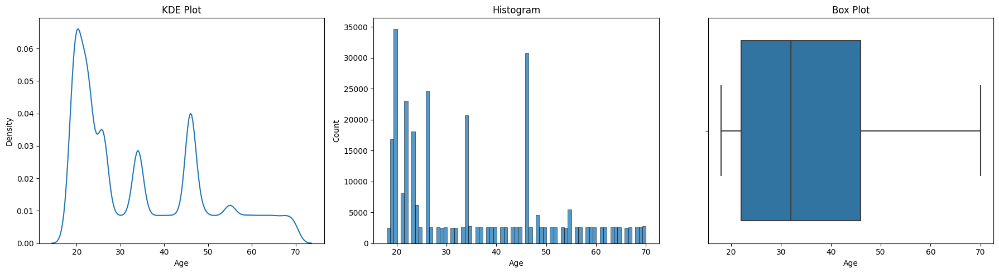

skewness is: 0.6527819799329551


In [27]:
import seaborn as sns
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# KDE plot
sns.kdeplot(data=data, x='Age', ax=axes[0])
axes[0].set_title('KDE Plot')

# Violin plot
sns.histplot(data=data, x='Age', ax=axes[1])
axes[1].set_title('Histogram')

# Box plot
sns.boxplot(data=data, x='Age', ax=axes[2])
axes[2].set_title('Box Plot')

plt.tight_layout()
plt.show()

print("skewness is:", data.Age.skew())

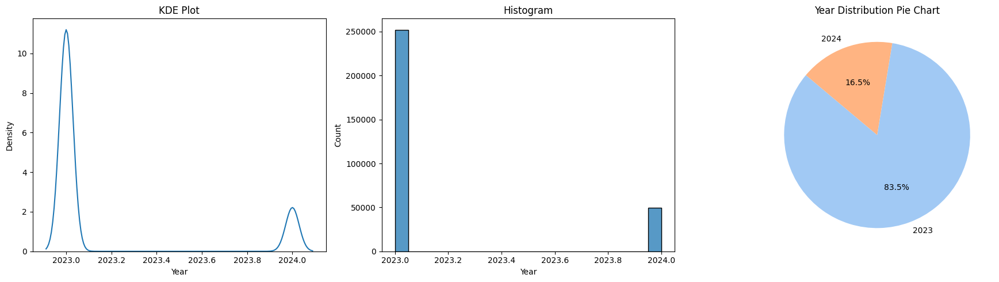

In [28]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# KDE plot
sns.kdeplot(data=data, x='Year', ax=axes[0])
axes[0].set_title('KDE Plot')


sns.histplot(data=data, x='Year', ax=axes[1])
axes[1].set_title('Histogram')


axes[2].pie(data.Year.value_counts(), labels=data.Year.value_counts().index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[2].set_title('Year Distribution Pie Chart')

plt.tight_layout()
plt.show()



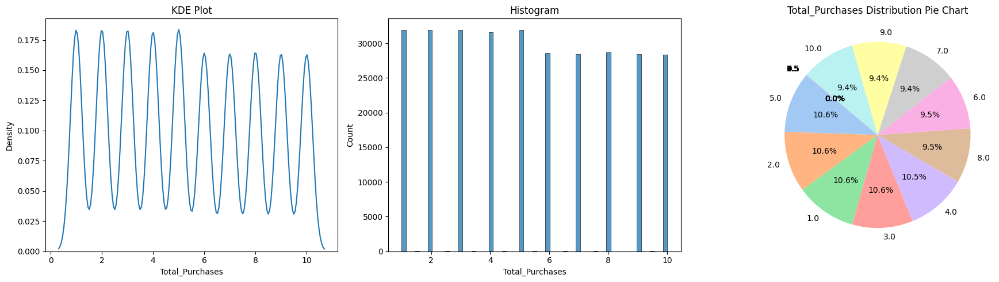

In [29]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# KDE plot
sns.kdeplot(data=data, x='Total_Purchases', ax=axes[0])
axes[0].set_title('KDE Plot')


sns.histplot(data=data, x='Total_Purchases', ax=axes[1])
axes[1].set_title('Histogram')


axes[2].pie(data.Total_Purchases.value_counts(), labels=data.Total_Purchases.value_counts().index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[2].set_title('Total_Purchases Distribution Pie Chart')

plt.tight_layout()
plt.show()


In [30]:
print(data.Total_Amount.sum())
print(data.Amount.sum())

413051165.2368566
77060704.8097275


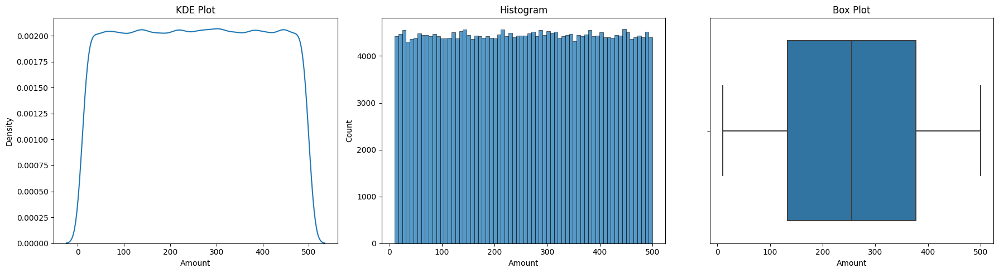

skewness is: -0.002213069572983015


In [31]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# KDE plot
sns.kdeplot(data=data, x='Amount', ax=axes[0])
axes[0].set_title('KDE Plot')

# Violin plot
sns.histplot(data=data, x='Amount', ax=axes[1])
axes[1].set_title('Histogram')

# Box plot
sns.boxplot(data=data, x='Amount', ax=axes[2])
axes[2].set_title('Box Plot')

plt.tight_layout()
plt.show()

print("skewness is:", data.Amount.skew())

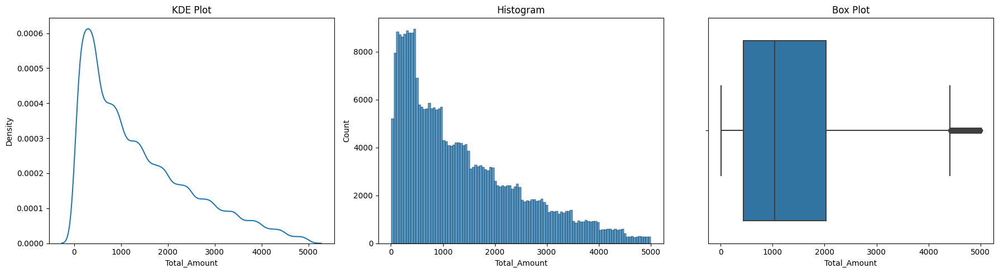

skewness is: 0.9726371857490068


In [32]:
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# KDE plot
sns.kdeplot(data=data, x='Total_Amount', ax=axes[0])
axes[0].set_title('KDE Plot')

# Violin plot
sns.histplot(data=data, x='Total_Amount', ax=axes[1])
axes[1].set_title('Histogram')

# Box plot
sns.boxplot(data=data, x='Total_Amount', ax=axes[2])
axes[2].set_title('Box Plot')

plt.tight_layout()
plt.show()

print("skewness is:", data.Total_Amount.skew())

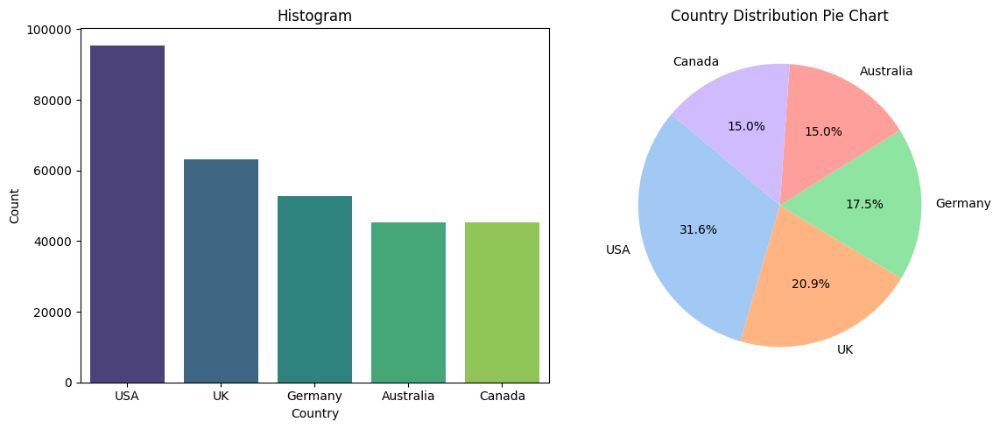

In [33]:
value_counts = data['Country'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Country')
axes[0].set_ylabel('Count')

# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Country Distribution Pie Chart')

plt.tight_layout()
plt.show()



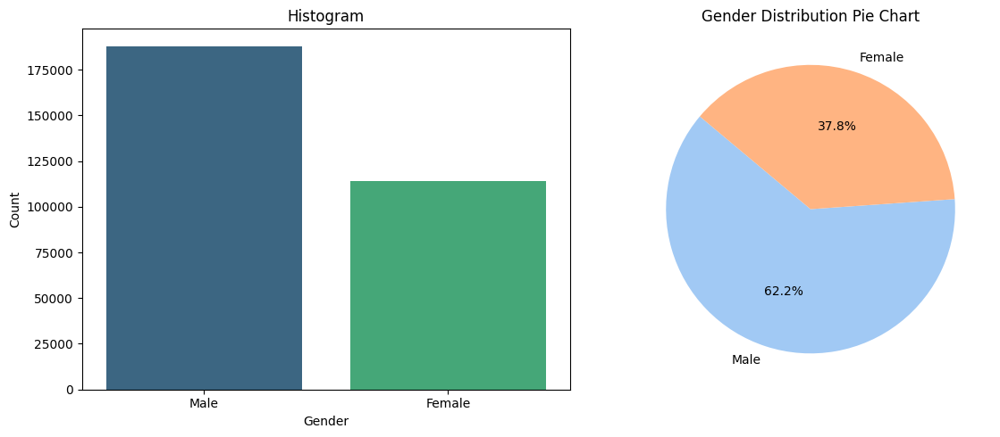

In [34]:
value_counts = data['Gender'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Gender')
axes[0].set_ylabel('Count')

# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Gender Distribution Pie Chart')

plt.tight_layout()
plt.show()


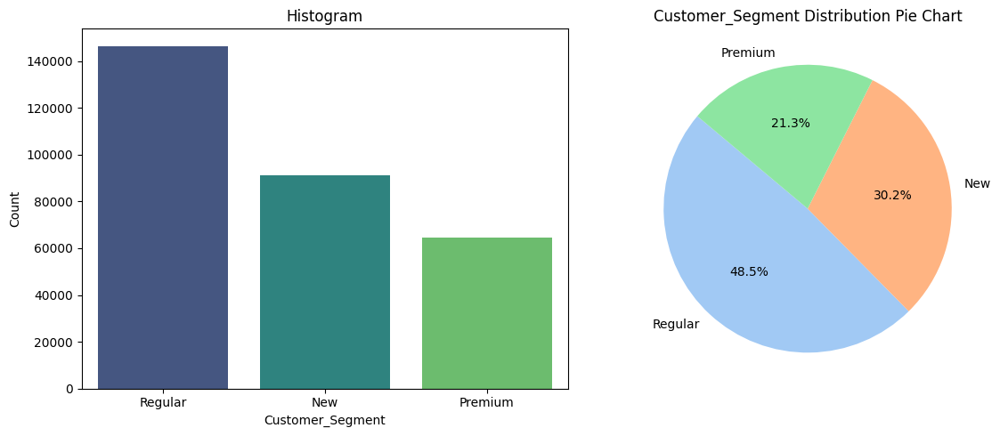

In [35]:
value_counts = data['Customer_Segment'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Customer_Segment')
axes[0].set_ylabel('Count')

# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Customer_Segment Distribution Pie Chart')

plt.tight_layout()
plt.show()

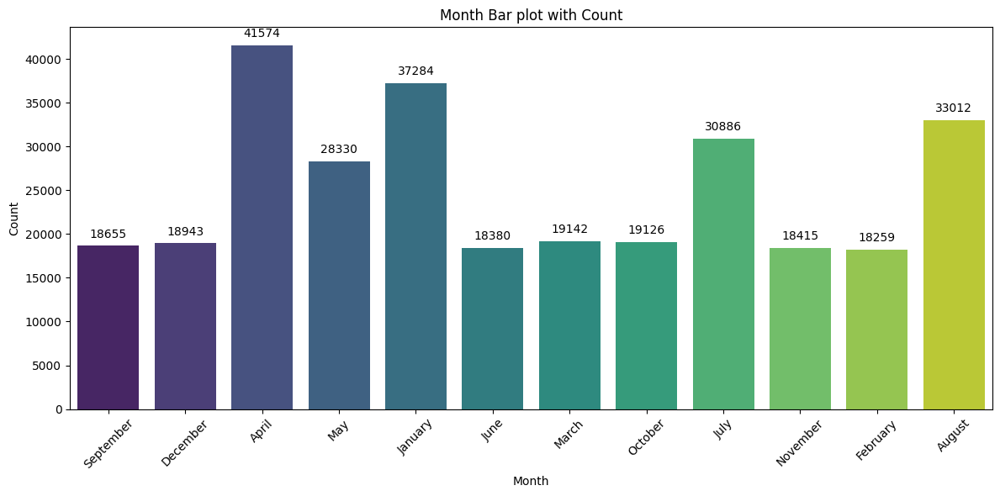

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt


# Plotting with Seaborn countplot
plt.figure(figsize=(12, 6))
sns.countplot(x='Month', data=data, palette='viridis')

# Adding annotations (count labels) to each bar
for p in plt.gca().patches:
    plt.gca().annotate(format(p.get_height(), '.0f'), 
                       (p.get_x() + p.get_width() / 2., p.get_height()), 
                       ha = 'center', va = 'center', 
                       xytext = (0, 10), 
                       textcoords = 'offset points')

plt.title('Month Bar plot with Count')
plt.xlabel('Month')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


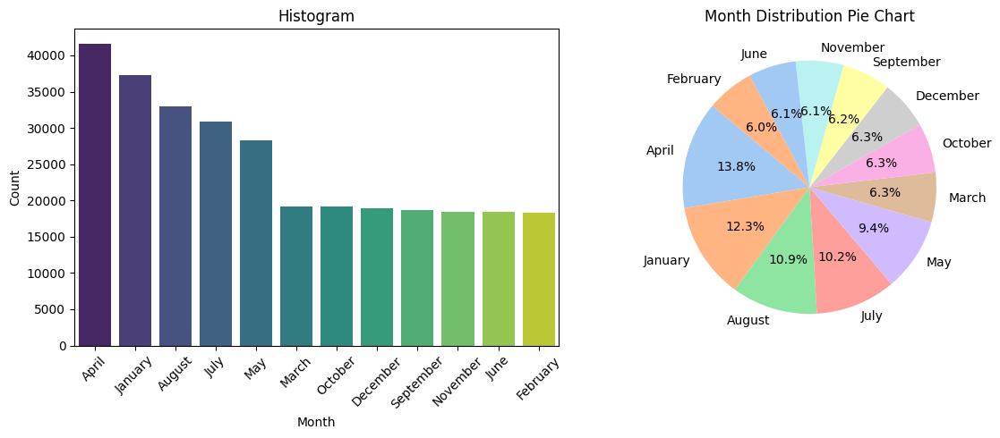

In [37]:

value_counts = data['Month'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Month')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45)  # Rotate x-axis ticks

# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Month Distribution Pie Chart')

plt.tight_layout()
plt.show()


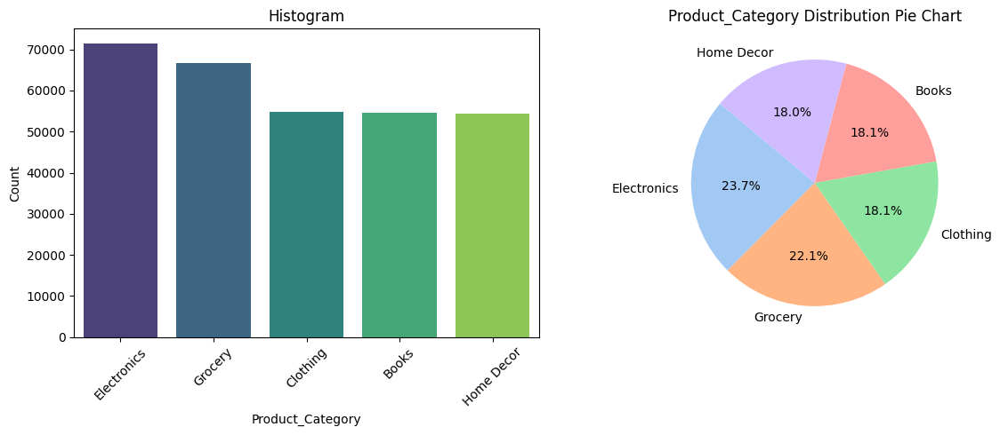

In [38]:

value_counts = data['Product_Category'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Product_Category')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45)  # Rotate x-axis ticks

# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Product_Category Distribution Pie Chart')

plt.tight_layout()
plt.show()


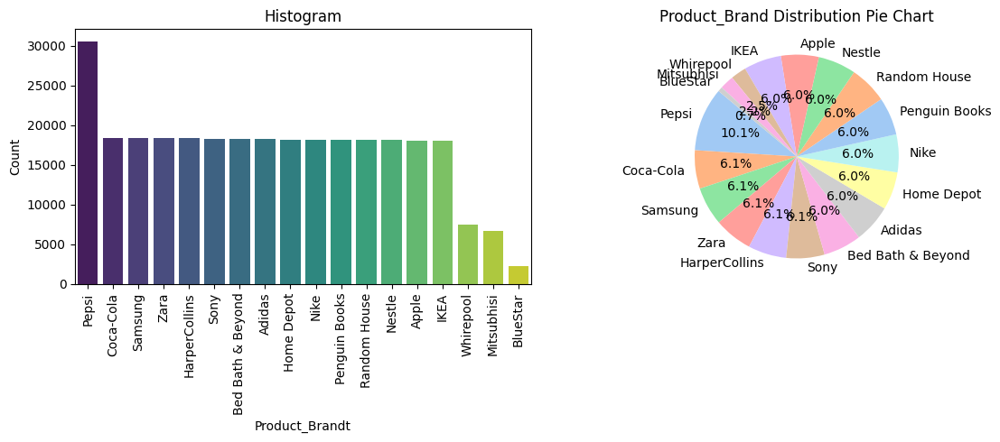

In [39]:
value_counts = data['Product_Brand'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Product_Brandt')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=90)  # Rotate x-axis tick labels for better readability
# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Product_Brand Distribution Pie Chart')

plt.tight_layout()
plt.show()

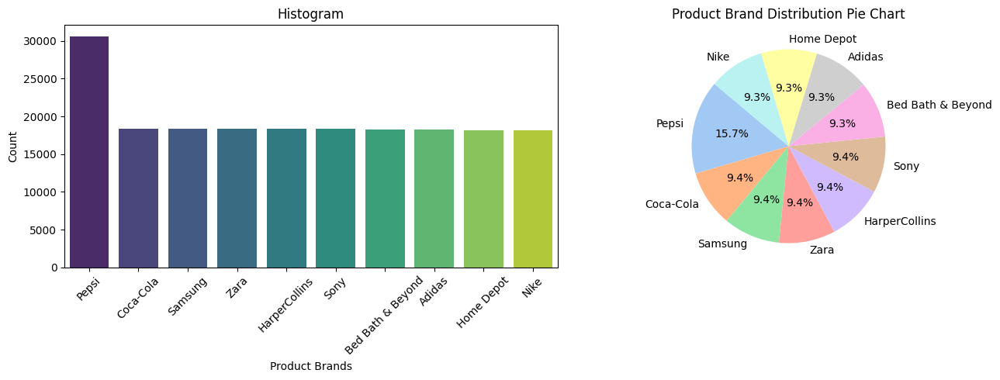

In [40]:

value_counts = data['Product_Brand'].value_counts()

# Limiting the number of brands for better visualization (adjust as needed)
top_n = 10  # Show top 10 brands
value_counts = value_counts.head(top_n)

fig, axes = plt.subplots(1, 2, figsize=(14, 5))  # Adjusted figure size

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Product Brands')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45)  # Rotate x-axis tick labels for better readability

# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Product Brand Distribution Pie Chart')

plt.tight_layout()
plt.show()


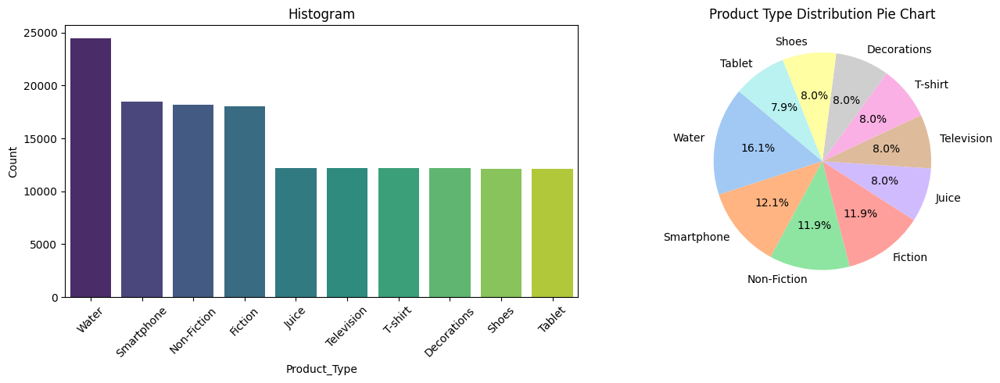

In [41]:

value_counts = data['Product_Type'].value_counts()

# Limiting the number of brands for better visualization (adjust as needed)
top_n = 10  # Show top 10 brands
value_counts = value_counts.head(top_n)

fig, axes = plt.subplots(1, 2, figsize=(14, 5))  # Adjusted figure size

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Product_Type')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45)  # Rotate x-axis tick labels for better readability

# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Product Type Distribution Pie Chart')

# Display the plots
plt.tight_layout()
plt.show()


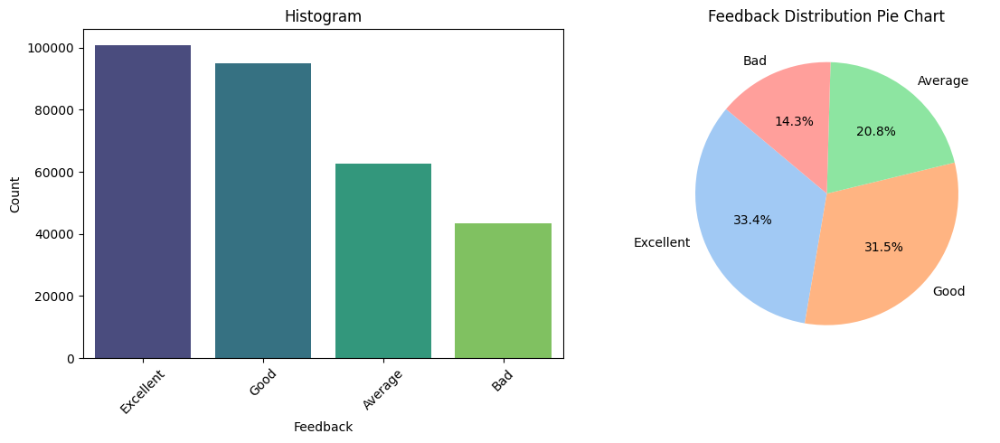

In [42]:
value_counts = data['Feedback'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Feedback')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45)  # Rotate x-axis tick labels for better readability
# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Feedback Distribution Pie Chart')

plt.tight_layout()
plt.show()

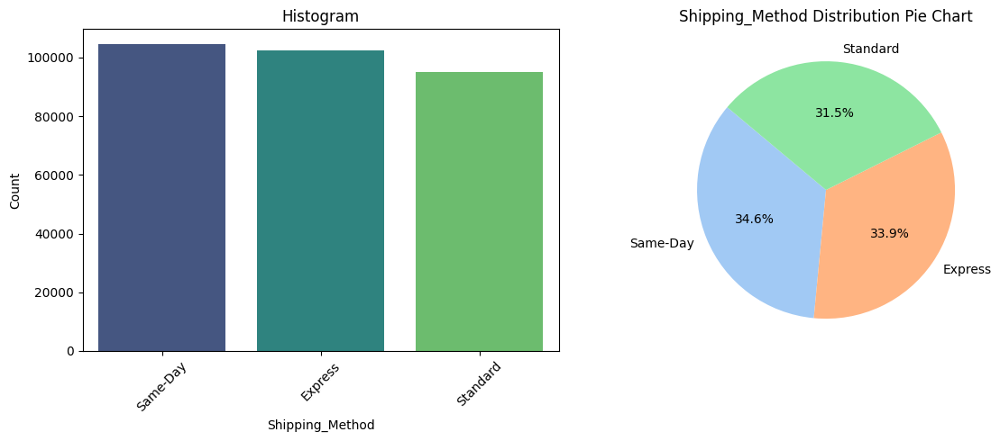

In [43]:
value_counts = data['Shipping_Method'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Shipping_Method')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45)  # Rotate x-axis tick labels for better readability
# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Shipping_Method Distribution Pie Chart')

plt.tight_layout()
plt.show()

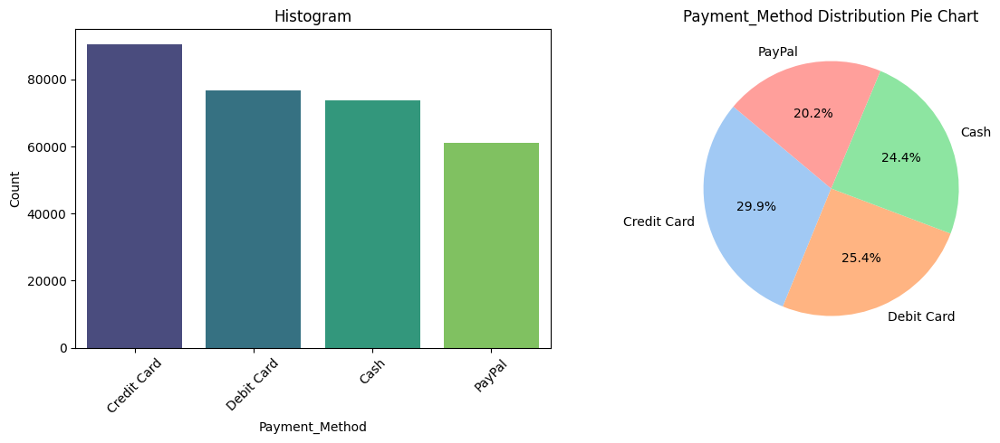

In [44]:
value_counts = data['Payment_Method'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Payment_Method')
axes[0].set_ylabel('Count')
axes[0].tick_params(axis='x', rotation=45)  # Rotate x-axis tick labels for better readability
# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Payment_Method Distribution Pie Chart')

plt.tight_layout()
plt.show()

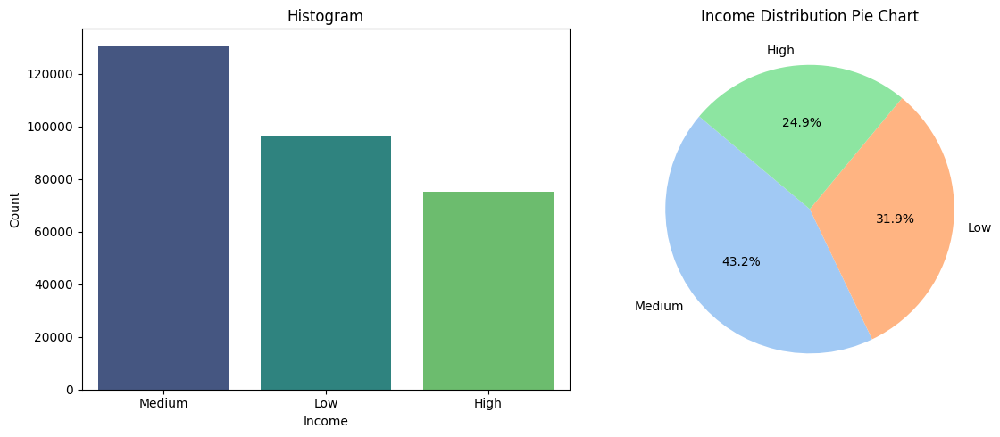

In [45]:
value_counts = data['Income'].value_counts()

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Histogram (using barplot to order by counts)
sns.barplot(x=value_counts.index, y=value_counts.values, ax=axes[0], palette='viridis')
axes[0].set_title('Histogram')
axes[0].set_xlabel('Income')
axes[0].set_ylabel('Count')

# Pie Chart
axes[1].pie(value_counts, labels=value_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("pastel"))
axes[1].set_title('Income Distribution Pie Chart')

plt.tight_layout()
plt.show()


In [46]:
import plotly.express as px
import pandas as pd

data

State = data['State'].value_counts().reset_index().head(15)
State.columns = ['State', 'Frequency']

fig = px.bar(State, x='State', y='Frequency', title='Bar Plot of Country',
             hover_data={'State': True, 'Frequency': True},
             labels={'State': 'State', 'Frequency': 'Frequency'},
             color='Frequency', 
             color_continuous_scale=px.colors.sequential.Viridis)

fig.update_layout(
    title_text='Bar Plot of Country',
    title_x=0.5,
    xaxis_title='State',
    yaxis_title='Frequency',
    template='plotly_white',
    hovermode='closest'
)

fig.show()


## ****Bivariate Analysis****

***Numerical vs Numerical***

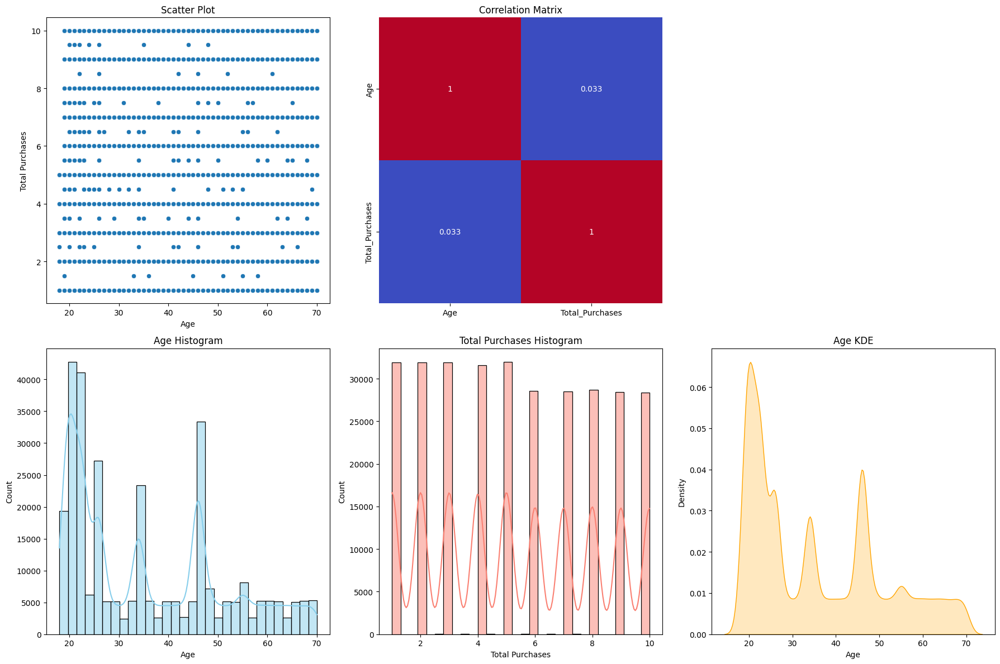

In [47]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Scatter Plot (Age vs Total Purchases)
sns.scatterplot(x='Age', y='Total_Purchases', data=data, ax=axes[0, 0])
axes[0, 0].set_title('Scatter Plot')
axes[0, 0].set_xlabel('Age')
axes[0, 0].set_ylabel('Total Purchases')

# Correlation Matrix
corr = data[['Age', 'Total_Purchases']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', ax=axes[0, 1], cbar=False)
axes[0, 1].set_title('Correlation Matrix')

# Histogram for Age
sns.histplot(data=data, x='Age', kde=True, ax=axes[1, 0], color='skyblue', bins=30)
axes[1, 0].set_title('Age Histogram')
axes[1, 0].set_xlabel('Age')

# Histogram for Total Purchases
sns.histplot(data=data, x='Total_Purchases', kde=True, ax=axes[1, 1], color='salmon', bins=30)
axes[1, 1].set_title('Total Purchases Histogram')
axes[1, 1].set_xlabel('Total Purchases')

# Kernel Density Estimation Plot for Age
sns.kdeplot(data=data, x='Age', ax=axes[1, 2], shade=True, color='orange')
axes[1, 2].set_title('Age KDE')
axes[1, 2].set_xlabel('Age')

fig.delaxes(axes[0, 2])

plt.tight_layout()
plt.show()


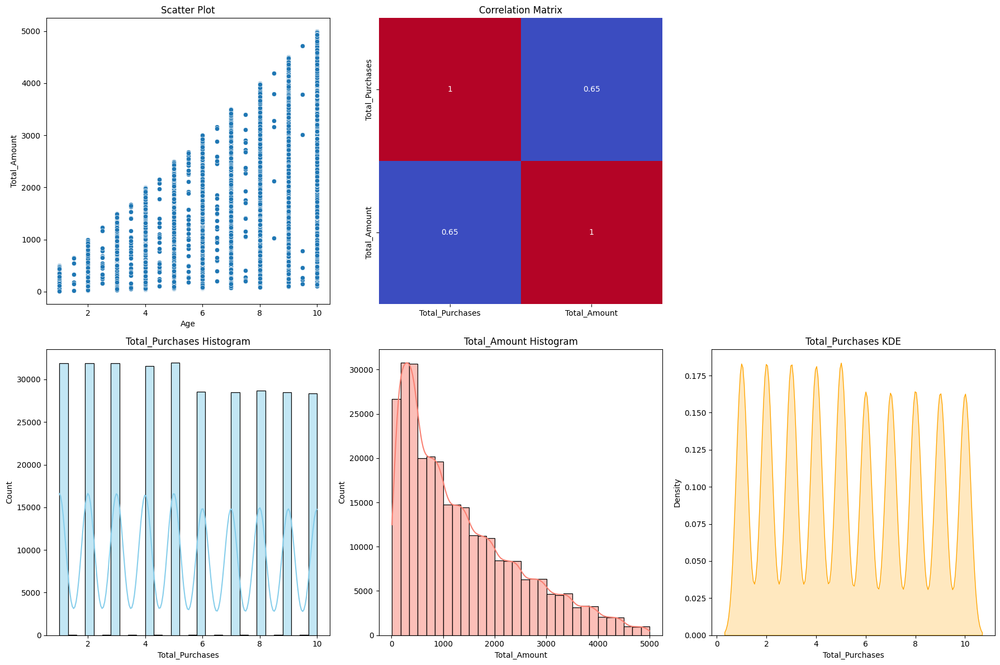

In [48]:
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Scatter Plot (Age vs Total Purchases)
sns.scatterplot(x='Total_Purchases', y='Total_Amount', data=data, ax=axes[0, 0])
axes[0, 0].set_title('Scatter Plot')
axes[0, 0].set_xlabel('Age')
axes[0, 0].set_ylabel('Total_Amount')

# Correlation Matrix
corr = data[['Total_Purchases', 'Total_Amount']].corr()
sns.heatmap(corr, annot=True, cmap='coolwarm', ax=axes[0, 1], cbar=False)
axes[0, 1].set_title('Correlation Matrix')

# Histogram for Age
sns.histplot(data=data, x='Total_Purchases', kde=True, ax=axes[1, 0], color='skyblue', bins=30)
axes[1, 0].set_title('Total_Purchases Histogram')
axes[1, 0].set_xlabel('Total_Purchases')

# Histogram for Total Purchases
sns.histplot(data=data, x='Total_Amount', kde=True, ax=axes[1, 1], color='salmon', bins=30)
axes[1, 1].set_title('Total_Amount Histogram')
axes[1, 1].set_xlabel('Total_Amount')

# Kernel Density Estimation Plot for Age
sns.kdeplot(data=data, x='Total_Purchases', ax=axes[1, 2], shade=True, color='orange')
axes[1, 2].set_title('Total_Purchases KDE')
axes[1, 2].set_xlabel('Total_Purchases')

fig.delaxes(axes[0, 2])

plt.tight_layout()
plt.show()


In [49]:
print(cat_cols)

Index(['Name', 'Email', 'Address', 'City', 'State', 'Country', 'Gender',
       'Income', 'Customer_Segment', 'Date', 'Month', 'Time',
       'Product_Category', 'Product_Brand', 'Product_Type', 'Feedback',
       'Shipping_Method', 'Payment_Method', 'Order_Status', 'products'],
      dtype='object')


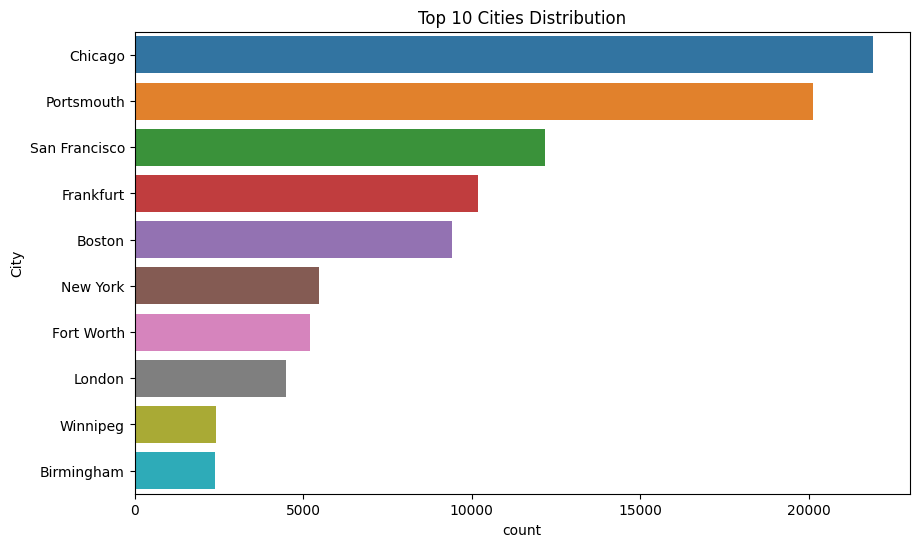

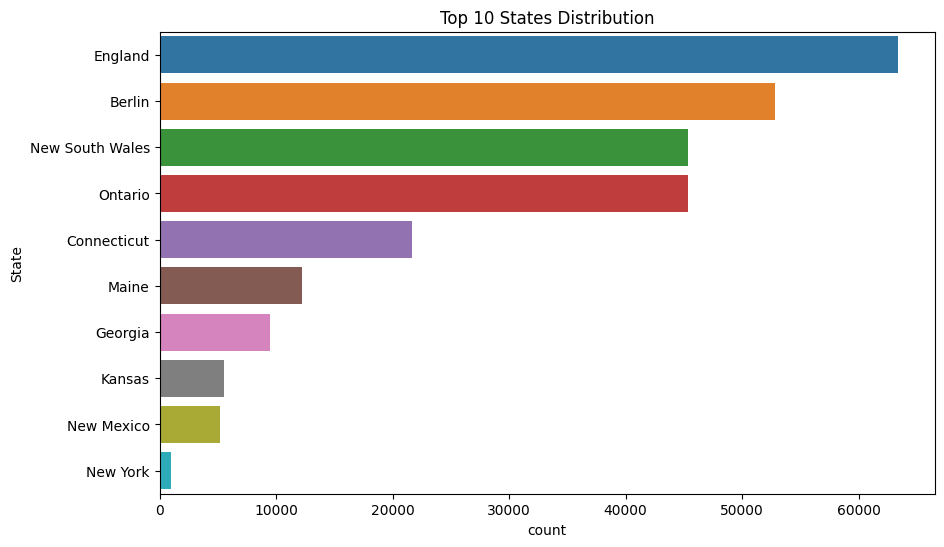

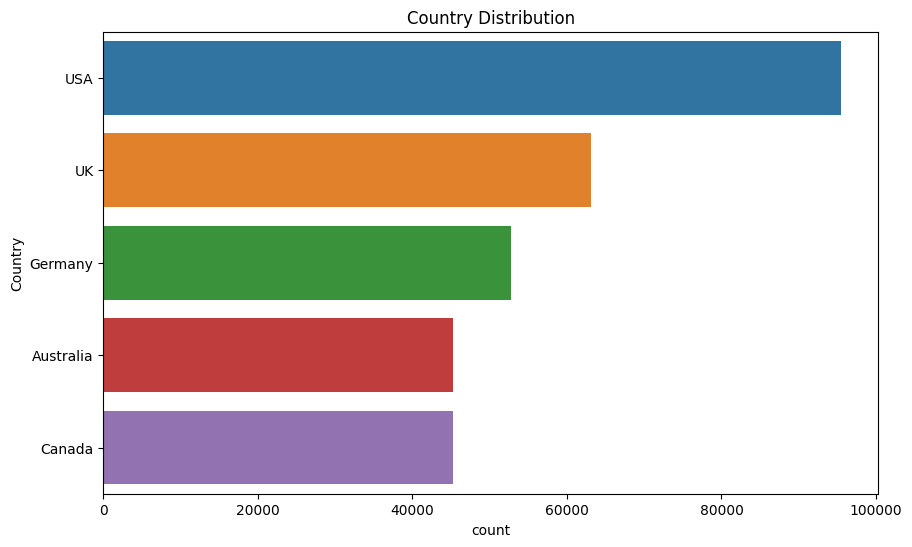

In [50]:
import matplotlib.pyplot as plt
import seaborn as sns

top_cities = data['City'].value_counts().head(10).index
plt.figure(figsize=(10, 6))
sns.countplot(y='City', data=data[data['City'].isin(top_cities)], order=top_cities)
plt.title('Top 10 Cities Distribution')
plt.show()

top_states = data['State'].value_counts().head(10).index
plt.figure(figsize=(10, 6))
sns.countplot(y='State', data=data[data['State'].isin(top_states)], order=top_states)
plt.title('Top 10 States Distribution')
plt.show()

plt.figure(figsize=(10, 6))
sns.countplot(y='Country', data=data, order=data['Country'].value_counts().index)
plt.title('Country Distribution')
plt.show()


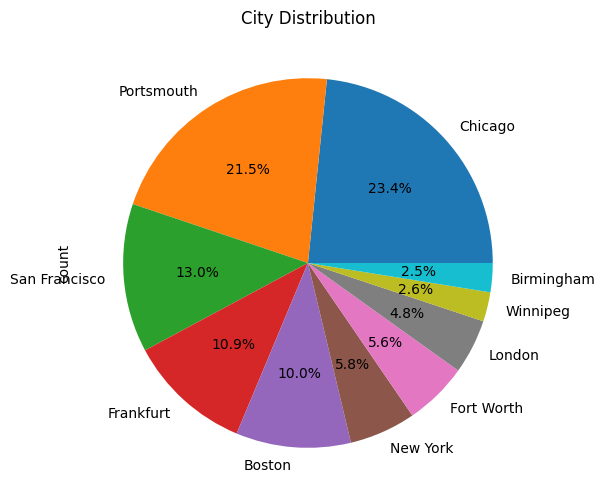

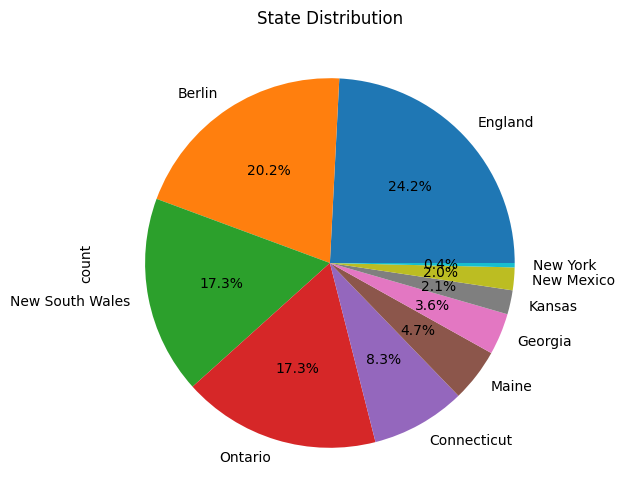

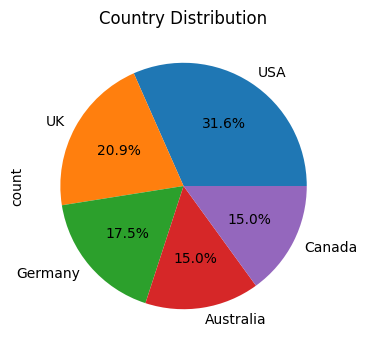

In [51]:
city_counts = data['City'].value_counts()
state_counts = data['State'].value_counts()
country_counts = data['Country'].value_counts()


city_counts.head(10).plot.pie(autopct='%1.1f%%', figsize=(6, 6), title='City Distribution')
plt.show()

state_counts.head(10).plot.pie(autopct='%1.1f%%', figsize=(6, 6), title='State Distribution')
plt.show()

country_counts.plot.pie(autopct='%1.1f%%', figsize=(4, 4), title='Country Distribution')
plt.show()

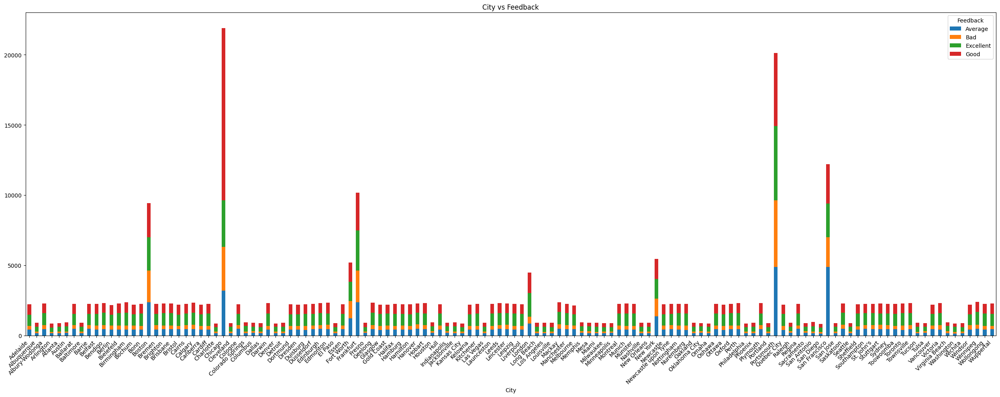

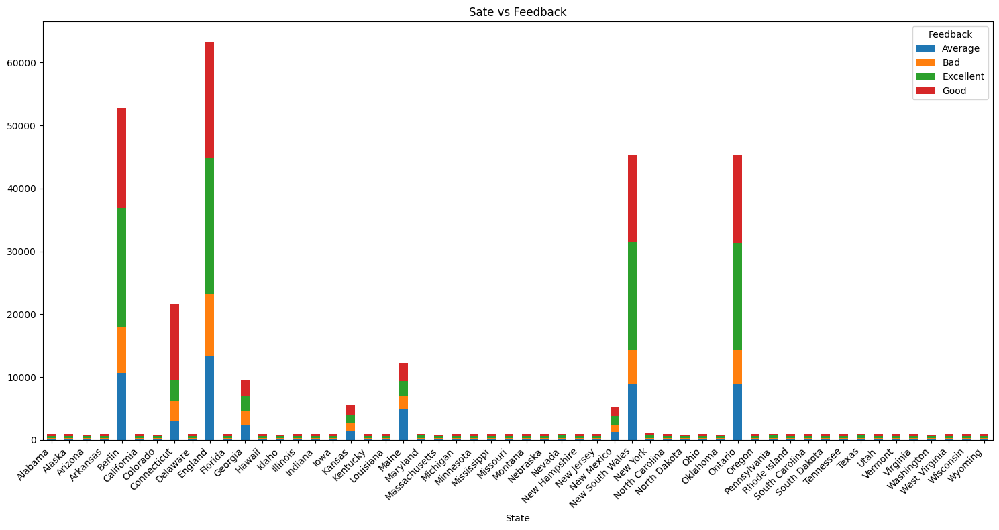

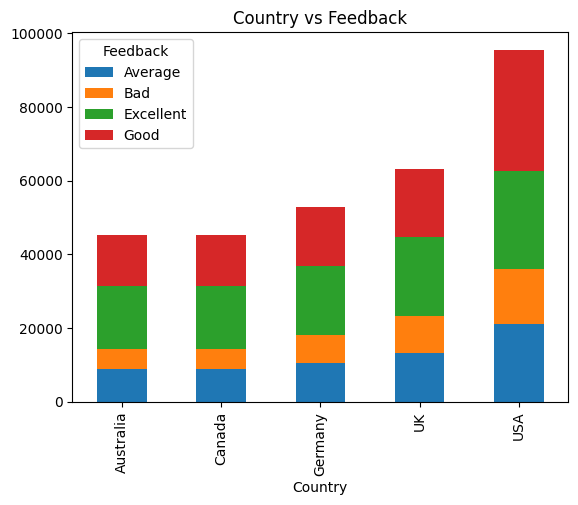

In [52]:
city_crosstab = pd.crosstab(data['City'], data['Feedback'])
city_crosstab.plot(kind='bar', stacked=True, figsize=(25, 10))  # Adjust the figsize as needed
plt.title('City vs Feedback')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()  # Adjust layout to ensure everything fits without overlap
plt.show()

city_crosstab = pd.crosstab(data['State'], data['Feedback'])
city_crosstab.plot(kind='bar', stacked=True, figsize=(15, 8))  # Adjust the figsize as needed
plt.title('Sate vs Feedback')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()  # Adjust layout to ensure everything fits without overlap
plt.show()

pd.crosstab(data['Country'], data['Feedback']).plot(kind='bar', stacked=True)
plt.title('Country vs Feedback')
plt.show()


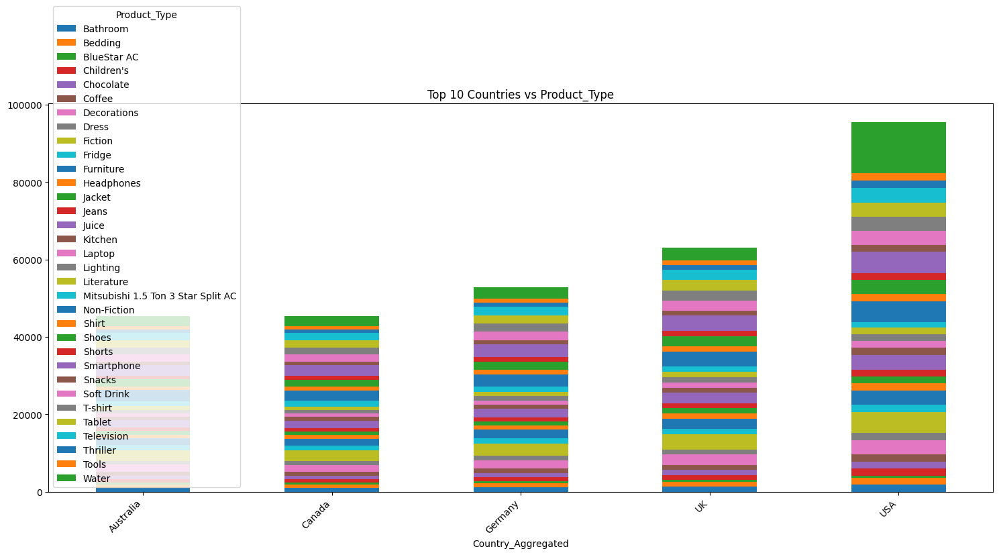

In [53]:
import pandas as pd
import matplotlib.pyplot as plt

def aggregate_to_other(series, top_n=10):
    counts = series.value_counts()
    top_categories = counts.head(top_n).index
    return series.apply(lambda x: x if x in top_categories else 'Other')


# Country (aggregated smaller categories)
data['Country_Aggregated'] = aggregate_to_other(data['Country'], top_n=10)
country_crosstab = pd.crosstab(data['Country_Aggregated'], data['Product_Type'])
country_crosstab.plot(kind='bar', stacked=True, figsize=(15, 8))
plt.title('Top 10 Countries vs Product_Type')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


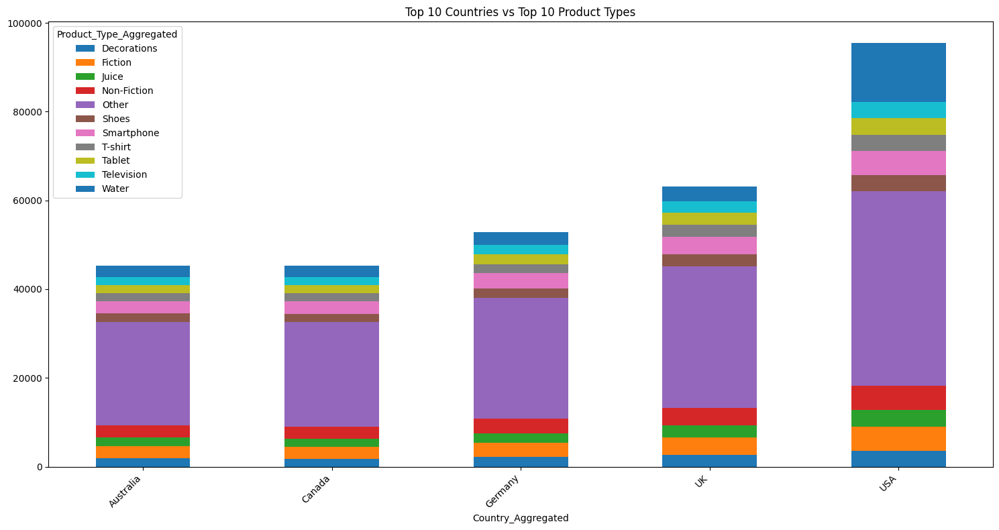

In [54]:
import pandas as pd
import matplotlib.pyplot as plt

def aggregate_to_other(series, top_n=10):
    counts = series.value_counts()
    top_categories = counts.head(top_n).index
    return series.apply(lambda x: x if x in top_categories else 'Other')


# Top 10 Countries
data['Country_Aggregated'] = aggregate_to_other(data['Country'], top_n=10)

# Top 10 Product Types
data['Product_Type_Aggregated'] = aggregate_to_other(data['Product_Type'])


# Plot Country vs Product_Type
country_crosstab = pd.crosstab(data['Country_Aggregated'], data['Product_Type_Aggregated'])
country_crosstab.plot(kind='bar', stacked=True, figsize=(15, 8))
plt.title('Top 10 Countries vs Top 10 Product Types')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


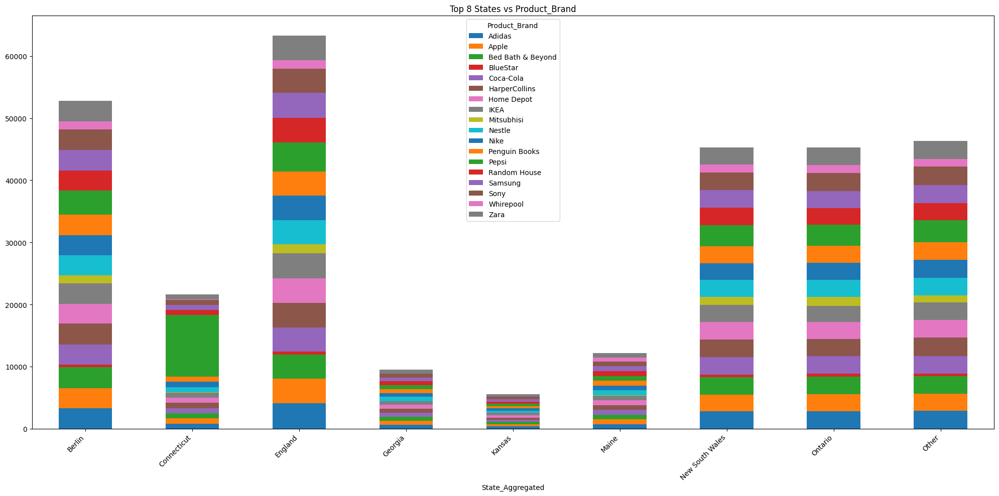

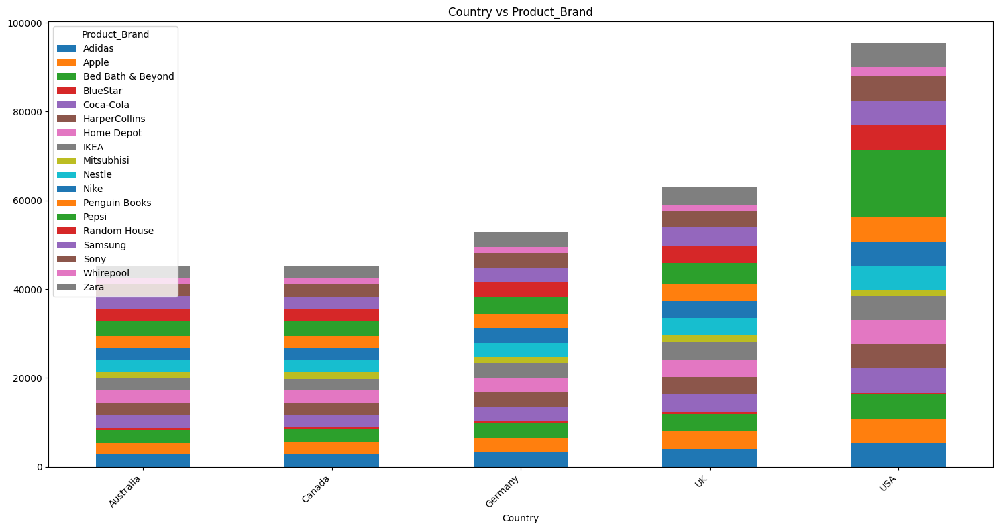

In [55]:
import pandas as pd
import matplotlib.pyplot as plt

def aggregate_to_other(series, top_n=8):
    counts = series.value_counts()
    top_categories = counts.head(top_n).index
    return series.apply(lambda x: x if x in top_categories else 'Other')

# Aggregate to top 8 cities
data['City_Aggregated'] = aggregate_to_other(data['City'], top_n=8)

# Aggregate to top 8 states
data['State_Aggregated'] = aggregate_to_other(data['State'], top_n=8)

# Plot State vs Product_Brand
state_crosstab = pd.crosstab(data['State_Aggregated'], data['Product_Brand'])
state_crosstab.plot(kind='bar', stacked=True, figsize=(20, 10))
plt.title('Top 8 States vs Product_Brand')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Plot Country vs Product_Brand (keeping it unchanged)
country_crosstab = pd.crosstab(data['Country'], data['Product_Brand'])
country_crosstab.plot(kind='bar', stacked=True, figsize=(15, 8))
plt.title('Country vs Product_Brand')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


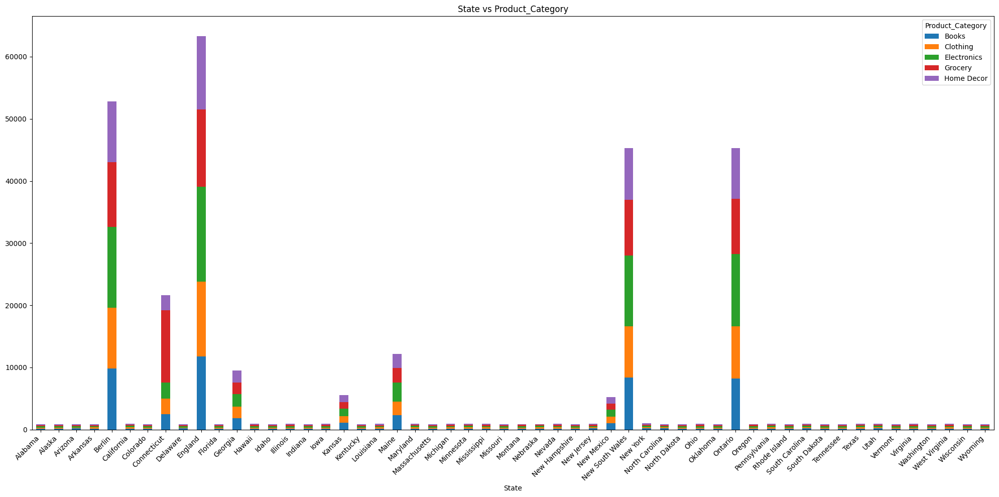

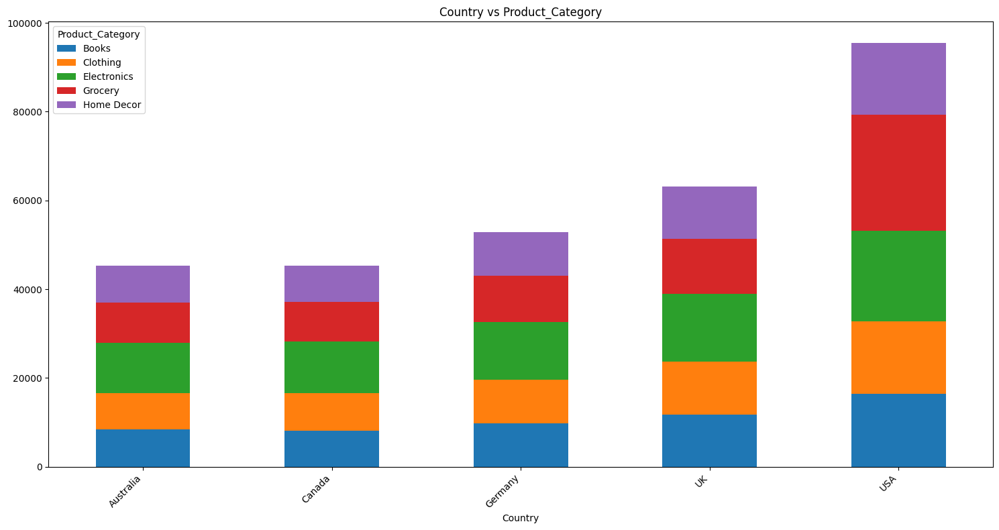

In [56]:
# State vs Another_Categorical_Var
state_crosstab = pd.crosstab(data['State'], data['Product_Category'])
state_crosstab.plot(kind='bar', stacked=True, figsize=(20, 10))  # Adjust the figsize as needed
plt.title('State vs Product_Category')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()  # Adjust layout to ensure everything fits without overlap
plt.show()

# Country vs Another_Categorical_Var
country_crosstab = pd.crosstab(data['Country'], data['Product_Category'])
country_crosstab.plot(kind='bar', stacked=True, figsize=(15, 8))  # Adjust the figsize as needed
plt.title('Country vs Product_Category')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()  # Adjust layout to ensure everything fits without overlap
plt.show()


****Gender, Income and Customer_Segment analysis***

         count unique     top   freq
Gender                              
Female  114093      3  Medium  50523
Male    187913      3  Medium  79997


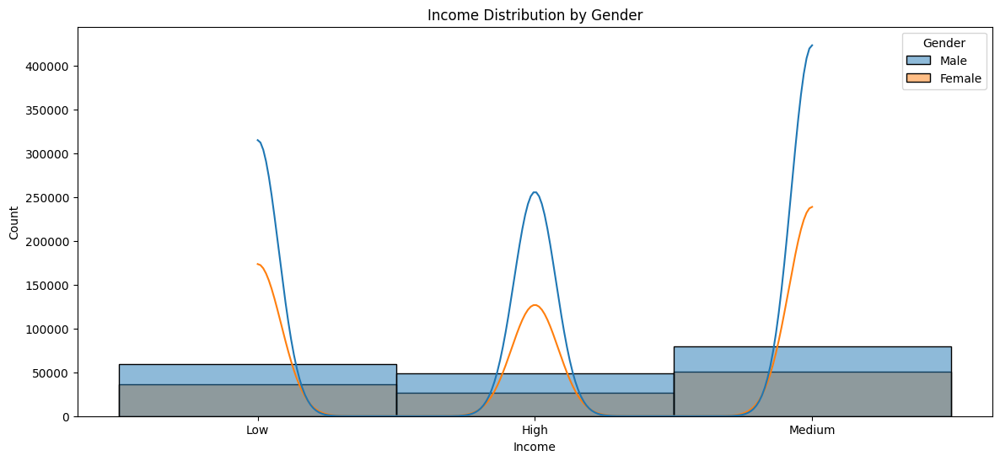

In [57]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

summary_stats = data.groupby('Gender')['Income'].describe()
print(summary_stats)

plt.figure(figsize=(14, 6))
sns.histplot(data, x='Income', hue='Gender', kde=True, bins=30)
plt.title('Income Distribution by Gender')
plt.show()



In [58]:
# Frequency and proportion of each category in 'Gender'
gender_counts = data['Gender'].value_counts()
gender_proportion = data['Gender'].value_counts(normalize=True)

# Frequency and proportion of each category in 'Income'
income_counts = data['Income'].value_counts()
income_proportion = data['Income'].value_counts(normalize=True)

# Frequency and proportion of each category in 'Customer_Segment'
segment_counts = data['Customer_Segment'].value_counts()
segment_proportion = data['Customer_Segment'].value_counts(normalize=True)

print("Gender Counts:\n", gender_counts)
print("_________________________________________________")

print("Gender Proportions:\n", gender_proportion)
print("_________________________________________________")

print("Income Counts:\n", income_counts)
print("_________________________________________________")

print("Income Proportions:\n", income_proportion)
print("_________________________________________________")


print("Customer Segment Counts:\n", segment_counts)
print("_________________________________________________")


print("Customer Segment Proportions:\n", segment_proportion)


Gender Counts:
 Gender
Male      187913
Female    114093
Name: count, dtype: int64
_________________________________________________
Gender Proportions:
 Gender
Male      0.622216
Female    0.377784
Name: proportion, dtype: float64
_________________________________________________
Income Counts:
 Income
Medium    130520
Low        96257
High       75229
Name: count, dtype: int64
_________________________________________________
Income Proportions:
 Income
Medium    0.432177
Low       0.318725
High      0.249098
Name: proportion, dtype: float64
_________________________________________________
Customer Segment Counts:
 Customer_Segment
Regular    146434
New         91185
Premium     64387
Name: count, dtype: int64
_________________________________________________
Customer Segment Proportions:
 Customer_Segment
Regular    0.484871
New        0.301931
Premium    0.213198
Name: proportion, dtype: float64


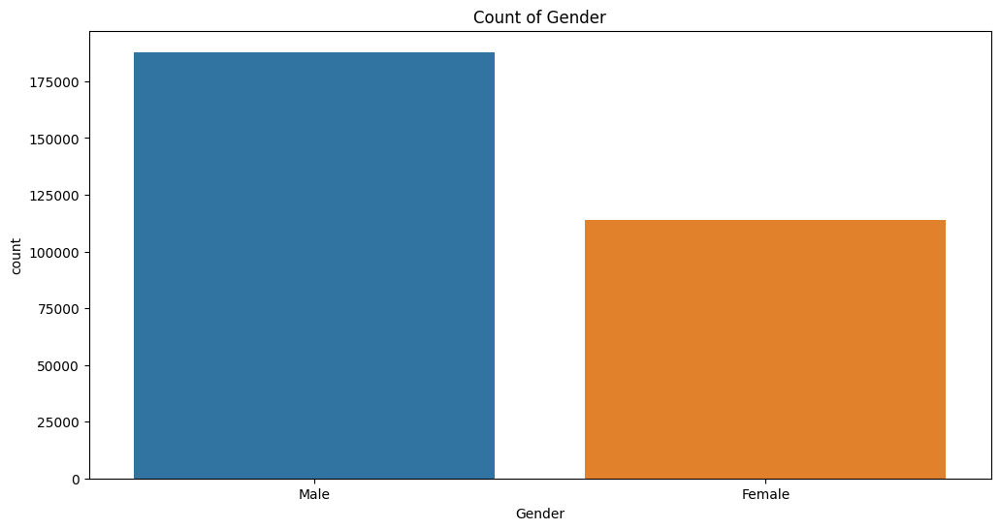

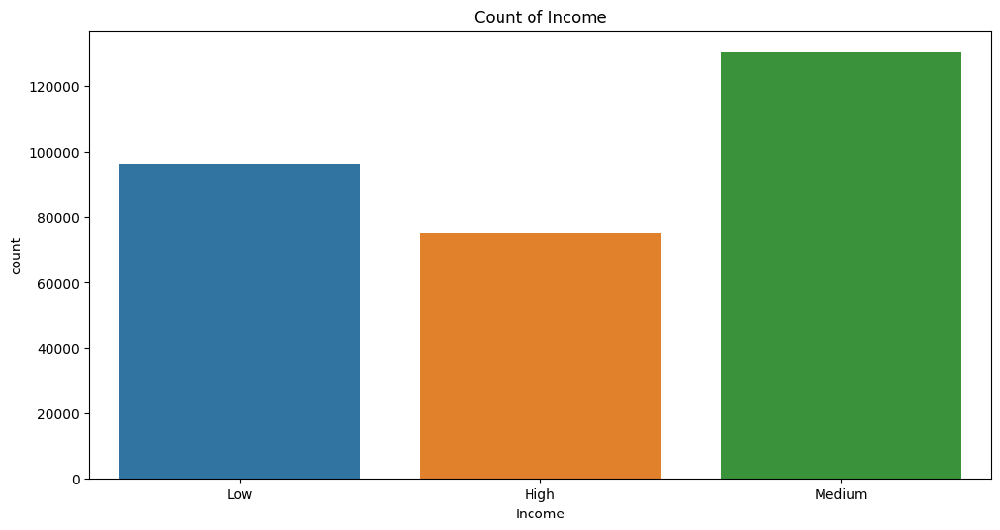

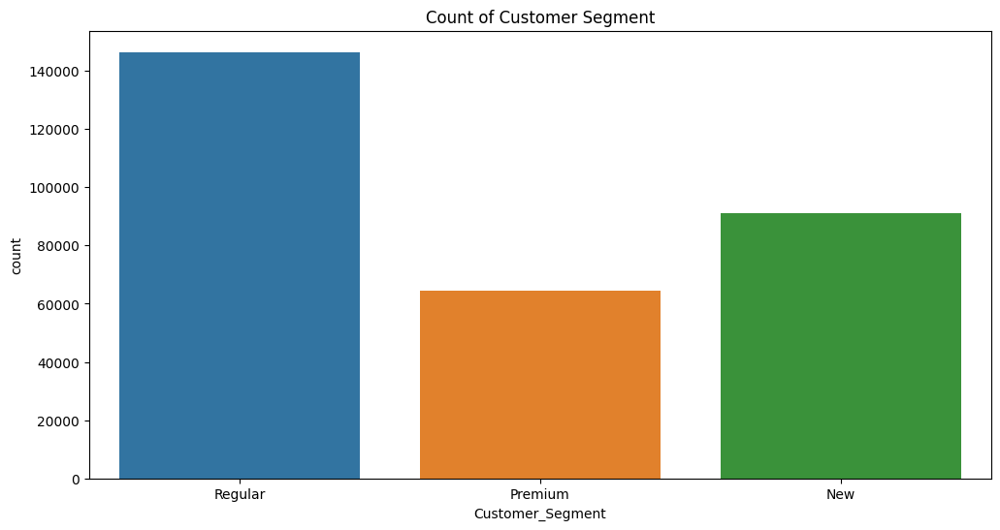

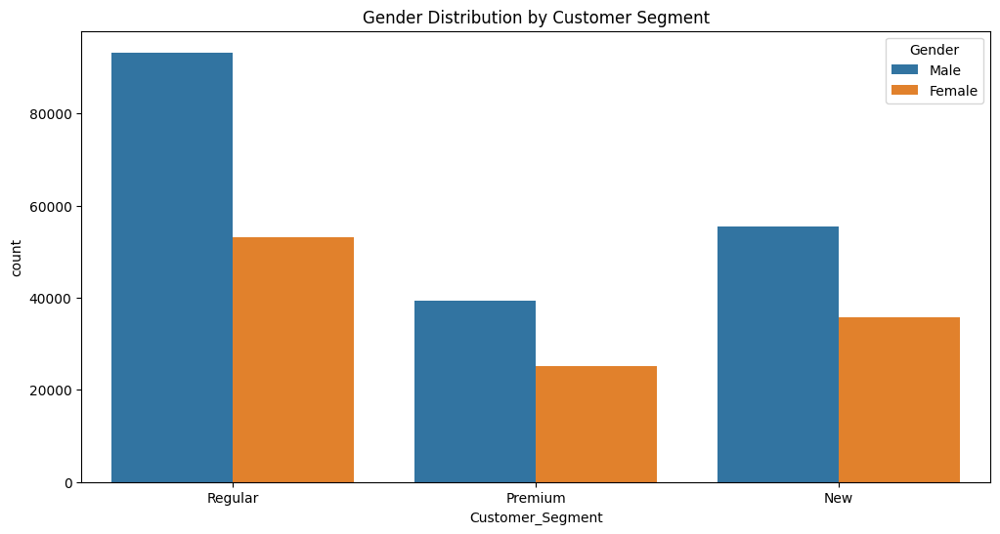

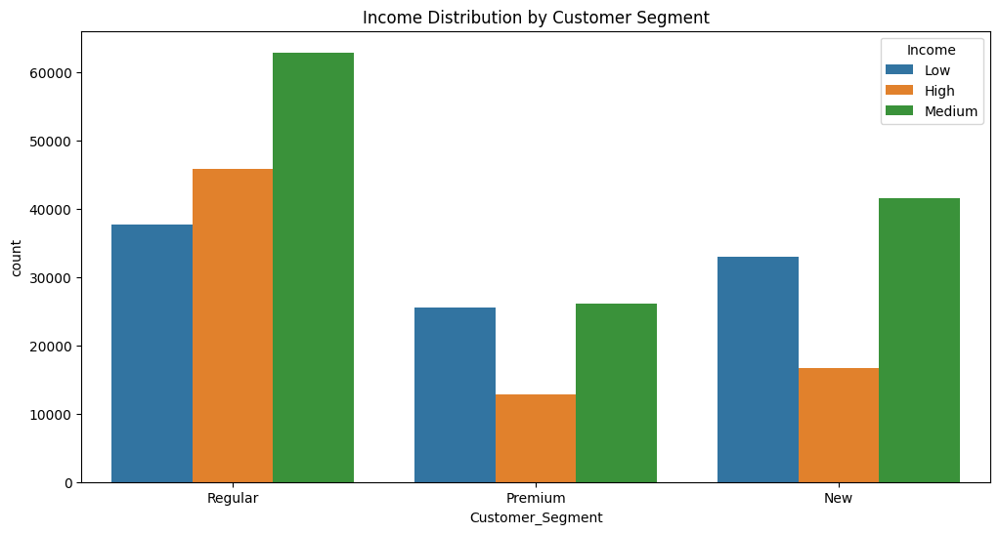

In [59]:
import seaborn as sns
import matplotlib.pyplot as plt

# Count plot for Gender
plt.figure(figsize=(12, 6))
sns.countplot(x='Gender', data=data)
plt.title('Count of Gender')
plt.show()

# Count plot for Income
plt.figure(figsize=(12, 6))
sns.countplot(x='Income', data=data)
plt.title('Count of Income')
plt.show()

# Count plot for Customer Segment
plt.figure(figsize=(12, 6))
sns.countplot(x='Customer_Segment', data=data)
plt.title('Count of Customer Segment')
plt.show()

# Count plot for Gender by Customer Segment
plt.figure(figsize=(12, 6))
sns.countplot(x='Customer_Segment', hue='Gender', data=data)
plt.title('Gender Distribution by Customer Segment')
plt.show()

# Count plot for Income by Customer Segment
plt.figure(figsize=(12, 6))
sns.countplot(x='Customer_Segment', hue='Income', data=data)
plt.title('Income Distribution by Customer Segment')
plt.show()


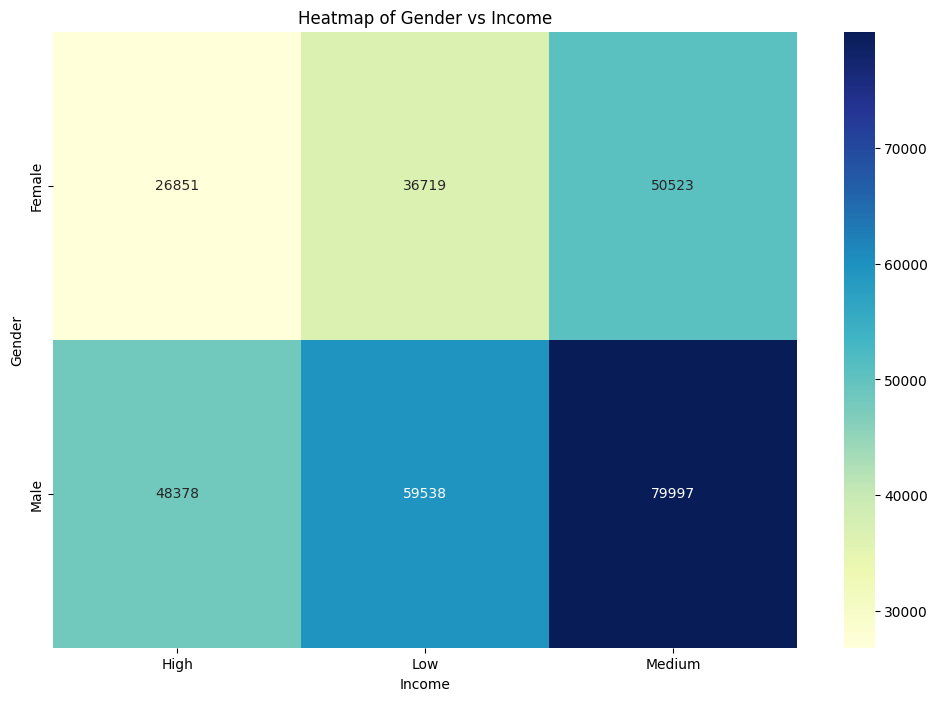

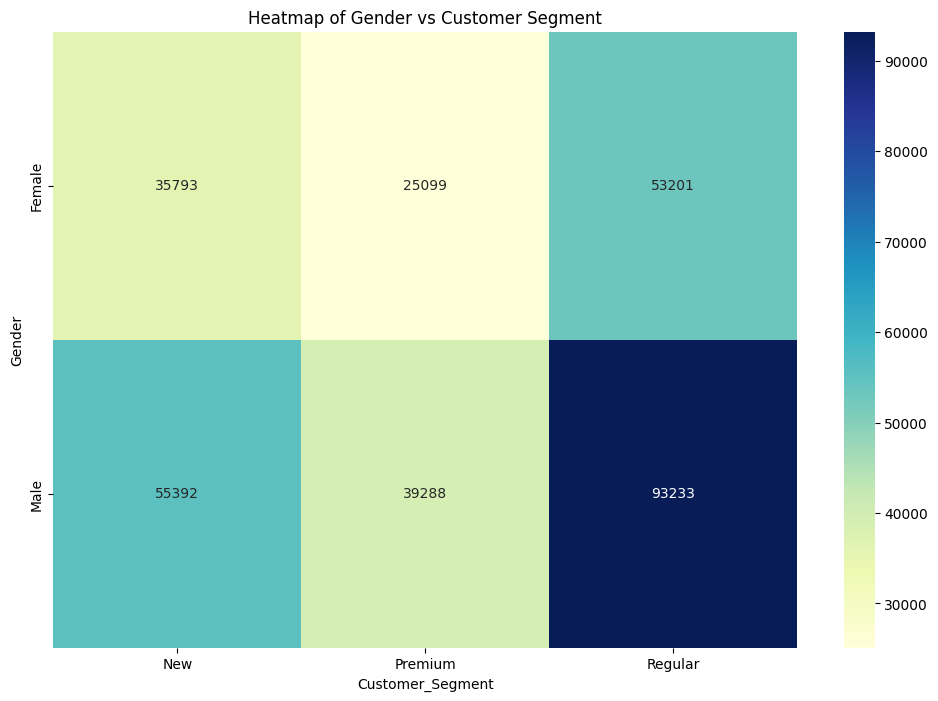

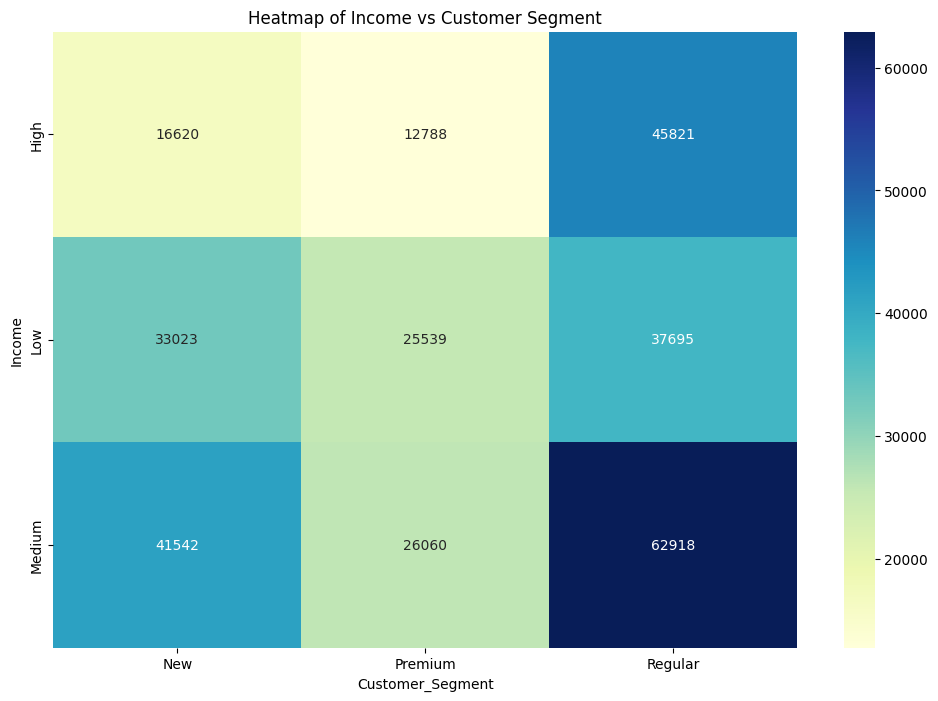

In [60]:
import seaborn as sns
import matplotlib.pyplot as plt

# Cross-tabulation between 'Gender' and 'Income'
gender_income_crosstab = pd.crosstab(data['Gender'], data['Income'])

# Heatmap for Gender vs. Income
plt.figure(figsize=(12, 8))
sns.heatmap(gender_income_crosstab, annot=True, fmt='d', cmap='YlGnBu')
plt.title('Heatmap of Gender vs Income')
plt.show()

# Cross-tabulation between 'Gender' and 'Customer_Segment'
gender_segment_crosstab = pd.crosstab(data['Gender'], data['Customer_Segment'])

# Heatmap for Gender vs. Customer Segment
plt.figure(figsize=(12, 8))
sns.heatmap(gender_segment_crosstab, annot=True, fmt='d', cmap='YlGnBu')
plt.title('Heatmap of Gender vs Customer Segment')
plt.show()

# Cross-tabulation between 'Income' and 'Customer_Segment'
income_segment_crosstab = pd.crosstab(data['Income'], data['Customer_Segment'])

# Heatmap for Income vs. Customer Segment
plt.figure(figsize=(12, 8))
sns.heatmap(income_segment_crosstab, annot=True, fmt='d', cmap='YlGnBu')
plt.title('Heatmap of Income vs Customer Segment')
plt.show()


In [61]:
from scipy.stats import chi2_contingency

# Chi-Square test between 'Gender' and 'Income'
chi2_gender_income, p_gender_income, dof_gender_income, ex_gender_income = chi2_contingency(gender_income_crosstab)
print("Chi-Square Test between Gender and Income")
print("Chi2:", chi2_gender_income, "p-value:", p_gender_income)

# Chi-Square test between 'Gender' and 'Customer_Segment'
chi2_gender_segment, p_gender_segment, dof_gender_segment, ex_gender_segment = chi2_contingency(gender_segment_crosstab)
print("Chi-Square Test between Gender and Customer Segment")
print("Chi2:", chi2_gender_segment, "p-value:", p_gender_segment)

# Chi-Square test between 'Income' and 'Customer_Segment'
chi2_income_segment, p_income_segment, dof_income_segment, ex_income_segment = chi2_contingency(income_segment_crosstab)
print("Chi-Square Test between Income and Customer Segment")
print("Chi2:", chi2_income_segment, "p-value:", p_income_segment)


Chi-Square Test between Gender and Income
Chi2: 192.91293217415864 p-value: 1.2867347638376943e-42
Chi-Square Test between Gender and Customer Segment
Chi2: 254.51454982747657 p-value: 5.405896454867773e-56
Chi-Square Test between Income and Customer Segment
Chi2: 8410.511548935798 p-value: 0.0


In [62]:
# from sklearn.preprocessing import LabelEncoder
# from sklearn.cluster import KMeans
# from sklearn.decomposition import PCA
# # Encoding categorical variables
# le_gender = LabelEncoder()
# le_income = LabelEncoder()
# le_segment = LabelEncoder()
# data['Gender_Encoded'] = le_gender.fit_transform(data['Gender'])
# data['Income_Encoded'] = le_income.fit_transform(data['Income'])
# data['Customer_Segment_Encoded'] = le_segment.fit_transform(data['Customer_Segment'])
# # Clustering
# features = data[['Gender_Encoded', 'Income_Encoded', 'Customer_Segment_Encoded']]
# kmeans = KMeans(n_clusters=3, random_state=42)
# data['Cluster'] = kmeans.fit_predict(features)
# # Visualization of clusters using PCA
# pca = PCA(n_components=2)
# components = pca.fit_transform(features)
# data['PCA1'] = components[:, 0]
# data['PCA2'] = components[:, 1]
# plt.figure(figsize=(12, 8))
# sns.scatterplot(x='PCA1', y='PCA2', hue='Cluster', data=data, palette='Set1')
# plt.title('Customer Segmentation Clustering')
# plt.show()

In [63]:
data.Order_Status.unique()

array(['Shipped', 'Processing', 'Pending', 'Delivered'], dtype=object)

 ****Feedback and OrderStatus****

In [64]:
contingency_table = pd.crosstab(data['Order_Status'], data['Feedback'])
print(contingency_table)


Feedback      Average    Bad  Excellent   Good
Order_Status                                  
Delivered       24907  19197      40794  45785
Pending         11164   7927      14728  15282
Processing      11195   8080      22595  15328
Shipped         15407   8093      22821  18703


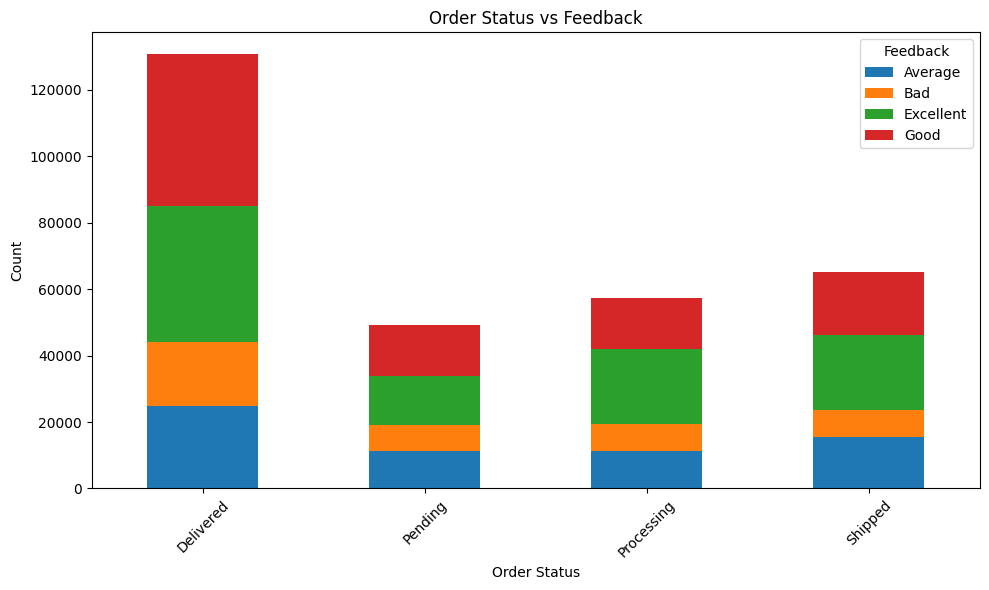

In [65]:
contingency_table.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Order Status vs Feedback')
plt.xlabel('Order Status')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.legend(title='Feedback')
plt.tight_layout()
plt.show()


In [66]:
from scipy.stats import chi2_contingency

chi2, p, dof, expected = chi2_contingency(contingency_table)
print(f'Chi2 Statistic: {chi2}')
print(f'p-value: {p}')

if p < 0.05:
    print("There is a significant association between feedback and order status.")
else:
    print("There is no significant association between feedback and order status.")


Chi2 Statistic: 2997.716501957346
p-value: 0.0
There is a significant association between feedback and order status.


Feedback       Average       Bad  Excellent      Good
Order_Status                                         
Delivered     0.190591  0.146897   0.312160  0.350352
Pending       0.227368  0.161443   0.299953  0.311236
Processing    0.195724  0.141264   0.395031  0.267981
Shipped       0.236943  0.124462   0.350963  0.287632


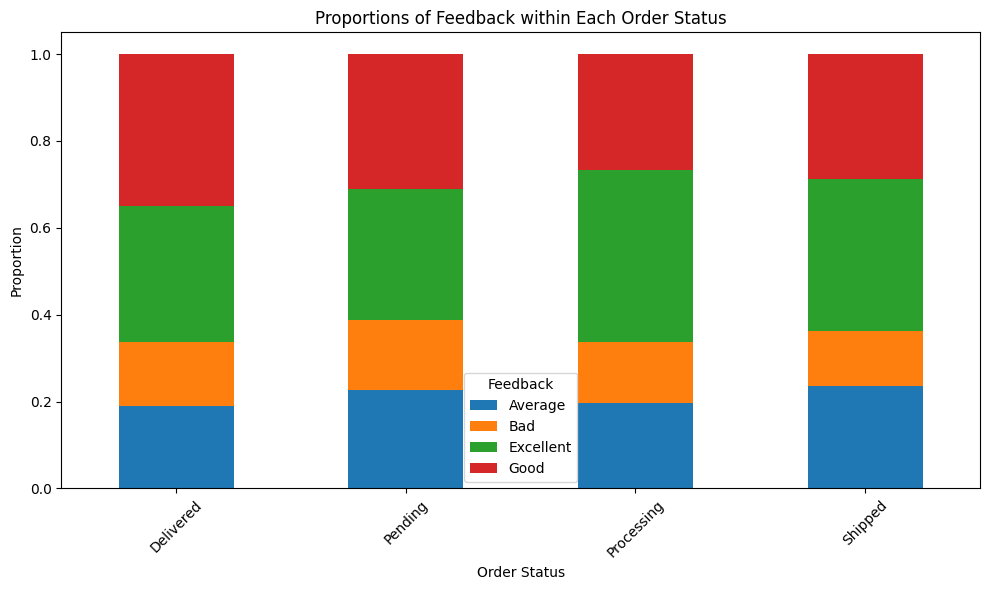

In [67]:
proportions = contingency_table.div(contingency_table.sum(axis=1), axis=0)
print(proportions)

proportions.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Proportions of Feedback within Each Order Status')
plt.xlabel('Order Status')
plt.ylabel('Proportion')
plt.xticks(rotation=45)
plt.legend(title='Feedback')
plt.tight_layout()
plt.show()



In [68]:
proportions = proportions.reset_index()

proportions_melted = proportions.melt(id_vars='Order_Status', var_name='Feedback', value_name='Proportion')

import plotly.express as px

fig = px.bar(proportions_melted, x='Order_Status', y='Proportion', color='Feedback', 
             title='Proportions of Feedback within Each Order Status',
             hover_data={'Proportion': ':.2f'},  # Format proportions to 2 decimal places
             labels={'Proportion': 'Proportion of Feedback'},
             barmode='stack')

fig.show()

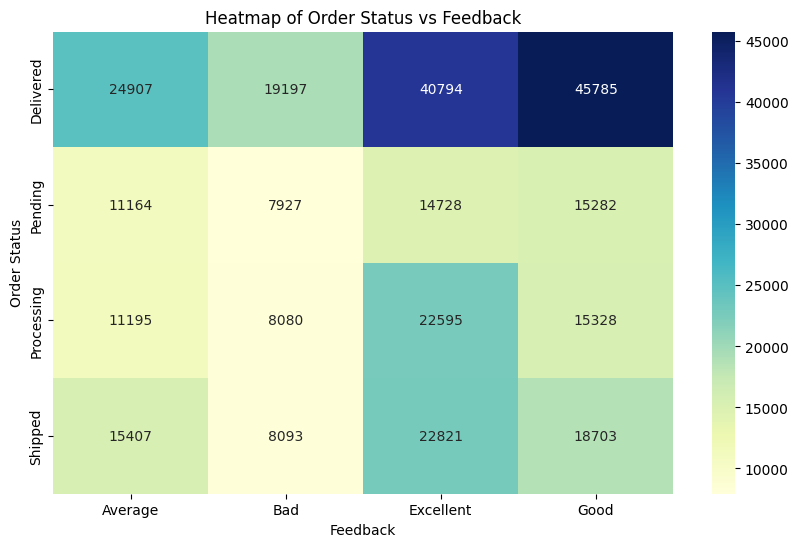

In [69]:
# Heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(contingency_table, annot=True, fmt='d', cmap='YlGnBu')
plt.title('Heatmap of Order Status vs Feedback')
plt.xlabel('Feedback')
plt.ylabel('Order Status')
plt.show()


In [70]:
data.Payment_Method.unique()

array(['Debit Card', 'Credit Card', 'PayPal', 'Cash'], dtype=object)

**Payment Method and Feedback**

In [71]:
contingency_table2 = pd.crosstab(data['Payment_Method'], data['Feedback'])
print(contingency_table2)


Feedback        Average    Bad  Excellent   Good
Payment_Method                                  
Cash              14406   9439      22805  27157
Credit Card       16682  11774      30089  31867
Debit Card        17683  12978      25982  20147
PayPal            13902   9106      22062  15927


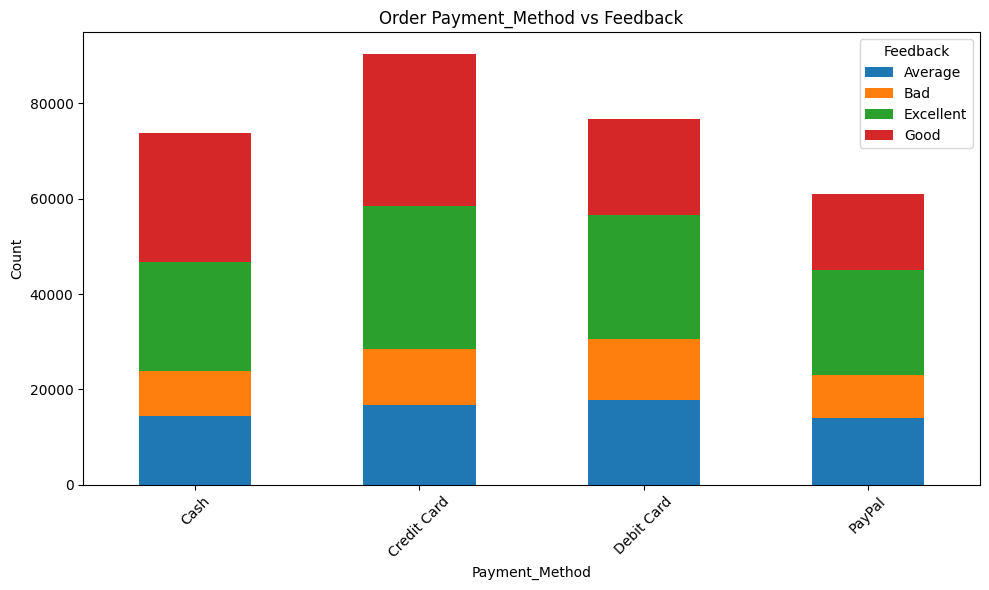

In [72]:
contingency_table2.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Order Payment_Method vs Feedback')
plt.xlabel('Payment_Method')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.legend(title='Feedback')
plt.tight_layout()
plt.show()


In [73]:
from scipy.stats import chi2_contingency

chi2, p, dof, expected = chi2_contingency(contingency_table2)
print(f'Chi2 Statistic: {chi2}')
print(f'p-value: {p}')

if p < 0.05:
    print("There is a significant association between feedback and payment method.")
else:
    print("There is no significant association between feedback and payment method.")


Chi2 Statistic: 3778.974616515291
p-value: 0.0
There is a significant association between feedback and payment method.


Feedback         Average       Bad  Excellent      Good
Payment_Method                                         
Cash            0.195185  0.127888   0.308982  0.367946
Credit Card     0.184511  0.130226   0.332799  0.352464
Debit Card      0.230277  0.169006   0.338351  0.262365
PayPal          0.227913  0.149286   0.361690  0.261111


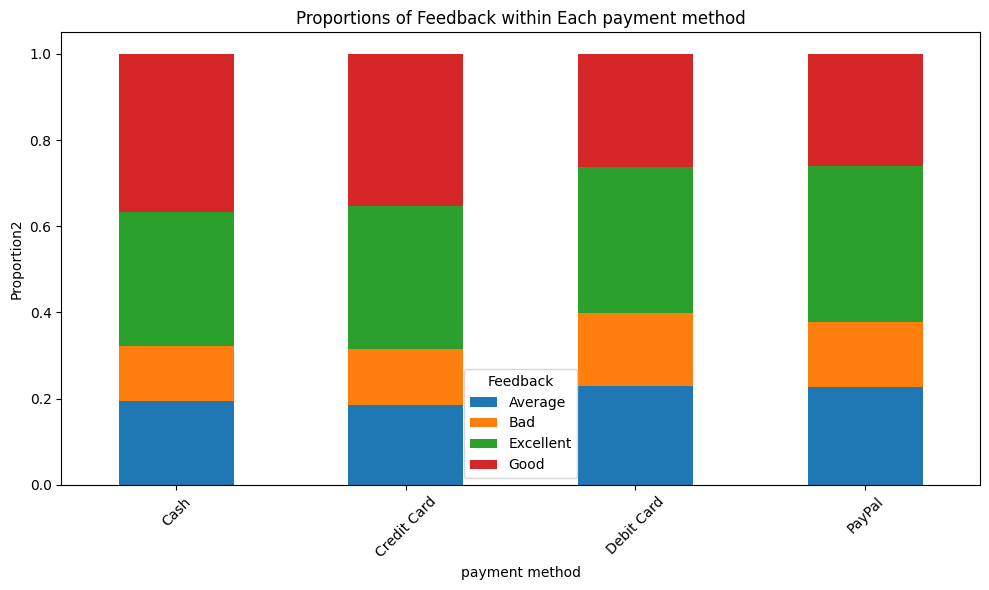

In [74]:
proportions2 = contingency_table2.div(contingency_table2.sum(axis=1), axis=0)
print(proportions2)

proportions2.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title('Proportions of Feedback within Each payment method')
plt.xlabel('payment method')
plt.ylabel('Proportion2')
plt.xticks(rotation=45)
plt.legend(title='Feedback')
plt.tight_layout()
plt.show()



In [75]:
# Resetting the index to make 'Order_Status' a regular column
proportions2 = proportions2.reset_index()

# melt the DataFrame
proportions_melted2 = proportions2.melt(id_vars='Payment_Method', var_name='Feedback', value_name='Proportion2')

import plotly.express as px

fig = px.bar(proportions_melted2, x='Payment_Method', y='Proportion2', color='Feedback', 
             title='Proportions of Feedback within Each Payment_Method',
             hover_data={'Proportion2': ':.2f'},  # Format proportions to 2 decimal places
             labels={'Proportion': 'Proportion of Feedback'},
             barmode='stack')

fig.show()

**Month and order status**

In [76]:
# Aggregating the data by Month and Order_Status
seasonal_status = data.groupby(['Month', 'Order_Status']).size().unstack(fill_value=0).reset_index()

# Melting the DataFrame for plotting
seasonal_status_melted = seasonal_status.melt(id_vars='Month', var_name='Order_Status', value_name='Count')


In [77]:
import matplotlib.pyplot as plt
import seaborn as sns

# Aggregating the data by Month-Year and Order_Status
monthly_status = data.groupby(['Month', 'Order_Status']).size().unstack(fill_value=0).reset_index()

# Melting the DataFrame for plotting
monthly_status_melted = monthly_status.melt(id_vars='Month', var_name='Order_Status', value_name='Count')


In [78]:
import plotly.express as px

# plot for Monthly Trends
fig = px.line(monthly_status_melted, x='Month', y='Count', color='Order_Status', markers=True,
              title='Monthly Trends of Order Status')
fig.update_layout(xaxis_title='Month', yaxis_title='Count', hovermode='x unified')
fig.show()

# plot for Seasonal Patterns
fig = px.bar(seasonal_status_melted, x='Month', y='Count', color='Order_Status',
             title='Seasonal Patterns of Order Status', barmode='group')
fig.update_layout(xaxis_title='Month', yaxis_title='Count', hovermode='x unified')
fig.show()


In [79]:
data.Product_Brand.unique()

array(['Nike', 'Samsung', 'Penguin Books', 'Home Depot', 'Nestle',
       'Apple', 'Zara', 'Random House', 'Coca-Cola', 'Adidas', 'Pepsi',
       'IKEA', 'HarperCollins', 'Bed Bath & Beyond', 'Sony', 'Whirepool',
       'Mitsubhisi', 'BlueStar'], dtype=object)

**Product cat and brands**

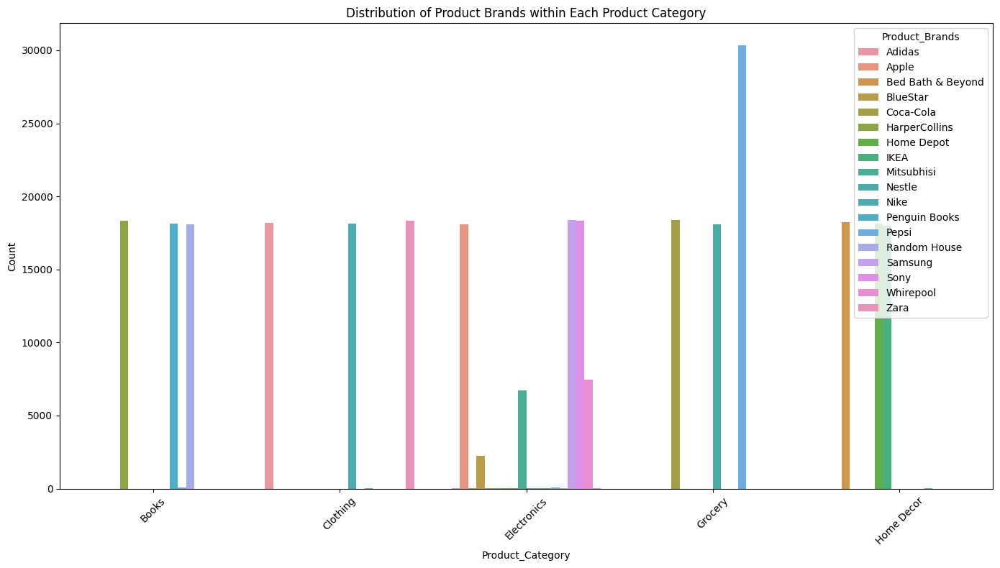

In [80]:
# crosstabulation
crosstab = pd.crosstab(data['Product_Category'], data['Product_Brand'])


crosstab_melted = crosstab.reset_index().melt(id_vars='Product_Category', var_name='Product_Brands', value_name='Count')

# Plottng the stacked bar plot
plt.figure(figsize=(14, 8))
sns.barplot(data=crosstab_melted, x='Product_Category', y='Count', hue='Product_Brands')
plt.title('Distribution of Product Brands within Each Product Category')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [81]:
import plotly.express as px

#plot for brand distribution across categories
fig = px.bar(crosstab_melted, x='Product_Category', y='Count', color='Product_Brands', 
             title='Distribution of Product Brands within Each Product Category',
             labels={'Count': 'Number of Products'},
             barmode='stack')
fig.show()


In [82]:
data.head(1)

,Transaction_ID,Customer_ID,Name,Email,Phone,Address,City,State,Zipcode,Country,Age,Gender,Income,Customer_Segment,Date,Year,Month,Time,Total_Purchases,Amount,Total_Amount,Product_Category,Product_Brand,Product_Type,Feedback,Shipping_Method,Payment_Method,Order_Status,Ratings,products,Country_Aggregated,Product_Type_Aggregated,City_Aggregated,State_Aggregated
0,8691788,37249,Michelle Harrington,Ebony39@gmail.com,1414786801,3959 Amanda Burgs,Dortmund,Berlin,77985,Germany,21,Male,Low,Regular,2023-09-18,2023,September,22:03:55,3.0,108.028757,324.08627,Clothing,Nike,Shorts,Excellent,Same-Day,Debit Card,Shipped,5,Cycling shorts,Germany,Other,Other,Berlin


In [83]:
data.Product_Brand.unique()

array(['Nike', 'Samsung', 'Penguin Books', 'Home Depot', 'Nestle',
       'Apple', 'Zara', 'Random House', 'Coca-Cola', 'Adidas', 'Pepsi',
       'IKEA', 'HarperCollins', 'Bed Bath & Beyond', 'Sony', 'Whirepool',
       'Mitsubhisi', 'BlueStar'], dtype=object)

In [84]:
data.Product_Type.unique()

array(['Shorts', 'Tablet', "Children's", 'Tools', 'Chocolate',
       'Television', 'Shirt', 'Decorations', 'Non-Fiction', 'Water',
       'Snacks', 'T-shirt', 'Literature', 'Juice', 'Furniture', 'Coffee',
       'Bathroom', 'Kitchen', 'Smartphone', 'Shoes', 'Thriller',
       'Soft Drink', 'Laptop', 'Dress', 'Headphones', 'Lighting',
       'Bedding', 'Jacket', 'Fiction', 'Jeans', 'Fridge',
       'Mitsubishi 1.5 Ton 3 Star Split AC', 'BlueStar AC'], dtype=object)

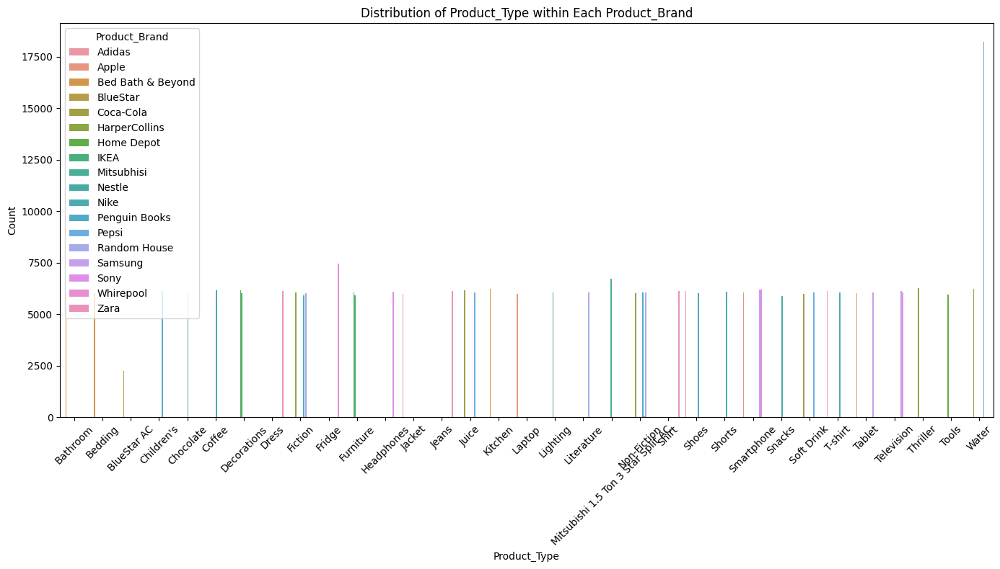

In [85]:
# Create a crosstabulation
crosstab = pd.crosstab(data['Product_Brand'], data['Product_Type'])


crosstab_melted = crosstab.reset_index().melt(id_vars='Product_Brand', var_name='Product_Type', value_name='Count')

# Plot the stacked bar plot
plt.figure(figsize=(14, 8))
sns.barplot(data=crosstab_melted, x='Product_Type', y='Count', hue='Product_Brand')
plt.title('Distribution of Product_Type within Each Product_Brand')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [86]:
import plotly.express as px

# Interactive plot for brand distribution across categories
fig = px.bar(crosstab_melted, x='Product_Brand', y='Count', color='Product_Type', 
             title='Distribution of Product Type within Each Product Brands',
             labels={'Count': 'Number of Products'},
             barmode='stack')
fig.show()


****Catgorical vs Numeric****

In [87]:
import plotly.express as px

# Interactive histogram
fig = px.histogram(data, x='Age', color='Gender', marginal='box', nbins=10,
                   title='Interactive Age Distribution by Gender')
fig.show()


                      Age  Total_Purchases  Total_Amount
Age              1.000000         0.033258      0.022418
Total_Purchases  0.033258         1.000000      0.649075
Total_Amount     0.022418         0.649075      1.000000


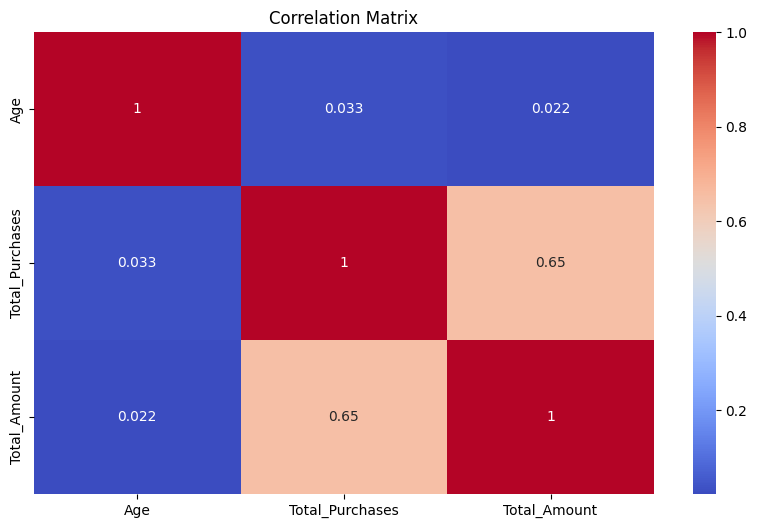

In [88]:
# Correlation matrix
corr_matrix = data[['Age', 'Total_Purchases', 'Total_Amount']].corr()
print(corr_matrix)

# Heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()


****Order Status for category and brands****

In [89]:
import plotly.express as px
import pandas as pd
# count plot for Order_Status vs Product_Category
fig1 = px.histogram(data, x='Order_Status', color='Product_Category', barmode='group',
                    title='Count of Order Status for Each Product Category')
fig1.update_layout(xaxis_title='Order Status', yaxis_title='Count')
fig1.show()


In [90]:
fig2 = px.histogram(data, x='Order_Status', color='Product_Brand', barmode='group',
                    title='Count of Order Status for Each Product Brand')
fig2.update_layout(xaxis_title='Order Status', yaxis_title='Count')
fig2.show()

In [91]:
# Defining age groups
age_group_20_30 = data[(data['Age'] >= 20) & (data['Age'] <= 30)]
age_group_40_50 = data[(data['Age'] >= 40) & (data['Age'] <= 50)]

# Add column to indicate the age group
age_group_20_30['Age_Group'] = '20-30'
age_group_40_50['Age_Group'] = '40-50'

# Combining the two age groups
combined_data = pd.concat([age_group_20_30, age_group_40_50])

# plot for Product_Type within Age Groups
fig = px.histogram(combined_data, x='Product_Category', color='Age_Group', barmode='group',
                   title='Product Type Distribution for Age Groups 20-30 and 40-50')
fig.update_layout(xaxis_title='Product_Category', yaxis_title='Count', hovermode="x")
fig.show()


In [92]:
# Defining age groups
age_group_20_30 = data[(data['Age'] >= 20) & (data['Age'] <= 30)]
age_group_40_50 = data[(data['Age'] >= 40) & (data['Age'] <= 50)]

# Adding new column to indicate the age group
age_group_20_30['Age_Group'] = '20-30'
age_group_40_50['Age_Group'] = '40-50'

# Combining two age groups
combined_data = pd.concat([age_group_20_30, age_group_40_50])

# plot for Product_Type within Age Groups
fig = px.histogram(combined_data, x='Product_Type', color='Age_Group', barmode='group',
                   title='Product Type Distribution for Age Groups 20-30 and 40-50')
fig.update_layout(xaxis_title='Product Type', yaxis_title='Count', hovermode="x")
fig.show()


****Feedback vs Ratings.......................****
**Cheking if they display same opinion**

Feedback      Average    Bad  Excellent   Good
Order_Status                                  
Delivered       24907  19197      40794  45785
Pending         11164   7927      14728  15282
Processing      11195   8080      22595  15328
Shipped         15407   8093      22821  18703


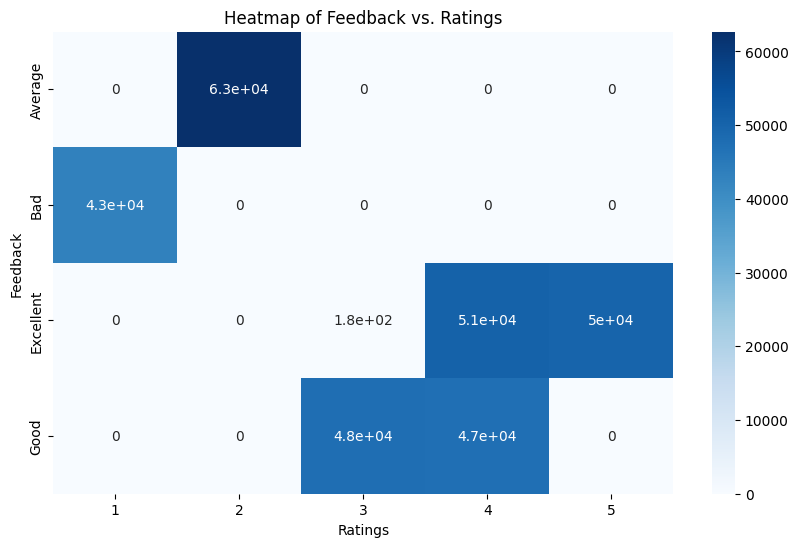

In [93]:
contingency_table4 = pd.crosstab(data['Feedback'], data['Ratings'])
print(contingency_table)


plt.figure(figsize=(10, 6))
sns.heatmap(contingency_table4, annot=True, cmap='Blues')
plt.title('Heatmap of Feedback vs. Ratings')
plt.show()


In [94]:
from scipy.stats import chi2_contingency

chi2, p, dof, expected = chi2_contingency(contingency_table4)
print(f"Chi2: {chi2}, p-value: {p}")


Chi2: 753835.9202945315, p-value: 0.0


****Feedback distribution for Product Brands****

In [95]:
# Filter for Bad and Average feedback
bad_avg_feedback = data[data['Feedback'].isin(['Bad', 'Average'])]

# Filter for Good and Excellent feedback
good_exc_feedback = data[data['Feedback'].isin(['Good', 'Excellent'])]


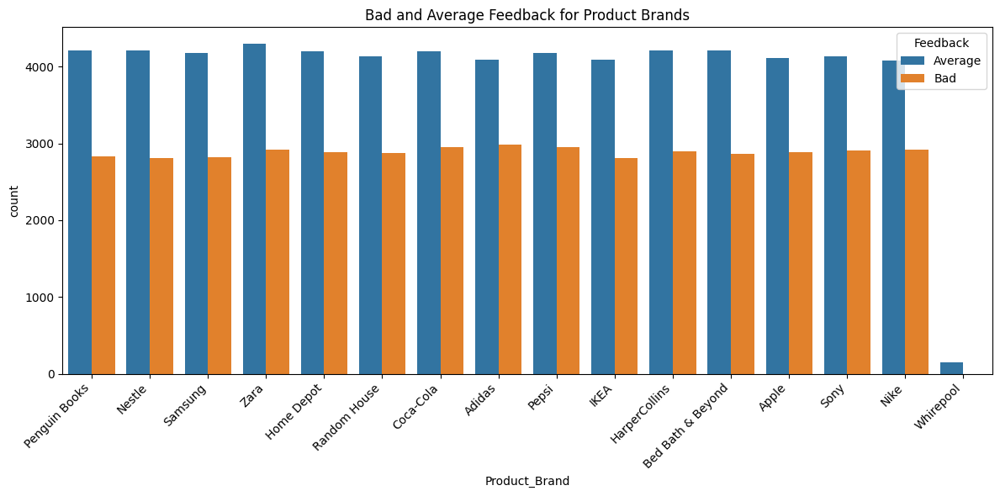

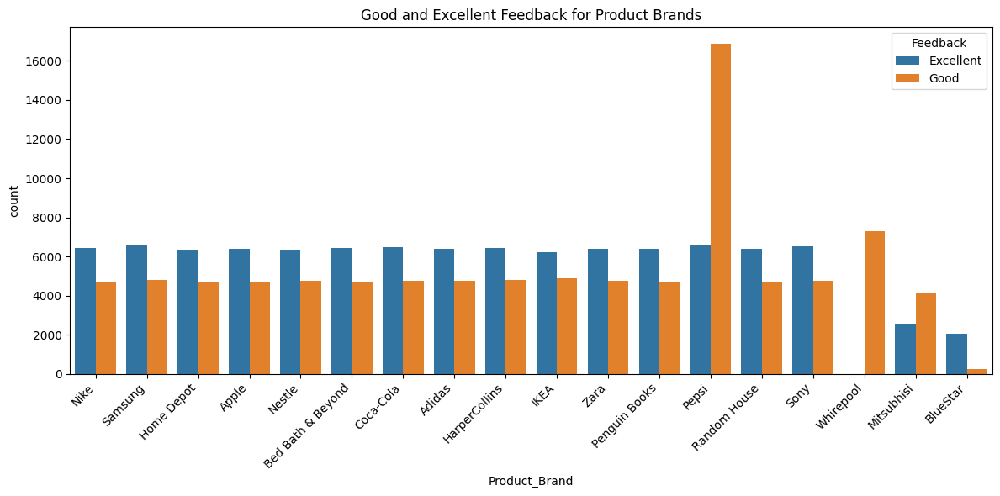

In [96]:
# Plot for Bad and Average Feedback
plt.figure(figsize=(12, 6))
sns.countplot(data=bad_avg_feedback, x='Product_Brand', hue='Feedback')
plt.title('Bad and Average Feedback for Product Brands')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Plot for Good and Excellent Feedback
plt.figure(figsize=(12, 6))
sns.countplot(data=good_exc_feedback, x='Product_Brand', hue='Feedback')
plt.title('Good and Excellent Feedback for Product Brands')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


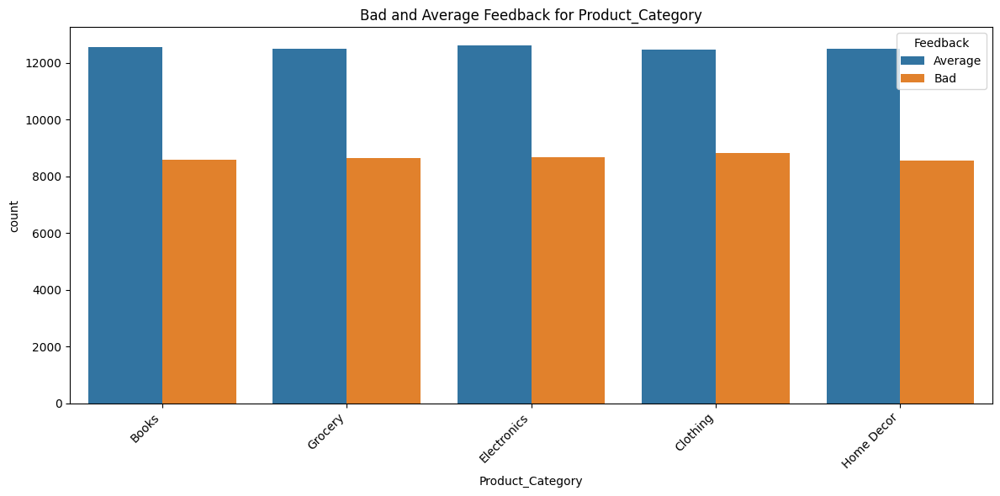

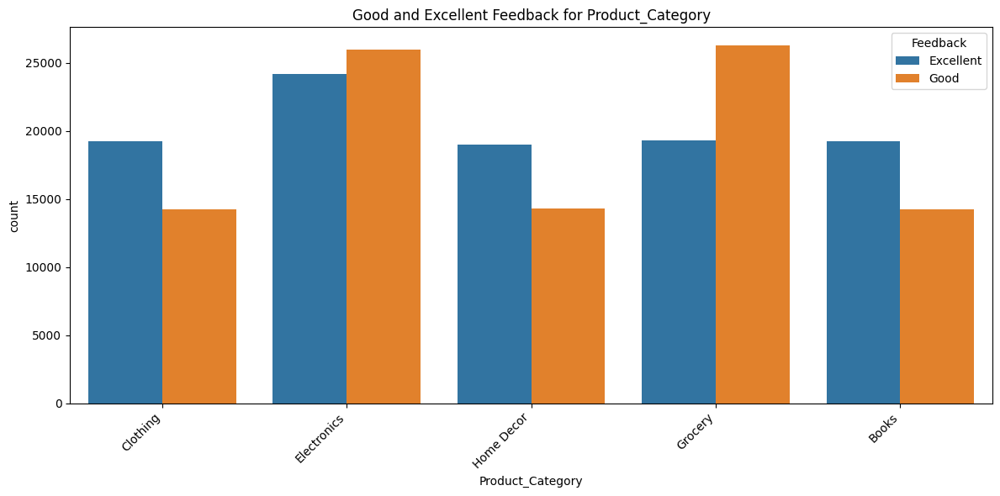

In [97]:
# Plot for Bad and Average Feedback
plt.figure(figsize=(12, 6))
sns.countplot(data=bad_avg_feedback, x='Product_Category', hue='Feedback')
plt.title('Bad and Average Feedback for Product_Category')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Plot for Good and Excellent Feedback
plt.figure(figsize=(12, 6))
sns.countplot(data=good_exc_feedback, x='Product_Category', hue='Feedback')
plt.title('Good and Excellent Feedback for Product_Category')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


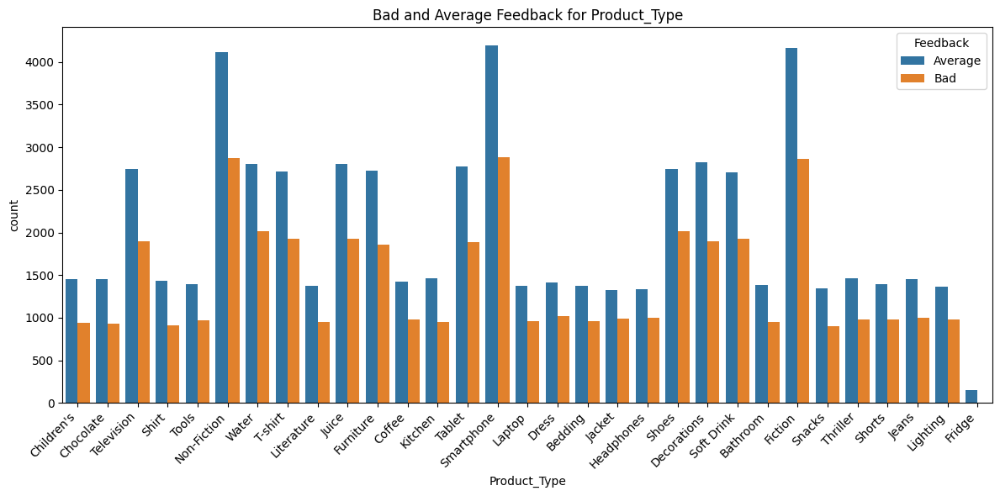

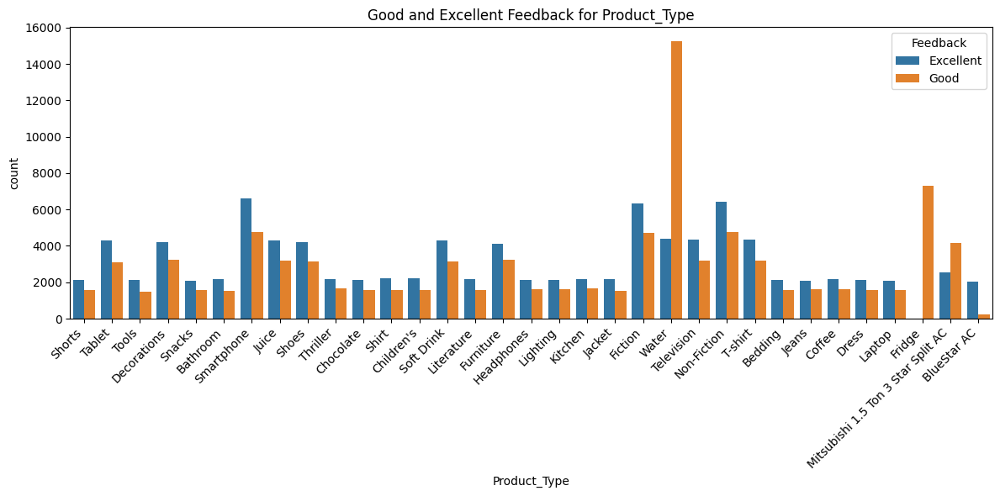

In [98]:
# Plot for Bad and Average Feedback
plt.figure(figsize=(12, 6))
sns.countplot(data=bad_avg_feedback, x='Product_Type', hue='Feedback')
plt.title('Bad and Average Feedback for Product_Type')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Plot for Good and Excellent Feedback
plt.figure(figsize=(12, 6))
sns.countplot(data=good_exc_feedback, x='Product_Type', hue='Feedback')
plt.title('Good and Excellent Feedback for Product_Type')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


In [99]:
# Aggregating data to find the counts for each category, brand, and type
category_counts = data.groupby(['Country', 'Product_Category']).size().reset_index(name='Counts')
brand_counts = data.groupby(['Country', 'Product_Brand']).size().reset_index(name='Counts')
type_counts = data.groupby(['Country', 'Product_Type']).size().reset_index(name='Counts')


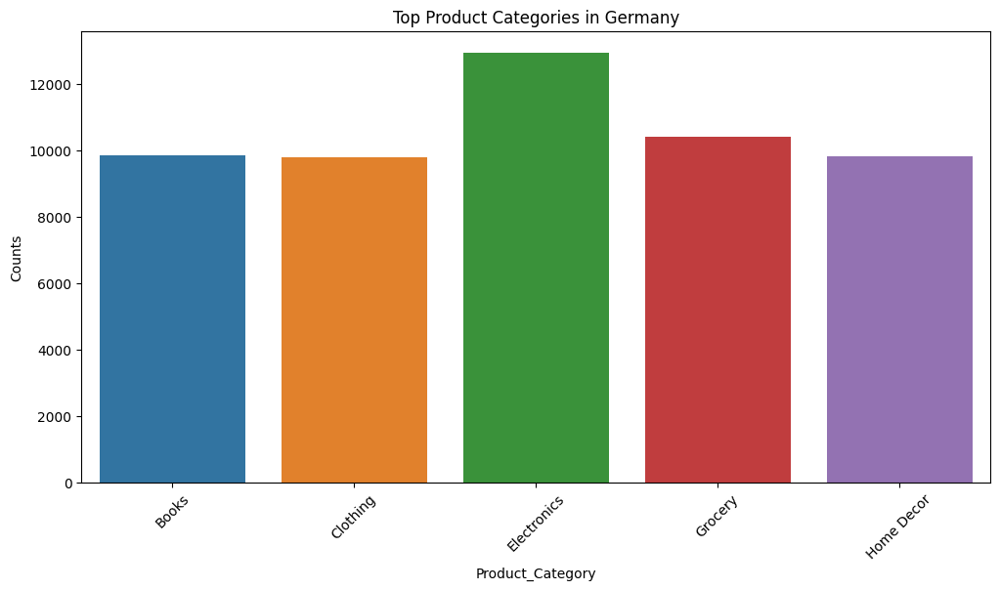

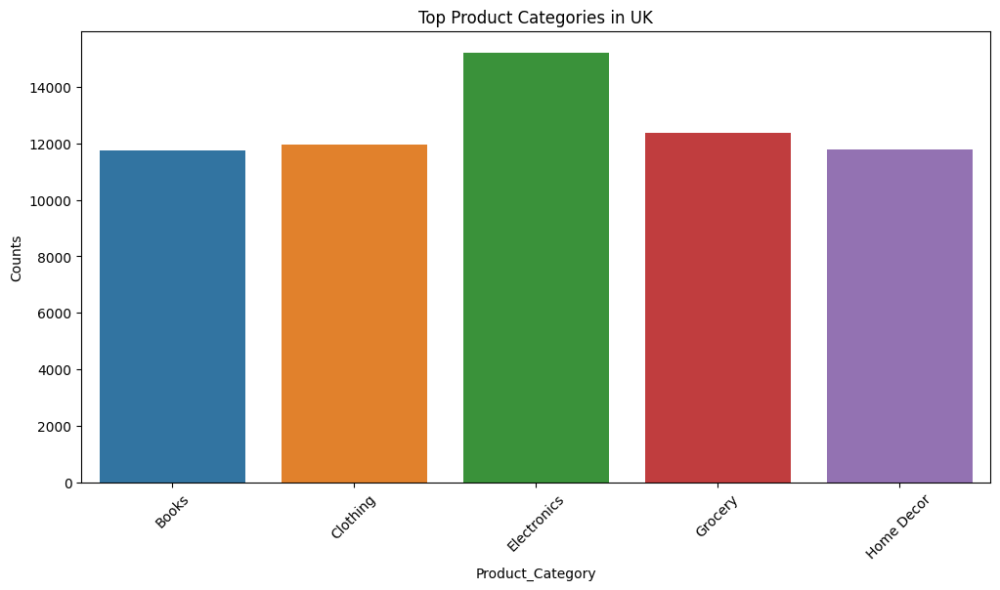

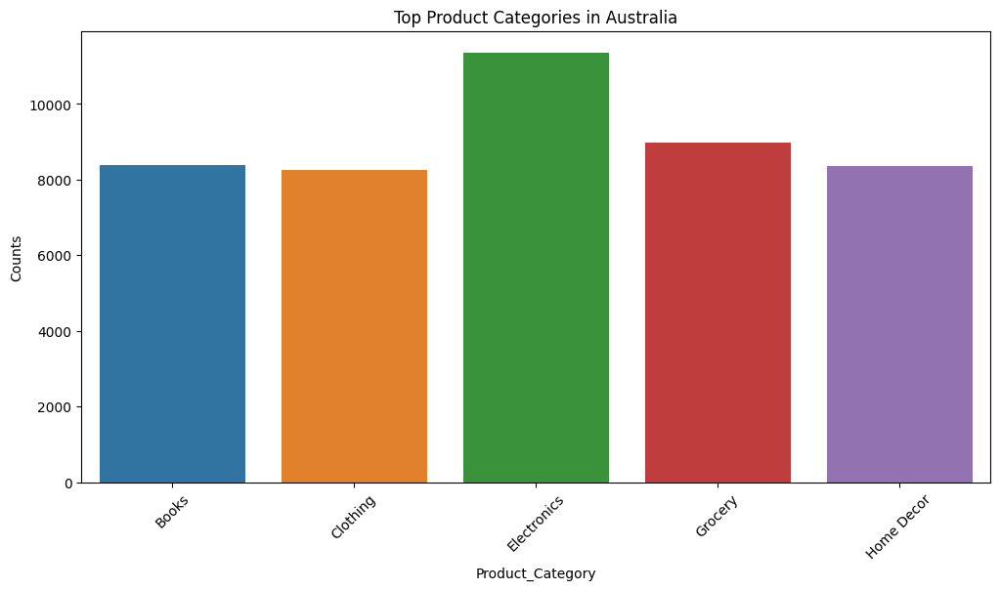

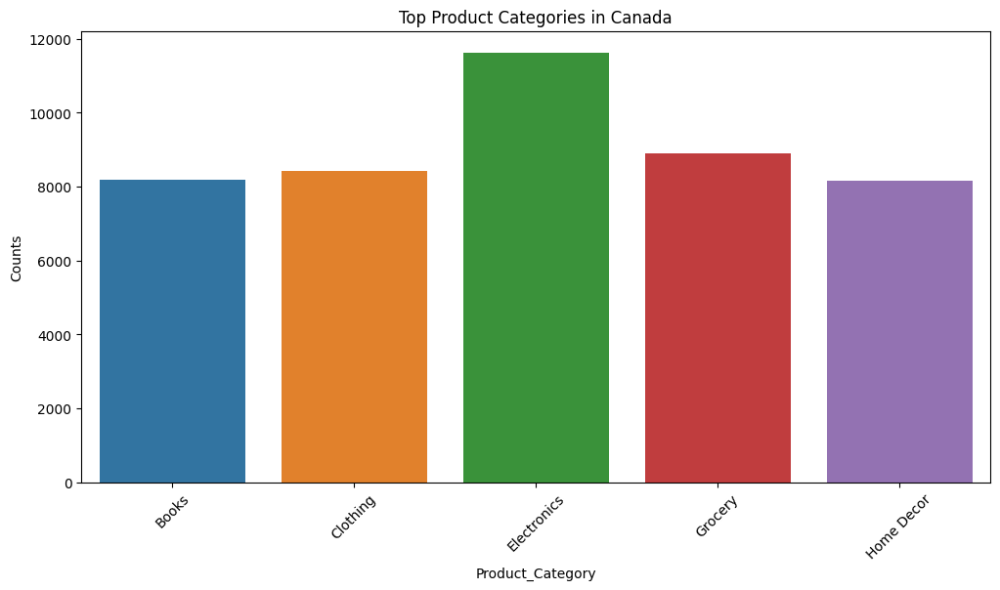

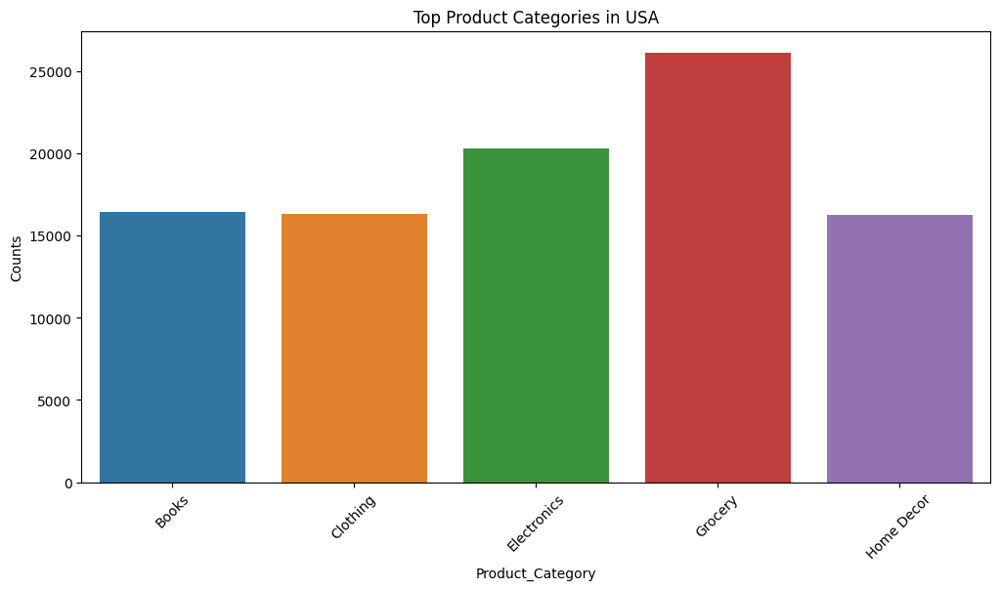

In [100]:
countries = data['Country'].unique()

for country in countries:
    plt.figure(figsize=(12, 6))
    sns.barplot(data=category_counts[category_counts['Country'] == country], x='Product_Category', y='Counts')
    plt.title(f'Top Product Categories in {country}')
    plt.xticks(rotation=45)
    plt.show()


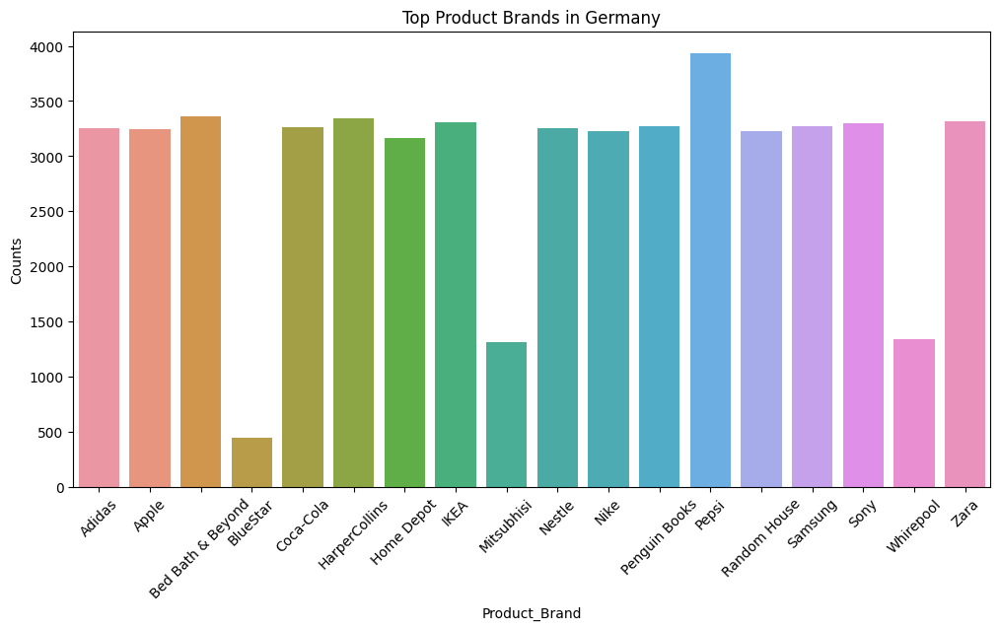

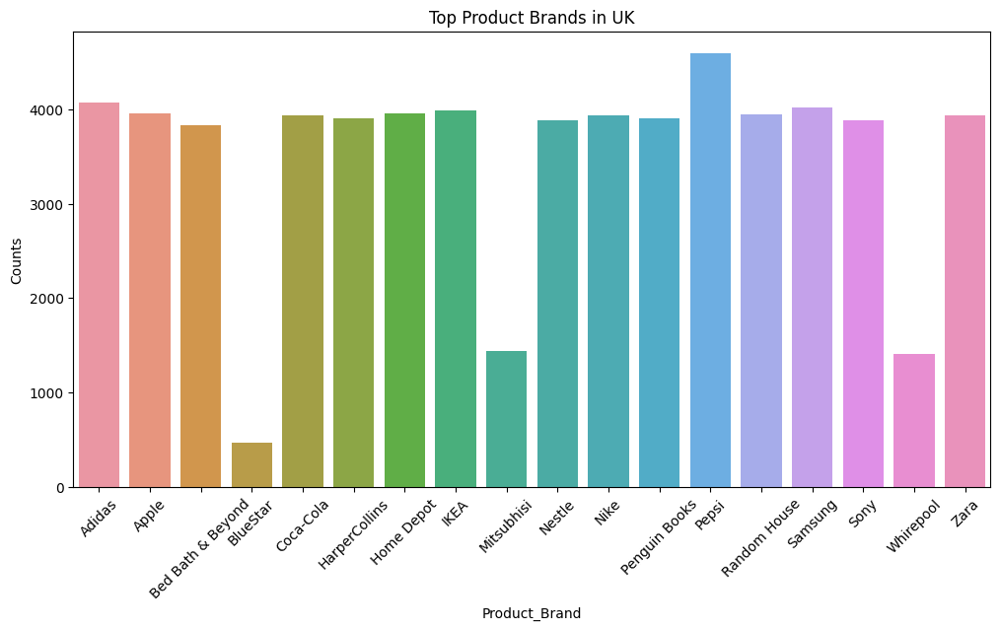

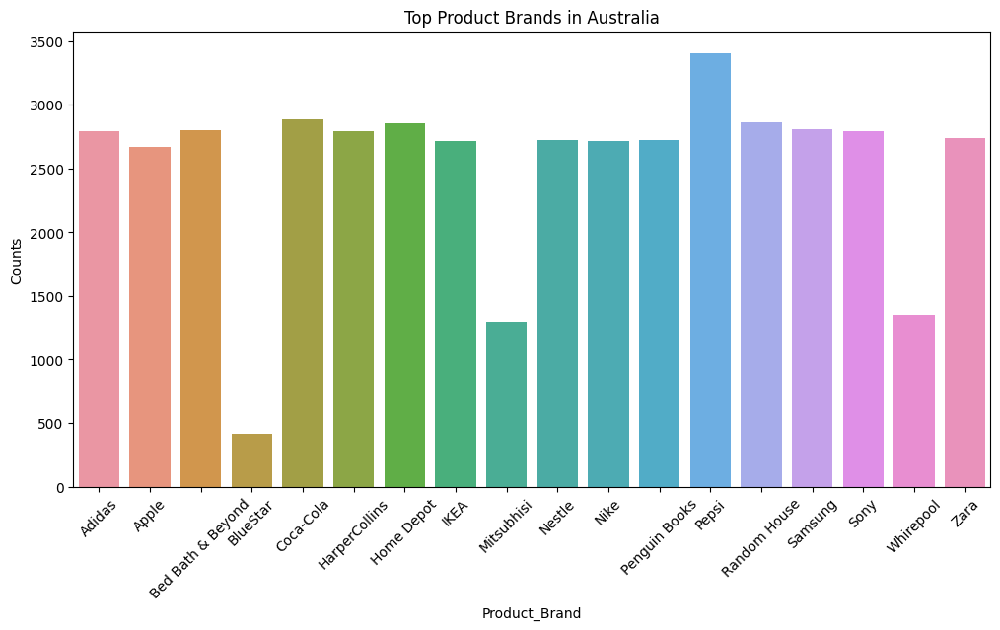

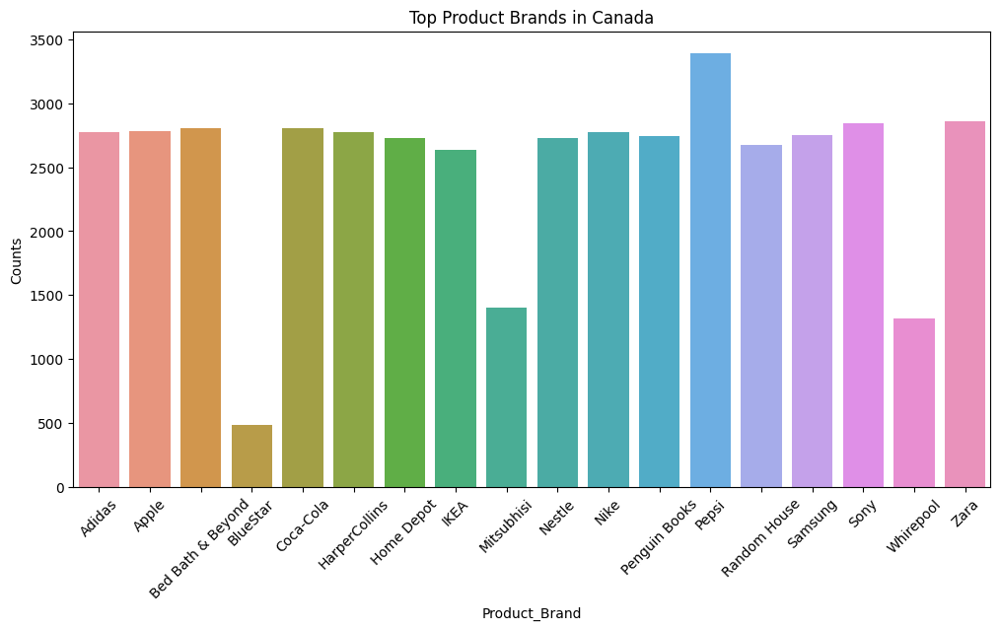

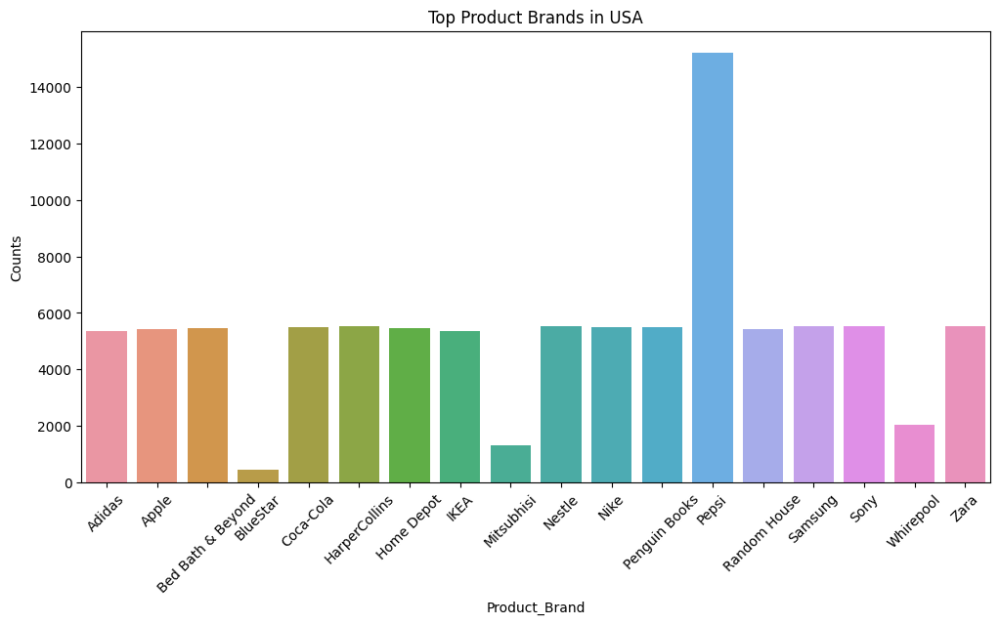

In [101]:
for country in countries:
    plt.figure(figsize=(12, 6))
    sns.barplot(data=brand_counts[brand_counts['Country'] == country], x='Product_Brand', y='Counts')
    plt.title(f'Top Product Brands in {country}')
    plt.xticks(rotation=45)
    plt.show()


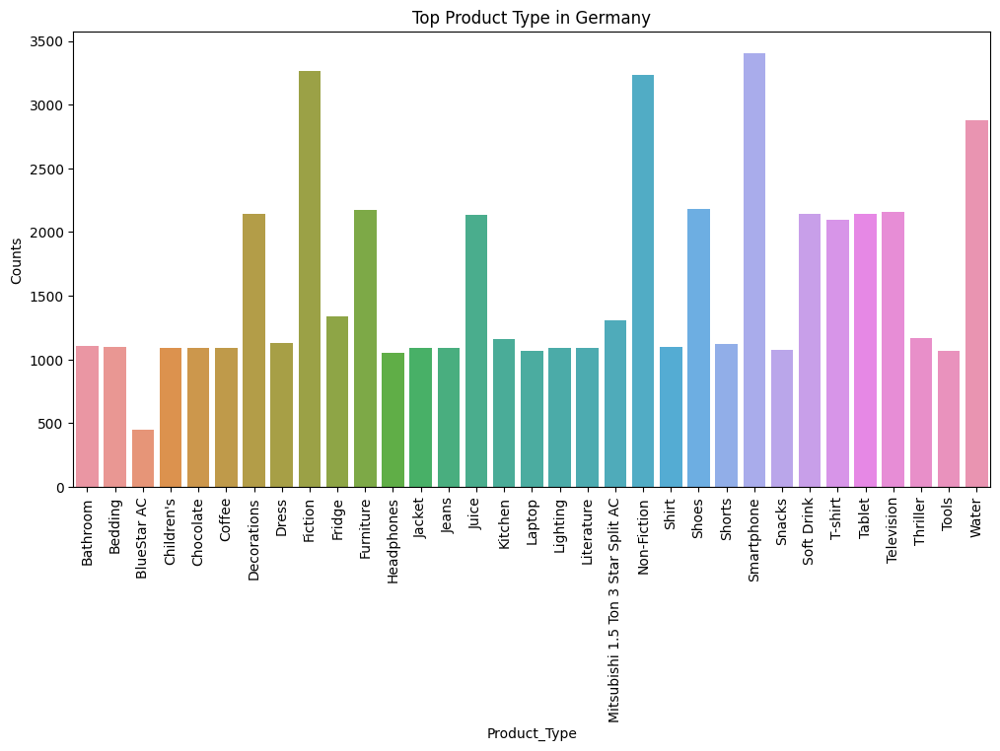

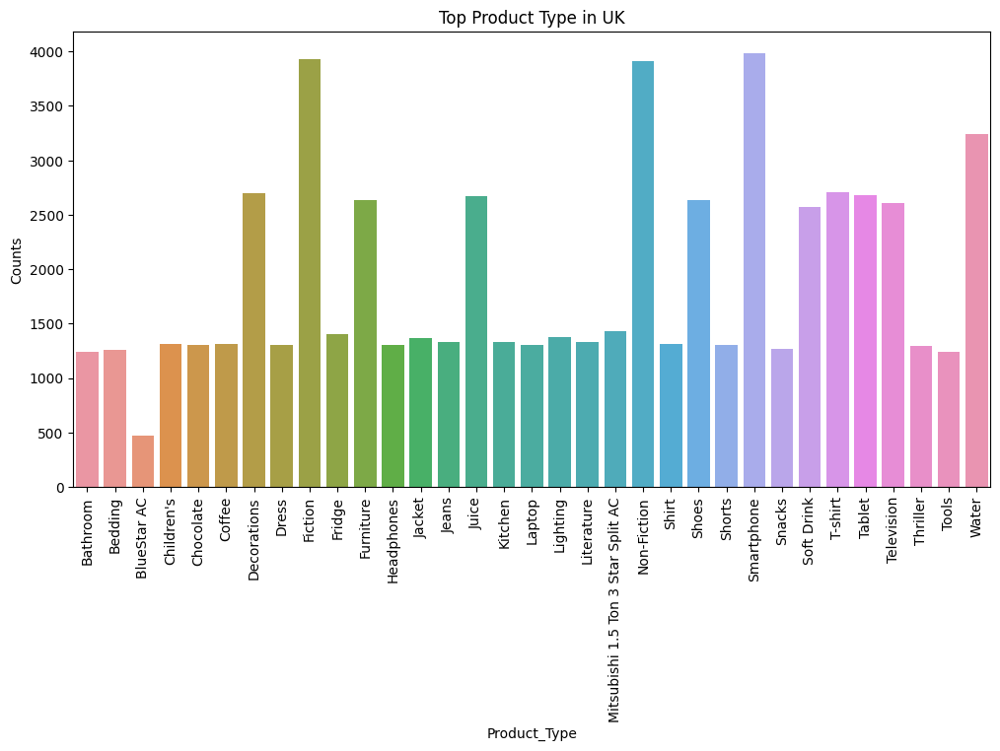

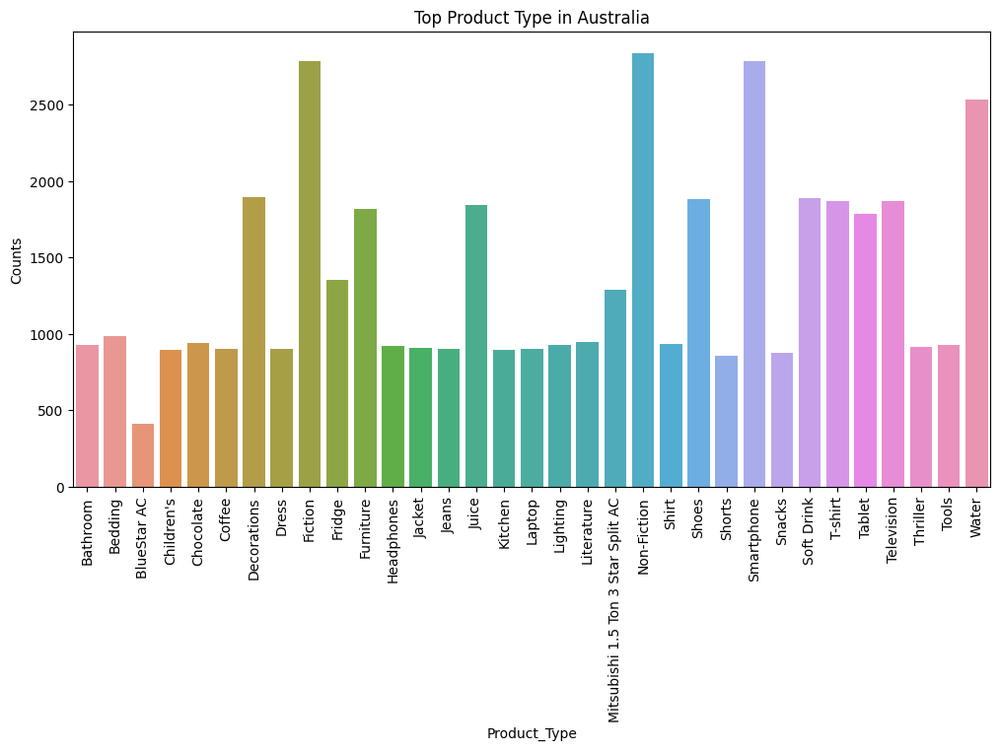

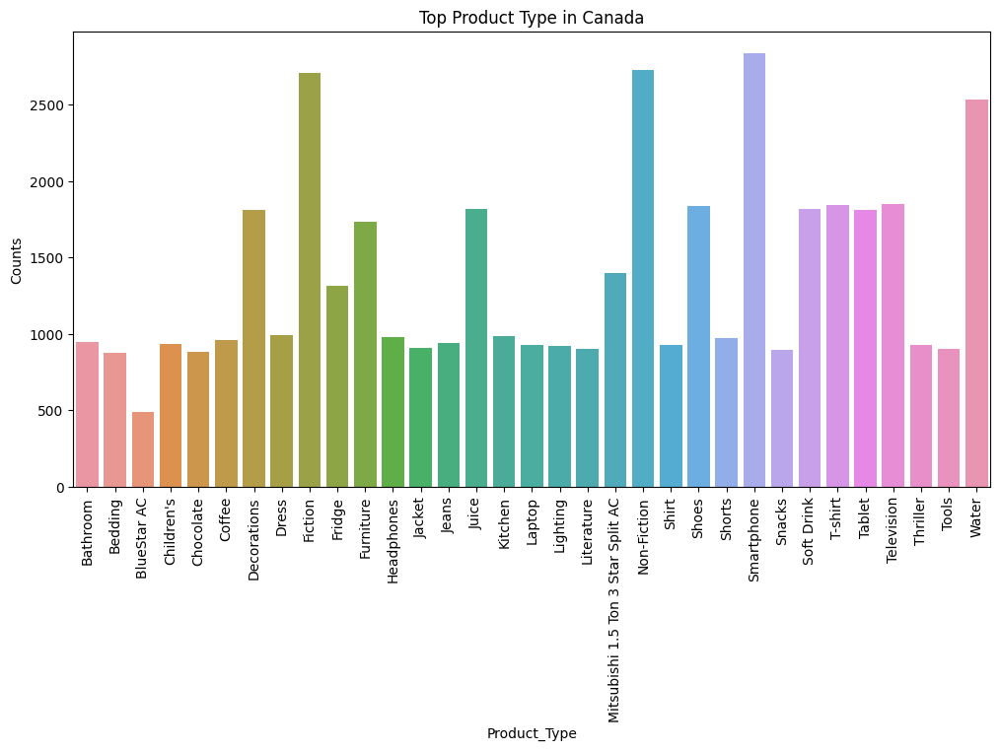

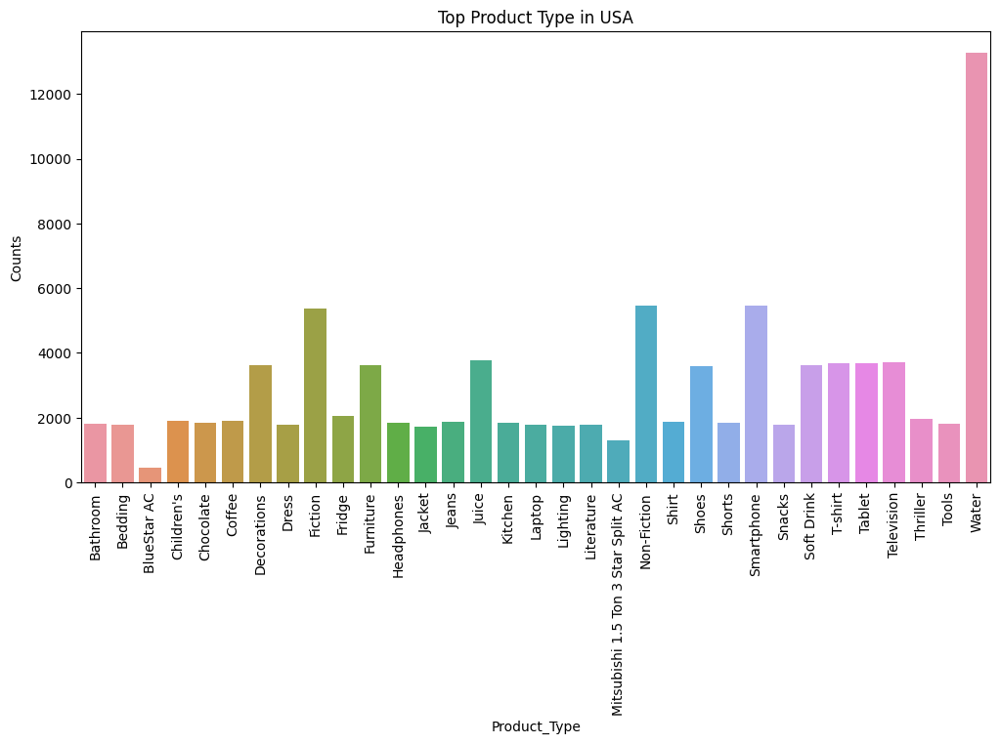

In [102]:
for country in countries:
    plt.figure(figsize=(12, 6))
    sns.barplot(data=type_counts[type_counts['Country'] == country], x='Product_Type', y='Counts')
    plt.title(f'Top Product Type in {country}')
    plt.xticks(rotation=90)
    plt.show()


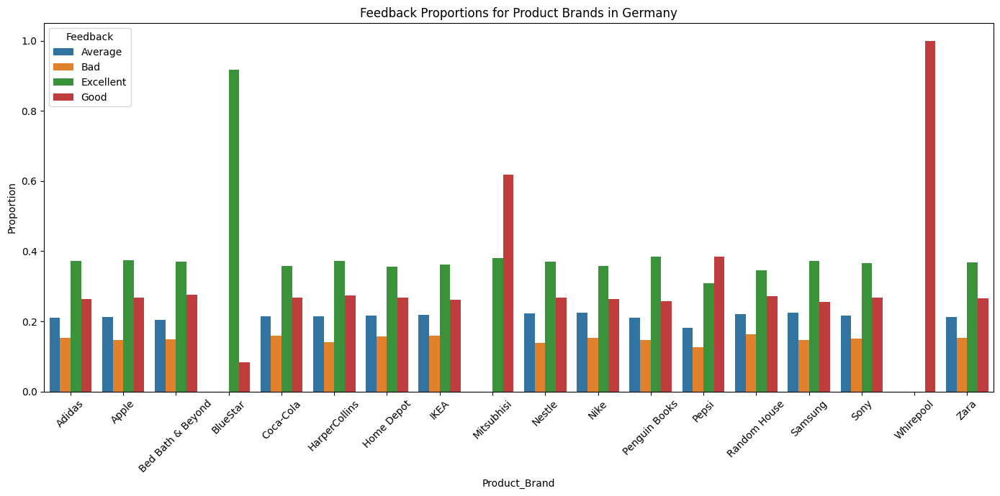

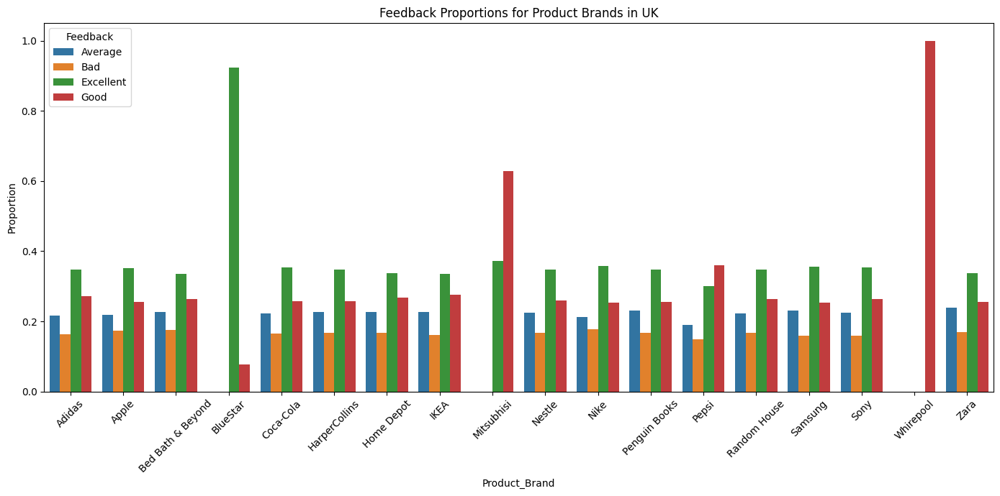

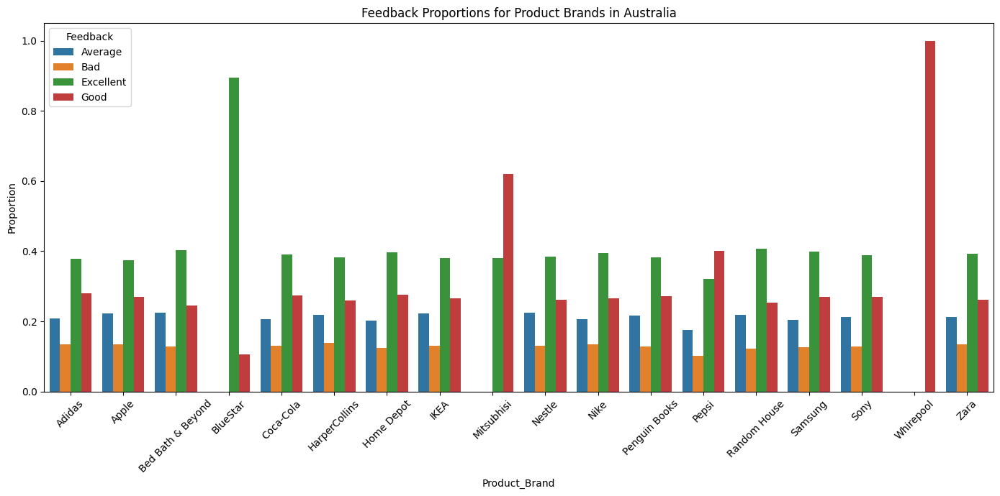

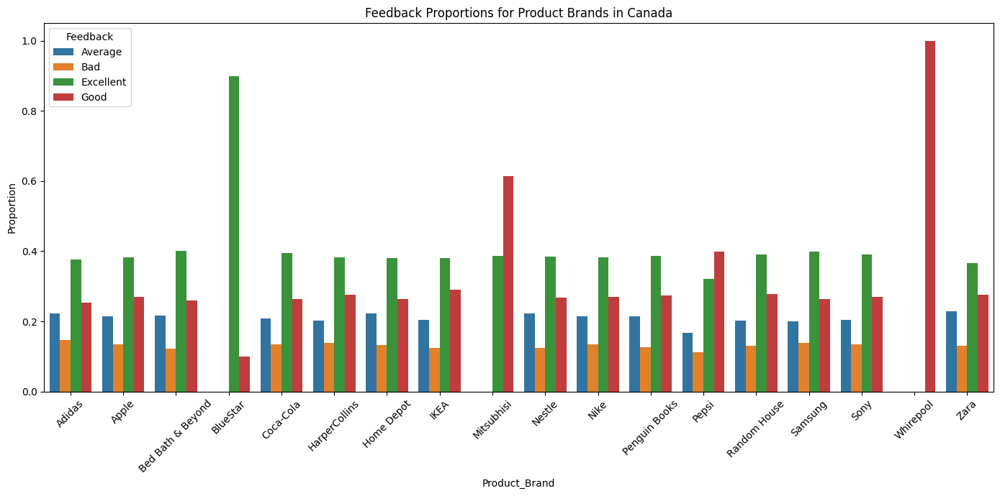

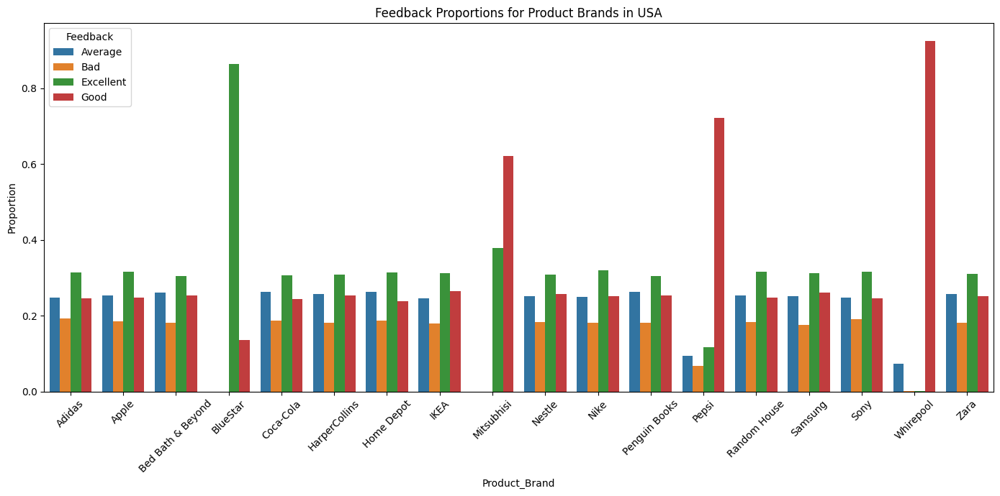

In [103]:
# Calculating proportions of feedback for each product brand by country
feedback_proportions = data.groupby(['Country', 'Product_Brand', 'Feedback']).size().reset_index(name='Count')
feedback_proportions['Proportion'] = feedback_proportions.groupby(['Country', 'Product_Brand'])['Count'].transform(lambda x: x / x.sum())

countries = data['Country'].unique()

for country in countries:
    plt.figure(figsize=(14, 7))
    sns.barplot(data=feedback_proportions[feedback_proportions['Country'] == country],
                x='Product_Brand', y='Proportion', hue='Feedback')
    plt.title(f'Feedback Proportions for Product Brands in {country}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


***Amount sales generated for Types, Brands and Categories for each country***

In [104]:
# Grouping by Country and Product_Brand, and calculate the sum of Total_Purchases and Total_Amount
brand_sales1 = data.groupby(['Country', 'Product_Brand']).agg({'Total_Purchases': 'sum', 'Total_Amount': 'sum'}).reset_index()

# Grouping by Country and Product_Category, and calculate the sum of Total_Purchases and Total_Amount
category_sales1 = data.groupby(['Country', 'Product_Category']).agg({'Total_Purchases': 'sum', 'Total_Amount': 'sum'}).reset_index()

# Grouping by Country and Product_Type, and calculate the sum of Total_Purchases and Total_Amount
type_sales1 = data.groupby(['Country', 'Product_Type']).agg({'Total_Purchases': 'sum', 'Total_Amount': 'sum'}).reset_index()


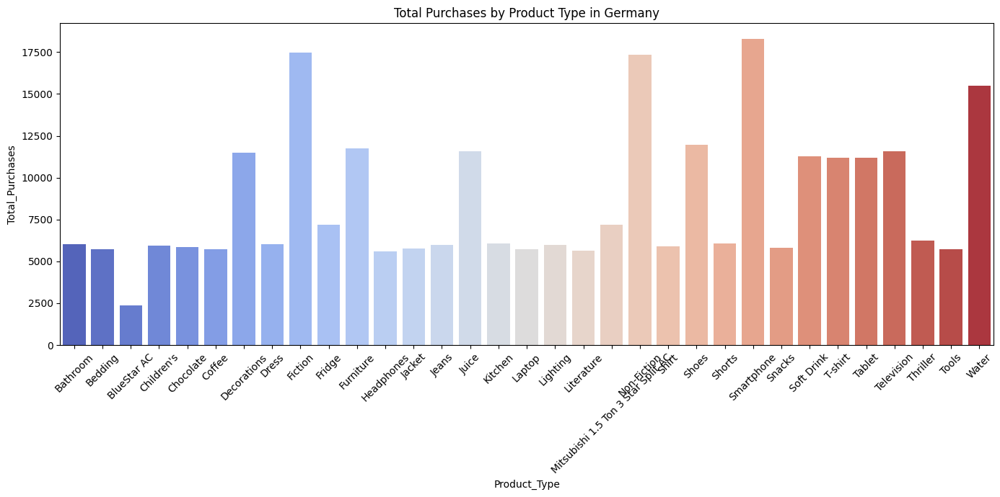

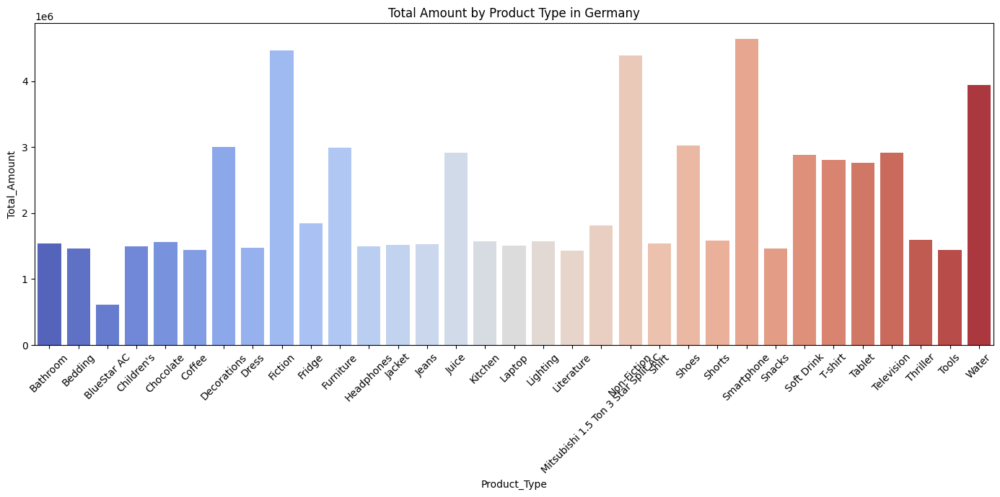

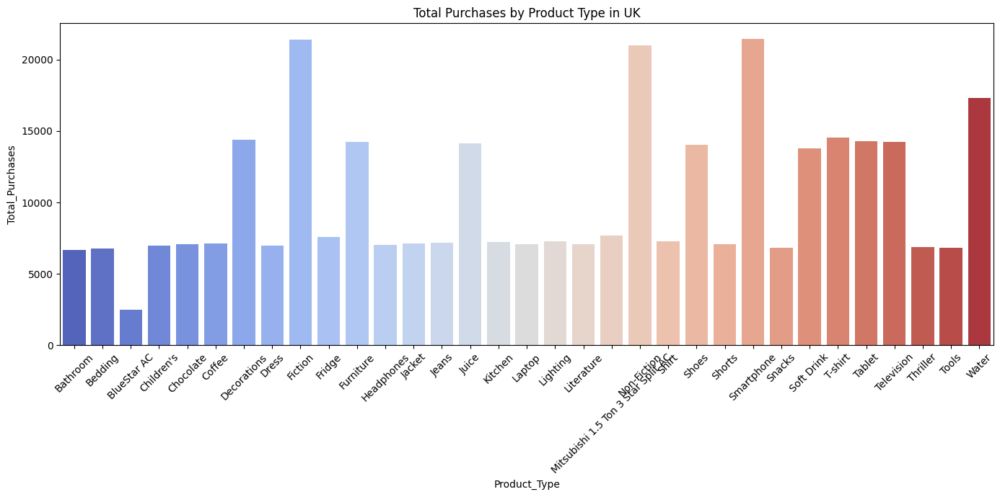

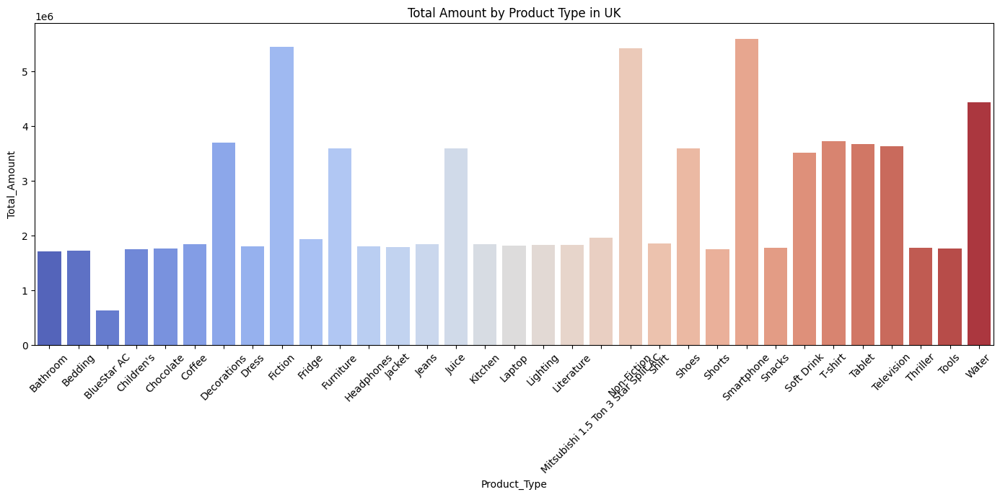

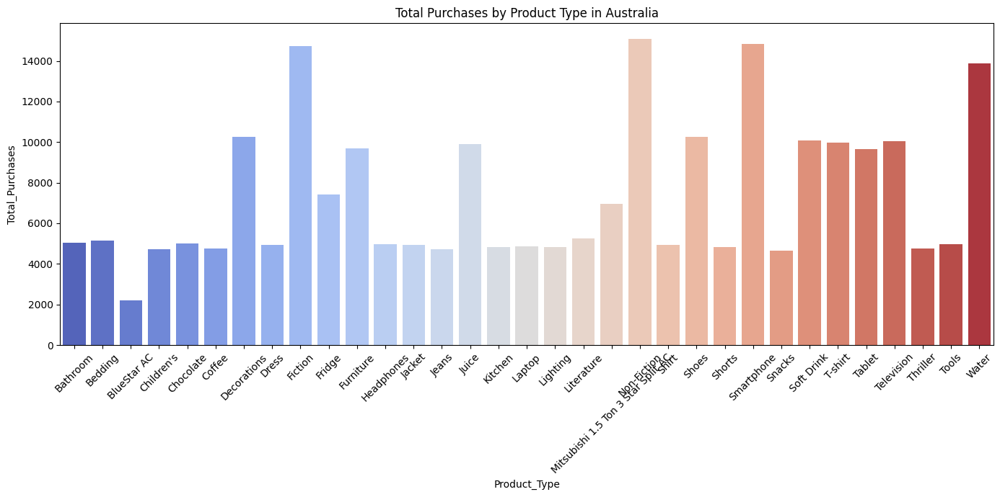

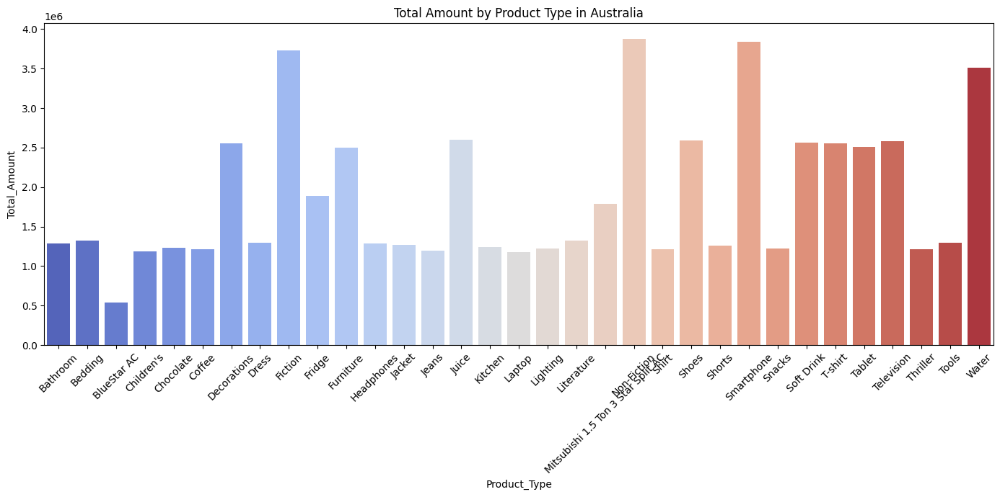

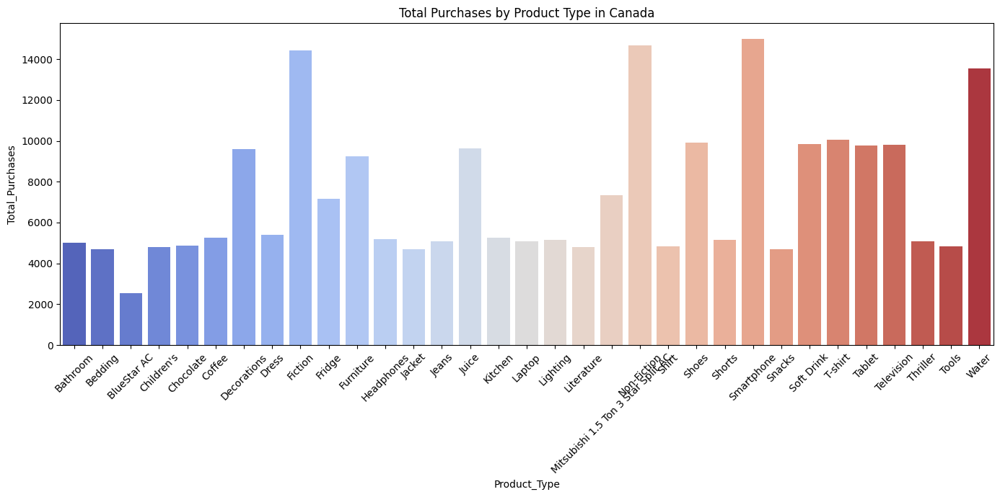

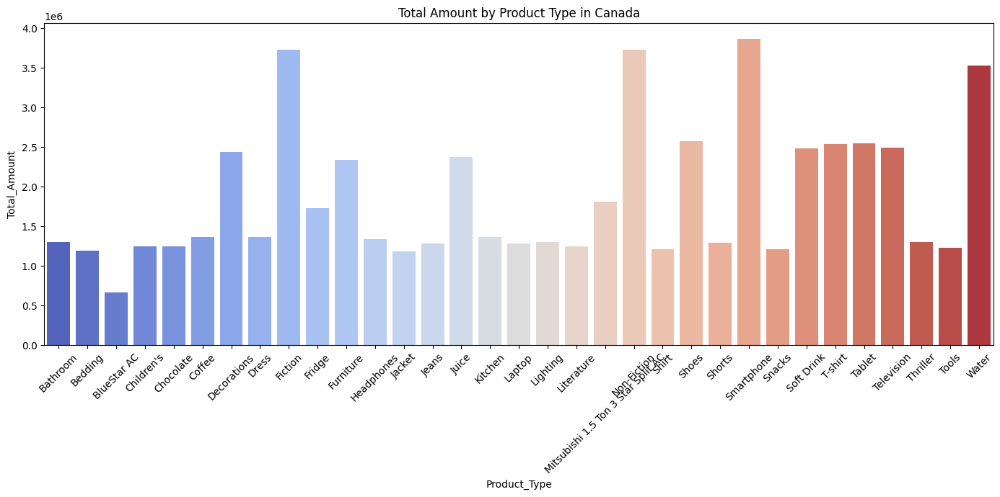

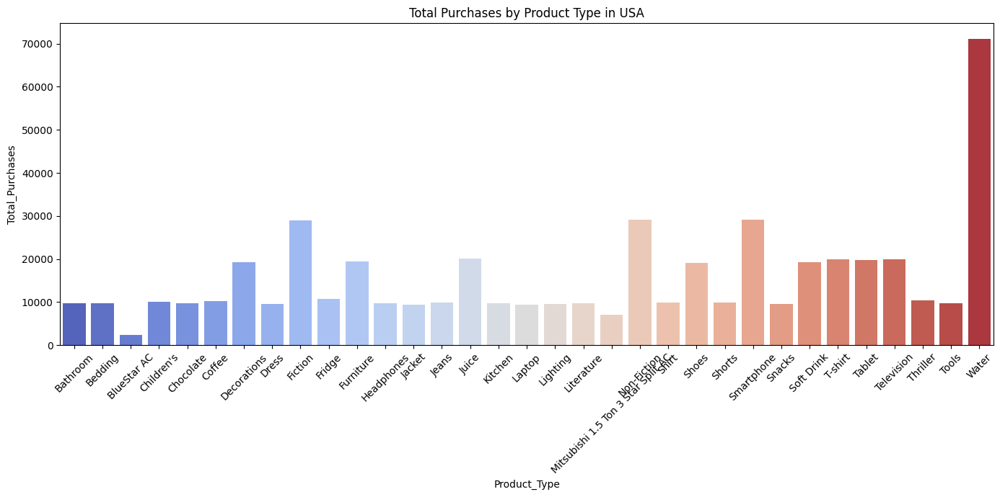

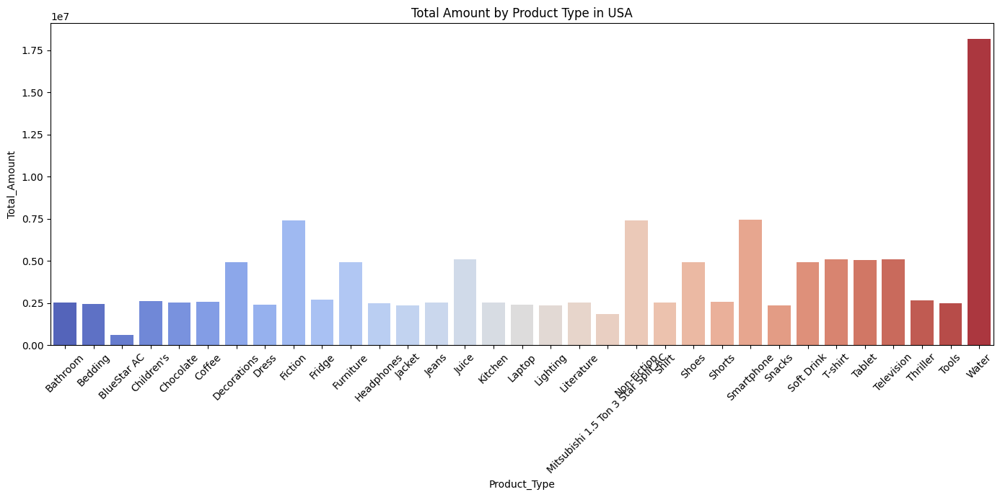

In [105]:
# Plot for Product Type
for country in countries:
    plt.figure(figsize=(14, 7))
    sns.barplot(data=type_sales1[type_sales1['Country'] == country], x='Product_Type', y='Total_Purchases', palette='coolwarm')
    plt.title(f'Total Purchases by Product Type in {country}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()
    
    plt.figure(figsize=(14, 7))
    sns.barplot(data=type_sales1[type_sales1['Country'] == country], x='Product_Type', y='Total_Amount', palette='coolwarm')
    plt.title(f'Total Amount by Product Type in {country}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


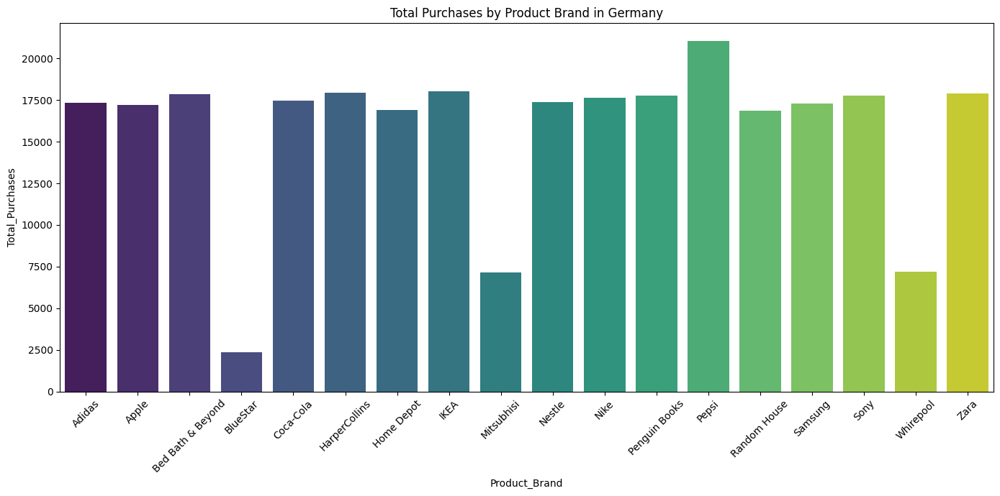

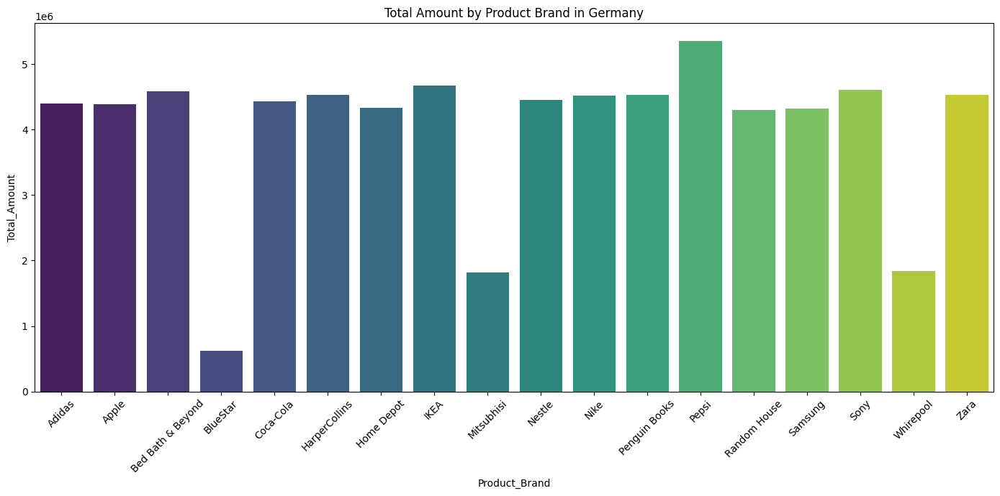

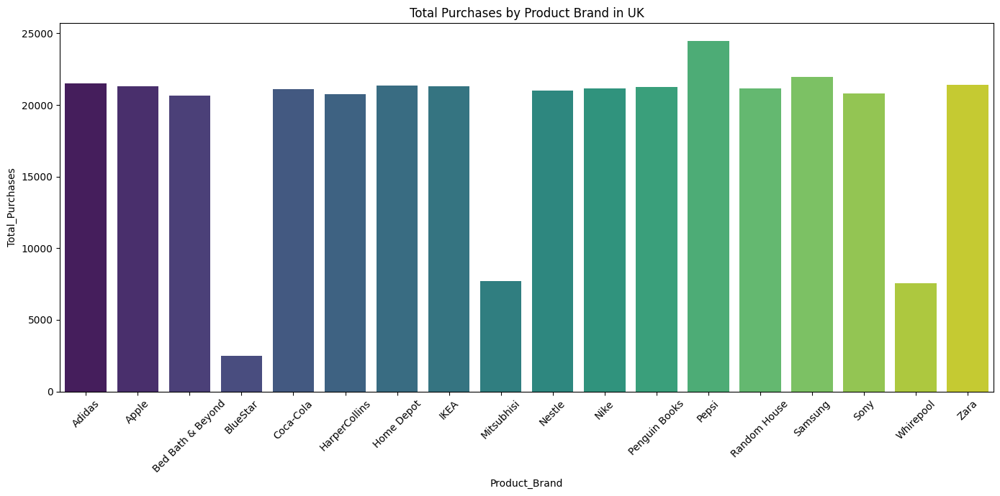

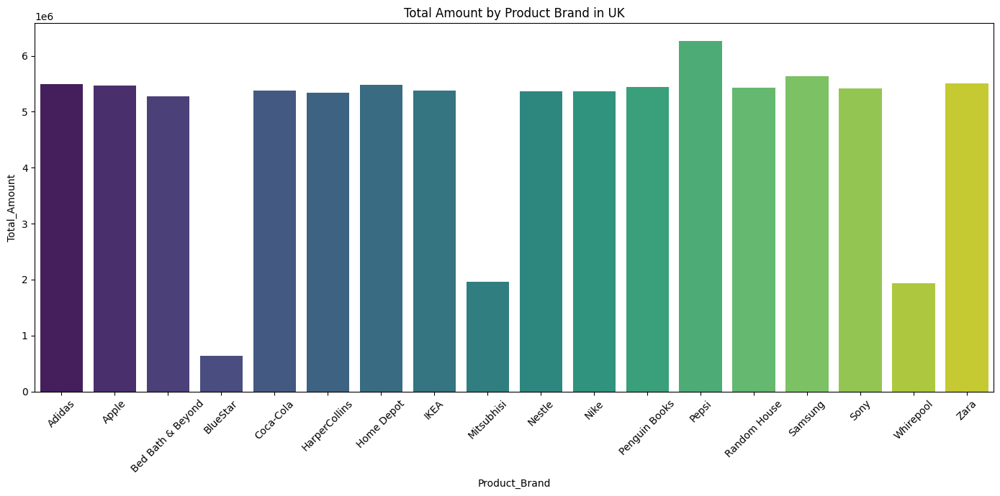

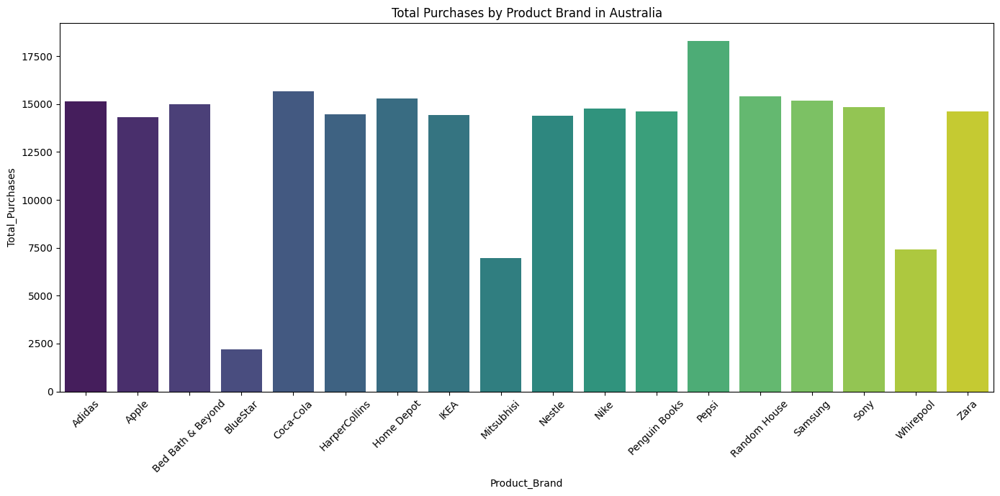

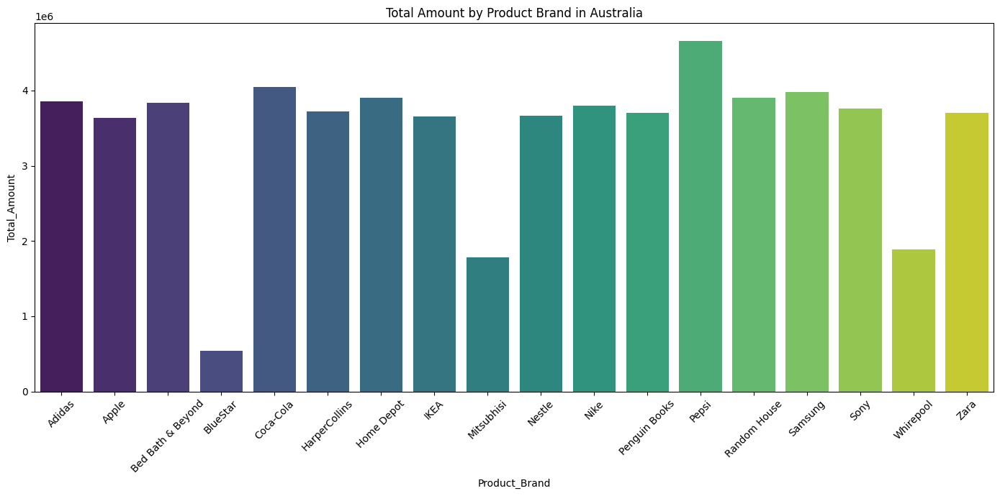

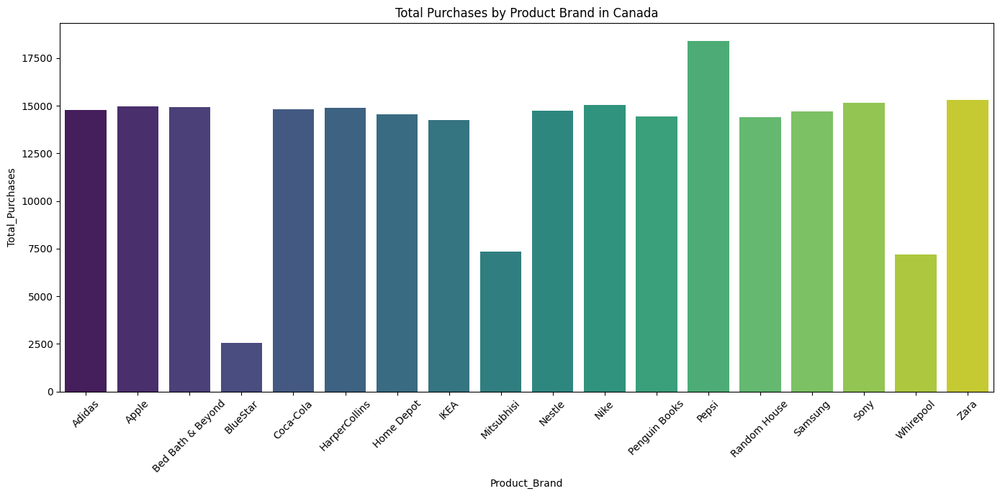

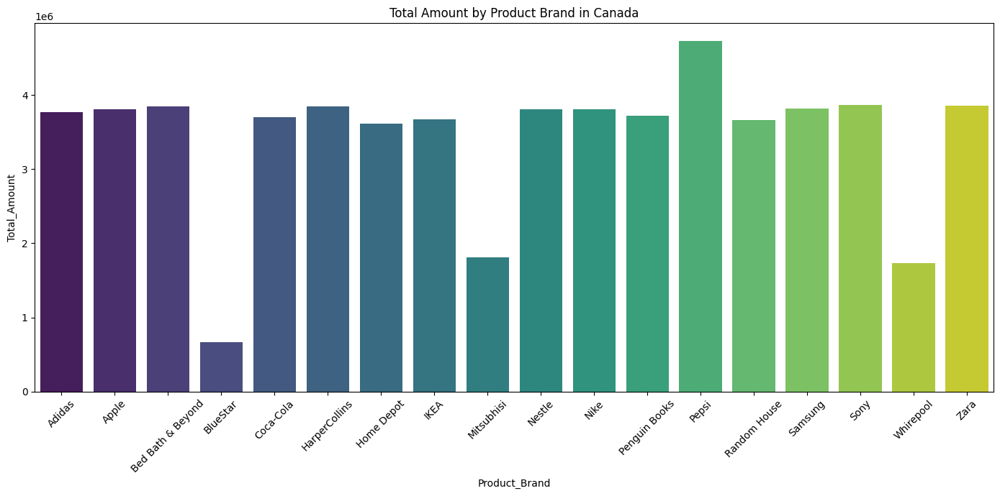

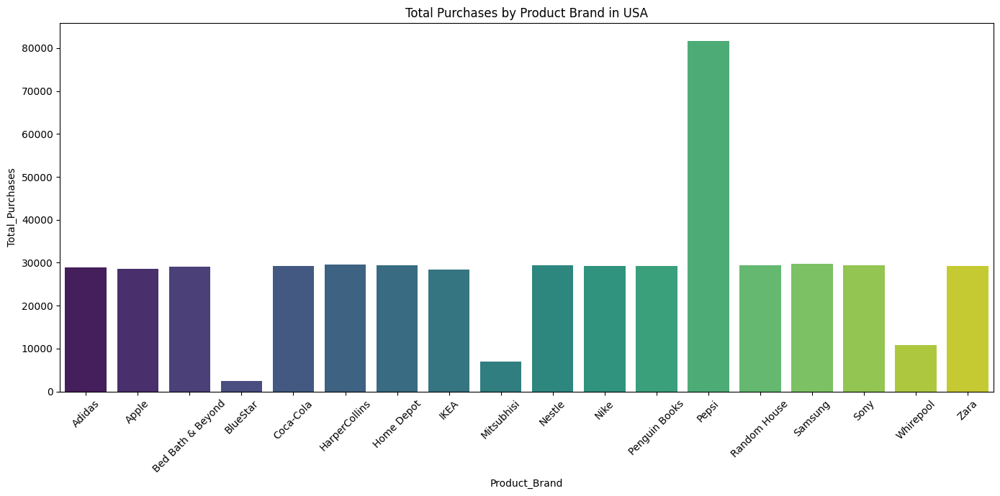

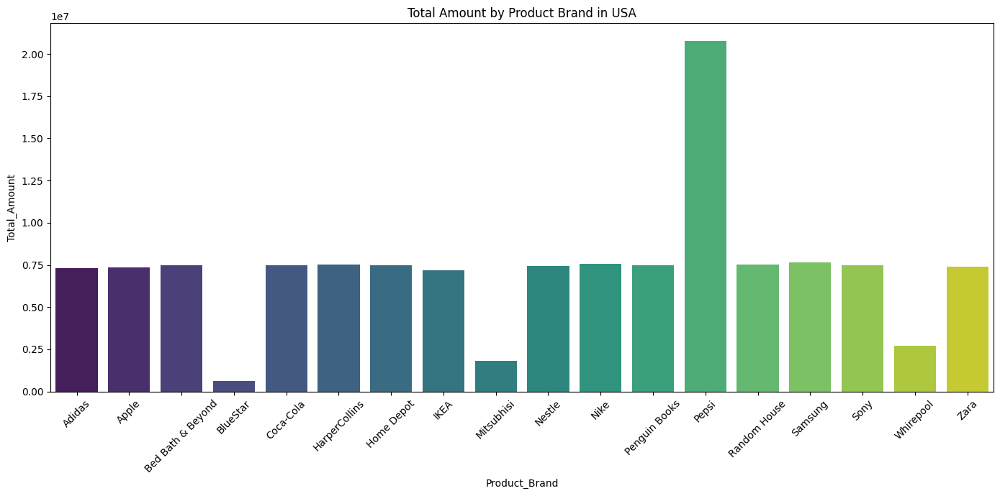

In [106]:
countries = data['Country'].unique()
for country in countries:
    plt.figure(figsize=(14, 7))
    sns.barplot(data=brand_sales1[brand_sales1['Country'] == country], x='Product_Brand', y='Total_Purchases', palette='viridis')
    plt.title(f'Total Purchases by Product Brand in {country}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()
    
    plt.figure(figsize=(14, 7))
    sns.barplot(data=brand_sales1[brand_sales1['Country'] == country], x='Product_Brand', y='Total_Amount', palette='viridis')
    plt.title(f'Total Amount by Product Brand in {country}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


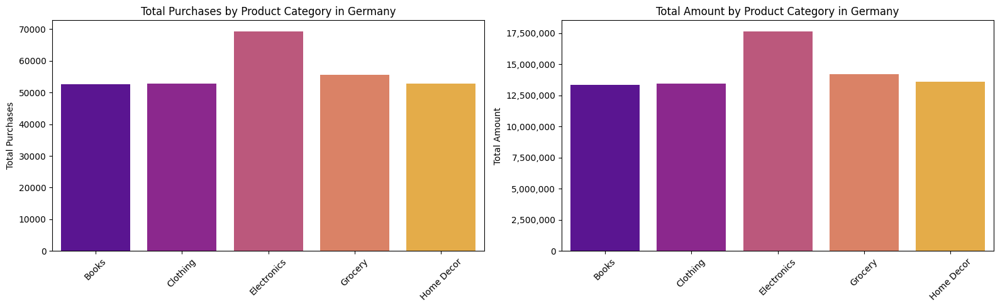

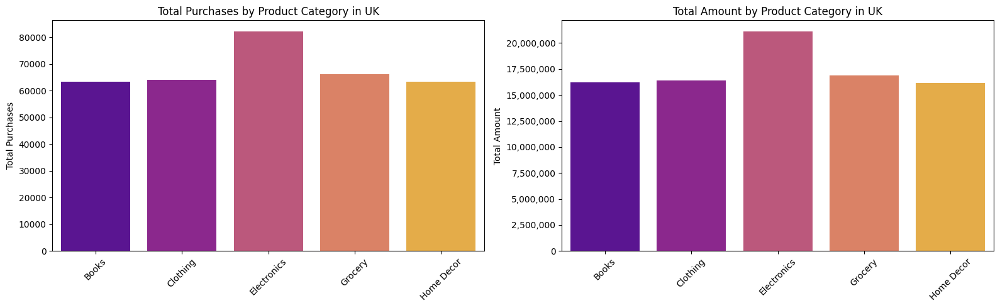

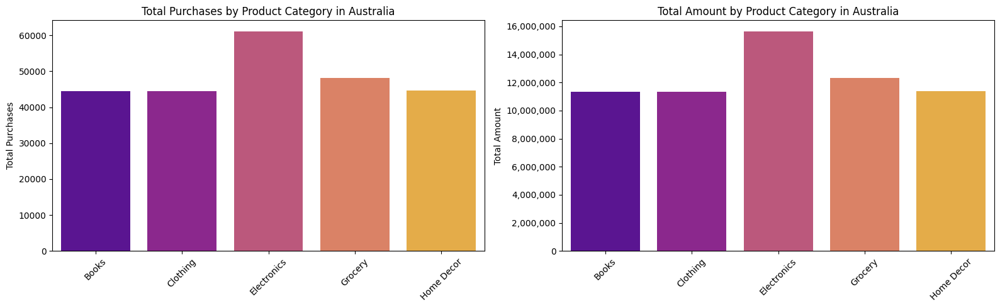

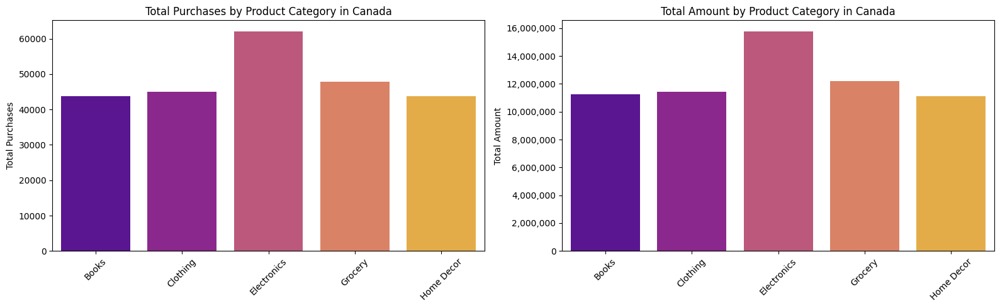

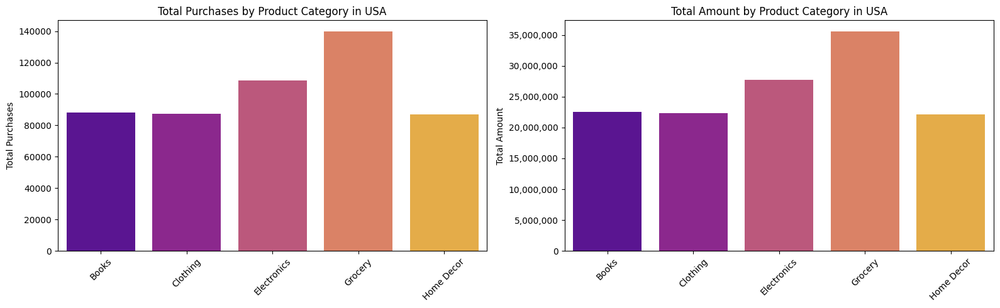

In [107]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.ticker as ticker

# Plot for Product Category
for country in countries:
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 5))  # Create a figure with two subplots in one row

    # Plot for Total Purchases
    sns.barplot(data=category_sales1[category_sales1['Country'] == country], x='Product_Category', y='Total_Purchases', palette='plasma', ax=axes[0])
    axes[0].set_title(f'Total Purchases by Product Category in {country}')
    axes[0].tick_params(axis='x', rotation=45)
    axes[0].set_xlabel('')
    axes[0].set_ylabel('Total Purchases')

    # Plot for Total Amount
    sns.barplot(data=category_sales1[category_sales1['Country'] == country], x='Product_Category', y='Total_Amount', palette='plasma', ax=axes[1])
    axes[1].set_title(f'Total Amount by Product Category in {country}')
    axes[1].tick_params(axis='x', rotation=45)
    axes[1].set_xlabel('')
    axes[1].set_ylabel('Total Amount')
    axes[1].yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))  # Format y-axis with commas

    plt.tight_layout()
    plt.show()


In [108]:
# Getting unique countries
countries = data['Country'].unique()

# For each country, printing all unique states
for country in countries:
    states = data[data['Country'] == country]['State'].unique()
    print(f"\n{country}:")
    for state in sorted(states):
        print(f"  - {state}")


Germany:
  - Berlin
  - England

UK:
  - England

Australia:
  - England
  - New South Wales

Canada:
  - England
  - Ontario

USA:
  - Alabama
  - Alaska
  - Arizona
  - Arkansas
  - Berlin
  - California
  - Colorado
  - Connecticut
  - Delaware
  - England
  - Florida
  - Georgia
  - Hawaii
  - Idaho
  - Illinois
  - Indiana
  - Iowa
  - Kansas
  - Kentucky
  - Louisiana
  - Maine
  - Maryland
  - Massachusetts
  - Michigan
  - Minnesota
  - Mississippi
  - Missouri
  - Montana
  - Nebraska
  - Nevada
  - New Hampshire
  - New Jersey
  - New Mexico
  - New South Wales
  - New York
  - North Carolina
  - North Dakota
  - Ohio
  - Oklahoma
  - Ontario
  - Oregon
  - Pennsylvania
  - Rhode Island
  - South Carolina
  - South Dakota
  - Tennessee
  - Texas
  - Utah
  - Vermont
  - Virginia
  - Washington
  - West Virginia
  - Wisconsin
  - Wyoming


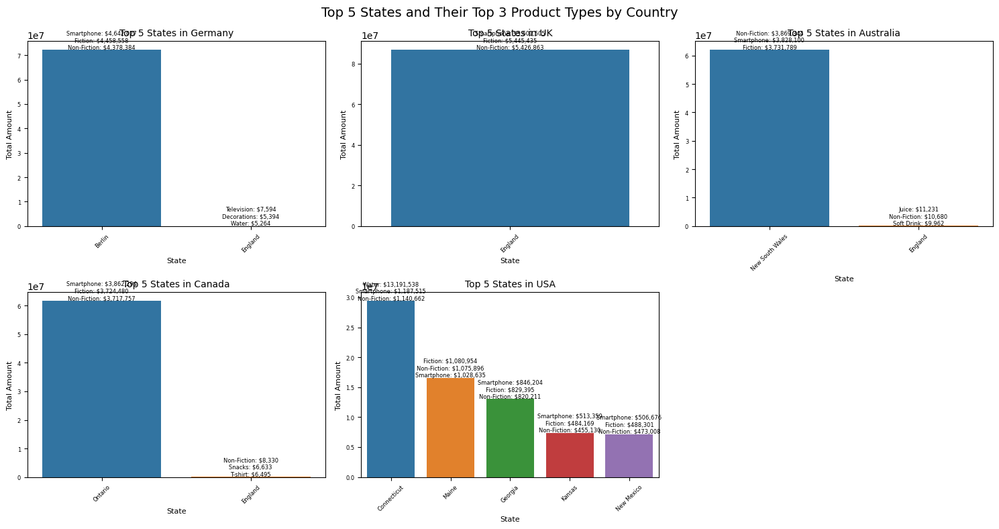

In [109]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_top_states_and_products(data, country, ax):
    top_states = data[data['Country'] == country].groupby('State')['Total_Amount'].sum().nlargest(5)
    
    sns.barplot(x=top_states.index, y=top_states.values, ax=ax)
    ax.set_title(f'Top 5 States in {country}', fontsize=10)
    ax.set_xlabel('State', fontsize=8)
    ax.set_ylabel('Total Amount', fontsize=8)
    ax.tick_params(axis='x', rotation=45, labelsize=6)
    ax.tick_params(axis='y', labelsize=6)
    
    for i, state in enumerate(top_states.index):
        state_data = data[(data['Country'] == country) & (data['State'] == state)]
        top_products = state_data.groupby('Product_Type')['Total_Amount'].sum().nlargest(3)
        product_text = '\n'.join([f"{p}: ${v:,.0f}" for p, v in top_products.items()])
        ax.text(i, top_states[state], product_text, ha='center', va='bottom', fontsize=6)

countries = data['Country'].unique()

n_cols = min(3, len(countries))
n_rows = (len(countries) - 1) // n_cols + 1

fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 4*n_rows))
fig.suptitle('Top 5 States and Their Top 3 Product Types by Country', fontsize=14)

for i, country in enumerate(countries):
    row = i // n_cols
    col = i % n_cols
    ax = axes[row, col] if n_rows > 1 else axes[col]
    plot_top_states_and_products(data, country, ax)

# Removing any unused subplots
for i in range(len(countries), n_rows * n_cols):
    row = i // n_cols
    col = i % n_cols
    fig.delaxes(axes[row, col] if n_rows > 1 else axes[col])

plt.tight_layout()
plt.show()

In [110]:
import plotly.graph_objects as go

# Grouping the data by country, month, and product category, and sum the total amount
country_month_category_amount = data.groupby(['Country', 'Month', 'Product_Category'])['Total_Amount'].sum().reset_index()

# Pivot the DataFrame to have country as rows, month as columns, and total amount as values
pivot_table = country_month_category_amount.pivot_table(index='Country', columns='Month', values='Total_Amount', aggfunc='sum')


fig = go.Figure(data=go.Heatmap(
    z=pivot_table.values,
    x=pivot_table.columns,
    y=pivot_table.index,
    colorscale='YlOrRd',  # Changed colorscale to Yellow-Orange-Red
    colorbar=dict(title='Total Amount'),  # Added colorbar title
    hovertemplate='%{y}: %{x}<br>Total Amount: %{z:.2f}',  # Custom hovertemplate
))


fig.update_layout(
    title='Total Amount Generated per Month and Product Category',
    xaxis_title='Month',
    yaxis_title='Country',
    yaxis_autorange='reversed',  # Reverse y-axis for better readability
    width=1200,
    height=800,
    font=dict(size=12),  # Adjust font size
    margin=dict(l=120, r=50, t=100, b=50),  # Add margins for better spacing
)

fig.show()

In [111]:
country_month_category_amount = data.groupby(['Country', 'Month', 'Product_Category'])['Total_Amount'].sum().reset_index()

# Pivot the DataFrame to have country and product category as rows, month as columns, and total amount as values
pivot_table = country_month_category_amount.pivot_table(index=['Country', 'Product_Category'], columns='Month', values='Total_Amount', aggfunc='sum')

# Concatenate country and product category names for y-axis labels
y_labels = [f"{country} - {category}" for country, category in pivot_table.index]


fig = go.Figure(data=go.Heatmap(
    z=pivot_table.values,
    x=pivot_table.columns,
    y=y_labels,
    colorscale='YlGnBu',  # Changed colorscale to Yellow-Green-Blue
    hovertemplate='%{y}<br>%{x}: %{z:.2f}',  # Custom hovertemplate
    colorbar=dict(title='Total Amount'),  # Added colorbar title
))


fig.update_layout(
    title='Total Amount Generated per Month, Country, and Product Category',
    xaxis_title='Month',
    yaxis_title='Country - Product Category',
    width=1500,
    height=700,
    yaxis=dict(tickmode='linear'),  # Ensure y-axis labels display all categories
)

fig.show()

In [112]:
fig = px.sunburst(
    data,
    path=['Customer_Segment', 'Product_Category', 'Gender'],
    values='Total_Amount',
    color='Total_Amount',
    color_continuous_scale='RdBu',
    title='Customer Segments, Product Categories, and Gender-wise Spending',
    hover_data={'Total_Amount': ':,.2f'}
)

fig.update_layout(
    margin=dict(t=50, l=0, r=0, b=0),
    coloraxis_colorbar=dict(
        title='Total Amount',
        tickformat=',.2f'
    )
)

fig.show()


In [113]:
fig = px.treemap(
    data,
    path=['Customer_Segment', 'Product_Category', 'Order_Status'],
    values='Total_Amount',
    color='Total_Amount',
    color_continuous_scale='Viridis',
    title='Customer Segments, Product Categories, and Order Status-wise Spending',
    hover_data={'Total_Amount': ':,.2f'}
)


fig.update_layout(
    margin=dict(t=50, l=0, r=0, b=0),
    coloraxis_colorbar=dict(
        title='Total Amount',
        tickformat=',.2f'
    )
)

fig.show()
